## CIS 580, Machine Perception, Fall 2024



### Homework 5
#### Due: December 23 2024, 11:59pm ET

Instructions: Create a folder in your Google Drive and place inside this .ipynb file. Open the jupyter notebook with Google Colab. Refrain from using a GPU during implementing and testing the whole thing. You should switch to a GPU runtime only when performing the final training (of the 2D image or the NeRF) to avoid GPU usage runouts.

### Part 1: Fitting a 2D Image

In [1]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time
import gdown

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


We first download the image from the web. We normalize the image so the pixels are in between the range of [0,1].

In [4]:
url = "https://drive.google.com/file/d/1rD1aaxN8aSynZ8OPA7EI3G936IF0vcUt/view?usp=sharing"
gdown.download(url=url, output='starry_night.jpg', quiet=False, fuzzy=True)

# Load painting image
painting = imageio.imread("starry_night.jpg")
painting = torch.from_numpy(np.array(painting, dtype=np.float32)/255.).to(device)
height_painting, width_painting = painting.shape[:2]

Downloading...
From: https://drive.google.com/uc?id=1rD1aaxN8aSynZ8OPA7EI3G936IF0vcUt
To: c:\Users\prkri\Downloads\hw5\starry_night.jpg
100%|██████████| 5.65k/5.65k [00:00<?, ?B/s]


1.1 Complete the function positional_encoding()

In [5]:
def positional_encoding(x, num_frequencies=6, incl_input=True):

    """
    Apply positional encoding to the input.

    Args:
    x (torch.Tensor): Input tensor to be positionally encoded.
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor.
    """

    print(x)
    results = []
    if incl_input:
        results.append(x)

    #############################  TODO 1(a) BEGIN  ############################

    for j in range(num_frequencies):
        # for i in x:
        results.append( torch.sin((2 ** j) * np.pi * x ))
        results.append( torch.cos((2 ** j) * np.pi * x ))


    # encode input tensor and append the encoded tensor to the list of results.
    # frequencies = 2.0 ** torch.arange(num_frequencies, dtype=x.dtype, device=x.device)
    # for i in frequencies:
    #     results.append(torch.sin(i * np.pi* x))
    #     results.append(torch.cos(i * np.pi* x))



    #############################  TODO 1(a) END  ##############################
    return torch.cat(results, dim=-1)

1.2 Complete the class model_2d() that will be used to fit the 2D image.


In [6]:
class model_2d(nn.Module):

    """
    Define a 2D model comprising of three fully connected layers,
    two relu activations and one sigmoid activation.
    """

    def __init__(self, filter_size=128, num_frequencies=6):
        super().__init__()
        #############################  TODO 1(b) BEGIN  ############################
        # for autograder compliance, please follow the given naming for your layers
        input_channels = 2
        self.layers = nn.Sequential(
            nn.Linear(input_channels * (2 * num_frequencies + 1) , filter_size),
            nn.ReLU(),
            nn.Linear(filter_size, filter_size),
            nn.ReLU(),
            nn.Linear(filter_size, 3),
            nn.Sigmoid()
        )


        #############################  TODO 1(b) END  ##############################

    def forward(self, x):
        #############################  TODO 1(b) BEGIN  ############################
        # example of forward through a layer: y = self.layer_in(x)

        x = self.layers(x)
        #############################  TODO 1(b) END  ##############################
        return x

In [7]:
def normalize_coord(height, width, num_frequencies=6):

    """
    Creates the 2D normalized coordinates, and applies positional encoding to them

    Args:
    height (int): Height of the image
    width (int): Width of the image
    num_frequencies (optional, int): The number of frequencies used in
      the positional encoding (default: 6).

    Returns:
    (torch.Tensor): Returns the 2D normalized coordinates after applying positional encoding to them.
    """

    #############################  TODO 1(c) BEGIN  ############################
    # Create the 2D normalized coordinates, and apply positional encoding to them

    h = torch.linspace(0, 1, height)
    w = torch.linspace(0, 1, width)
    y, x = torch.meshgrid(h, w, indexing= 'xy')
    print(x.shape) # h x w
    print(y.shape) # h x w

    # Step 2: Normalize coordinates to range [0, 1]
    # x_coords = (x / (width - 1))
    # y_coords = (y / (height - 1))


    vector_2d = torch.stack([x, y], dim = -1) # dimensions (h,w,2)
    vector_2d = vector_2d.view(-1,2) # flattens the grid to (h x w , 2)

    embedded_coordinates = positional_encoding(vector_2d, num_frequencies= num_frequencies)

    # points = torch.stack(torch.meshgrid(torch.linspace(0, 1, width), torch.linspace(0, 1, height)), dim=-1).reshape(-1, 2)
    # embedded_coordinates = positional_encoding(points, num_frequencies=num_frequencies)

    #############################  TODO 1(c) END  ############################

    return embedded_coordinates

You need to complete 1.1 and 1.2 first before completing the train_2d_model function. Don't forget to transfer the completed functions from 1.1 and 1.2 to the part1.py file and upload it to the autograder.

Fill the gaps in the train_2d_model() function to train the model to fit the 2D image.

In [8]:
import torch.optim as optim
def train_2d_model(test_img, num_frequencies, device, model=model_2d, positional_encoding=positional_encoding, show=True):

    # Optimizer parameters
    lr = 5e-4
    iterations = 10000
    height, width = test_img.shape[:2]

    # Number of iters after which stats are displayed
    display = 2000

    # Define the model and initialize its weights.
    model2d = model(num_frequencies=num_frequencies)
    model2d.to(device)

    def weights_init(m):
        if isinstance(m, nn.Linear):
            torch.nn.init.xavier_uniform_(m.weight)

    model2d.apply(weights_init)

    #############################  TODO 1(c) BEGIN  ############################
    # Define the optimizer
    optimizer = optim.Adam(model2d.parameters(), lr=lr)
    loss_fn = nn.MSELoss()
    #############################  TODO 1(c) END  ############################

    # Seed RNG, for repeatability
    seed = 5670
    torch.manual_seed(seed)
    np.random.seed(seed)

    # Lists to log metrics etc.
    psnrs = []
    iternums = []

    t = time.time()
    t0 = time.time()

    #############################  TODO 1(c) BEGIN  ############################
    
    # Create the 2D normalized coordinates, and apply positional encoding to them
    normalized_coords = normalize_coord(height, width, num_frequencies=num_frequencies).to(device)
    test_img_coords = test_img.permute(2, 0, 1).reshape(3, -1).permute(1, 0).to(device)

    #############################  TODO 1(c) END  ############################

    for i in range(iterations+1):
        optimizer.zero_grad()
        #############################  TODO 1(c) BEGIN  ############################
        # Run one iteration
        pred = model2d(normalized_coords)
        loss = loss_fn(model2d(normalized_coords), test_img_coords)
        loss.backward() # 
        optimizer.step()
        mse = loss.item()
        pred = pred.view(height, width, 3)
        # Compute mean-squared error between the predicted and target images. Backprop!



        #############################  TODO 1(c) END  ############################

        # Display images/plots/stats
        if i % display == 0 and show:
            #############################  TODO 1(c) BEGIN  ############################
            # Calculate psnr
            psnr = 10 * torch.log10(torch.tensor(1.0 / mse))

            #############################  TODO 1(c) END  ############################

            print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f" % psnr.item(), \
                "Time: %.2f secs per iter" % ((time.time() - t) / display), "%.2f secs in total" % (time.time() - t0))
            t = time.time()

            psnrs.append(psnr.item())
            iternums.append(i)

            plt.figure(figsize=(13, 4))
            plt.subplot(131)
            plt.imshow(pred.detach().cpu().numpy())
            plt.title(f"Iteration {i}")
            plt.subplot(132)
            plt.imshow(test_img.cpu().numpy())
            plt.title("Target image")
            plt.subplot(133)
            plt.plot(iternums, psnrs)
            plt.title("PSNR")
            plt.show()

    print('Done!')
    torch.save(model2d.state_dict(),'model_2d_' + str(num_frequencies) + 'freq.pt')
    plt.imsave('van_gogh_' + str(num_frequencies) + 'freq.png',pred.detach().cpu().numpy())
    return pred.detach().cpu()

Train the model to fit the given image without applying positional encoding to the input, and by applying positional encoding of two different frequencies to the input; L = 2 and L = 6.

torch.Size([133, 105])
torch.Size([133, 105])
tensor([[0.0000, 0.0000],
        [0.0000, 0.0096],
        [0.0000, 0.0192],
        ...,
        [1.0000, 0.9808],
        [1.0000, 0.9904],
        [1.0000, 1.0000]])
Iteration 0  Loss: 0.0452  PSNR: 13.45 Time: 0.00 secs per iter 0.36 secs in total


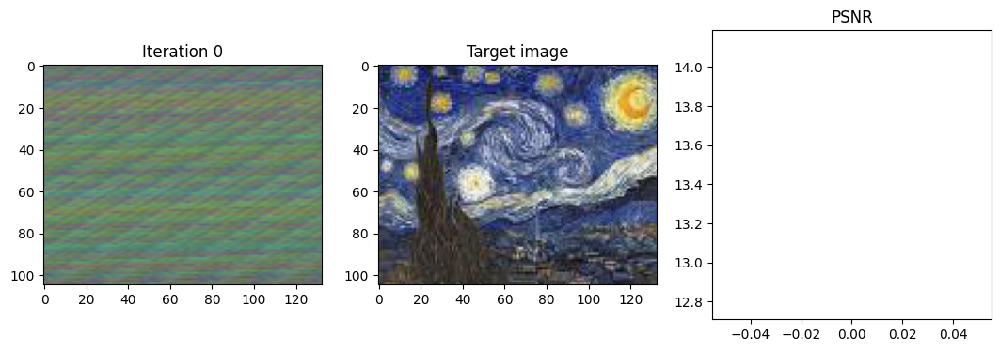

Iteration 2000  Loss: 0.0045  PSNR: 23.44 Time: 0.00 secs per iter 4.37 secs in total


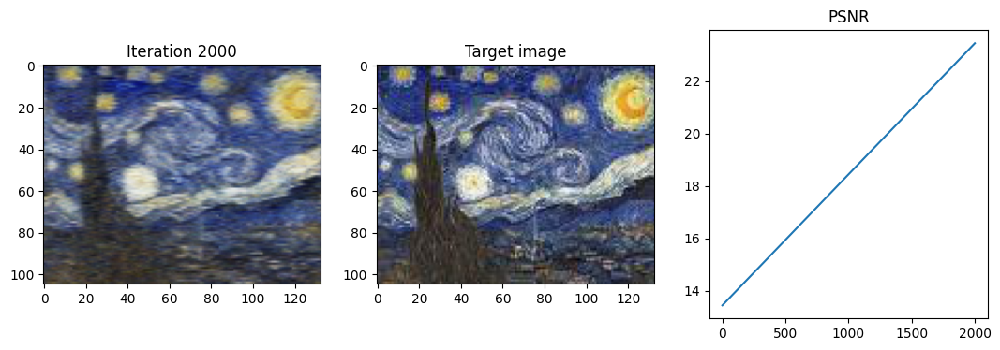

Iteration 4000  Loss: 0.0034  PSNR: 24.62 Time: 0.00 secs per iter 7.97 secs in total


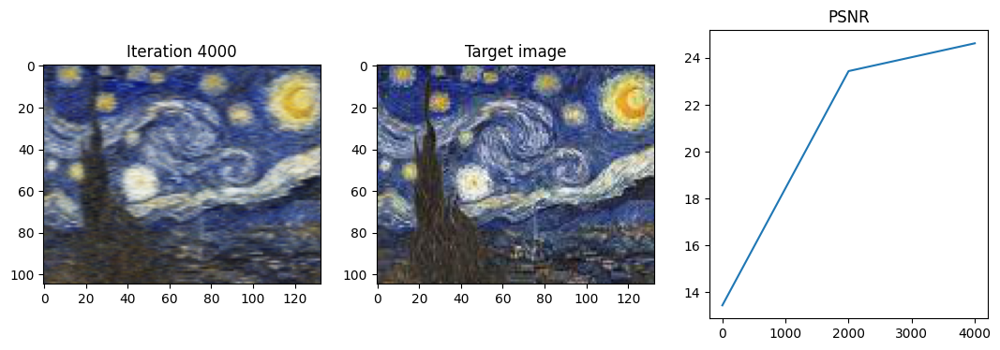

Iteration 6000  Loss: 0.0030  PSNR: 25.16 Time: 0.00 secs per iter 11.54 secs in total


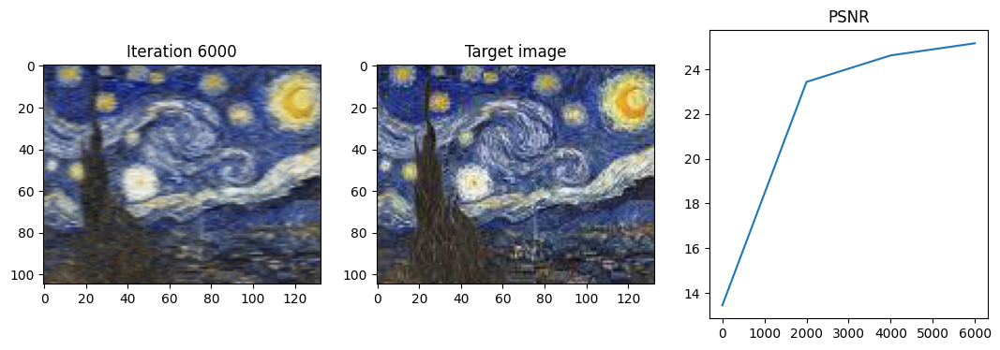

Iteration 8000  Loss: 0.0028  PSNR: 25.55 Time: 0.00 secs per iter 15.42 secs in total


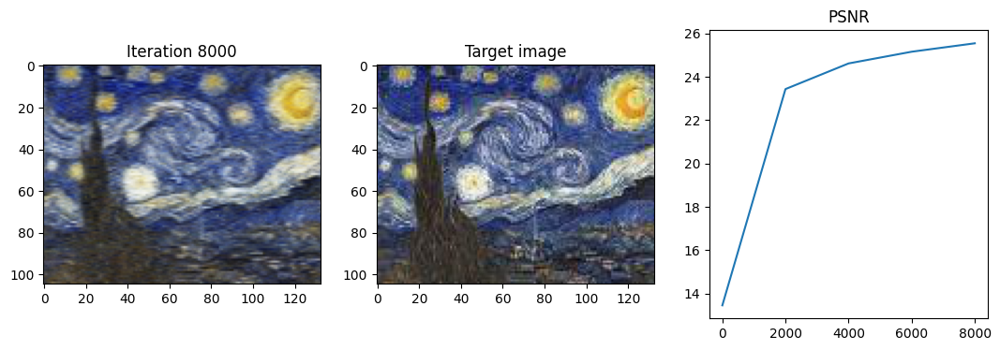

Iteration 10000  Loss: 0.0026  PSNR: 25.85 Time: 0.00 secs per iter 18.96 secs in total


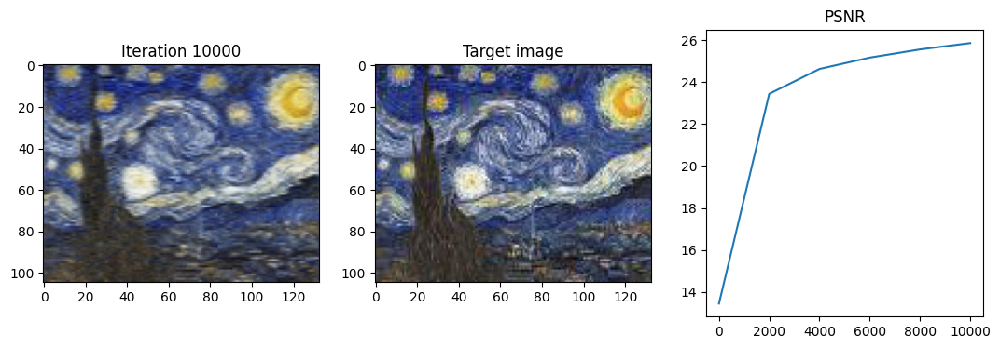

Done!


In [9]:
_ = train_2d_model(test_img=painting, num_frequencies=6, device=device)

torch.Size([133, 105])
torch.Size([133, 105])
tensor([[0.0000, 0.0000],
        [0.0000, 0.0096],
        [0.0000, 0.0192],
        ...,
        [1.0000, 0.9808],
        [1.0000, 0.9904],
        [1.0000, 1.0000]])
Iteration 0  Loss: 0.0577  PSNR: 12.39 Time: 0.00 secs per iter 0.01 secs in total


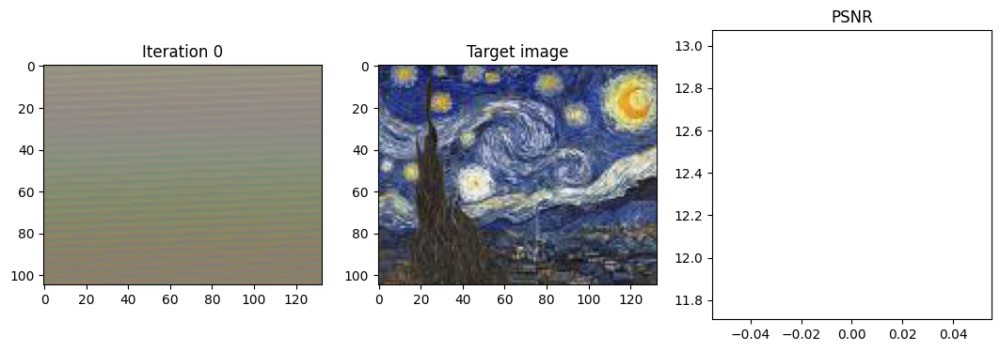

Iteration 2000  Loss: 0.0266  PSNR: 15.75 Time: 0.00 secs per iter 3.43 secs in total


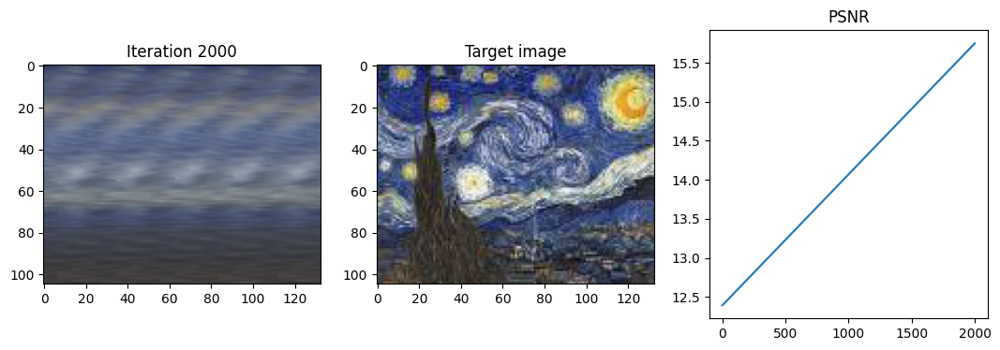

Iteration 4000  Loss: 0.0256  PSNR: 15.92 Time: 0.00 secs per iter 7.24 secs in total


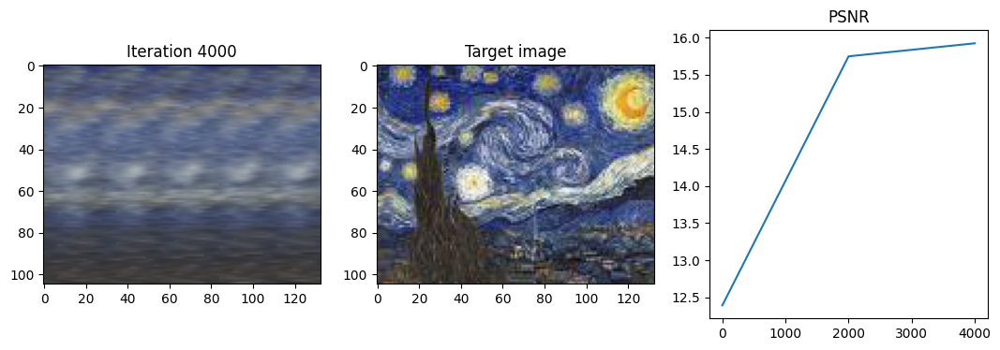

Iteration 6000  Loss: 0.0246  PSNR: 16.09 Time: 0.00 secs per iter 10.98 secs in total


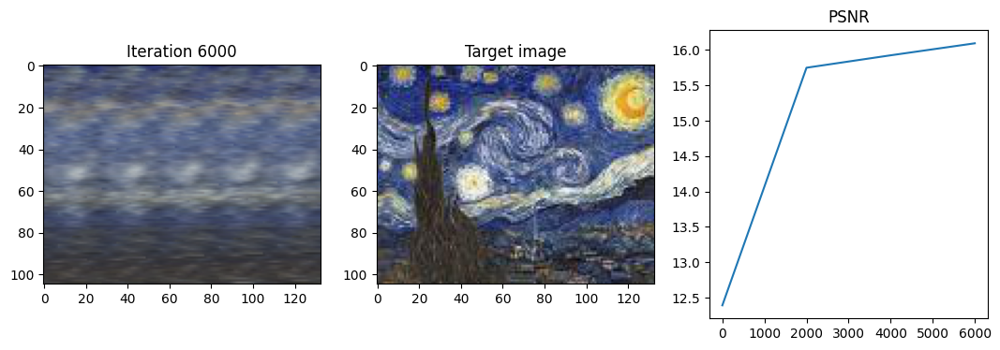

Iteration 8000  Loss: 0.0235  PSNR: 16.28 Time: 0.00 secs per iter 14.57 secs in total


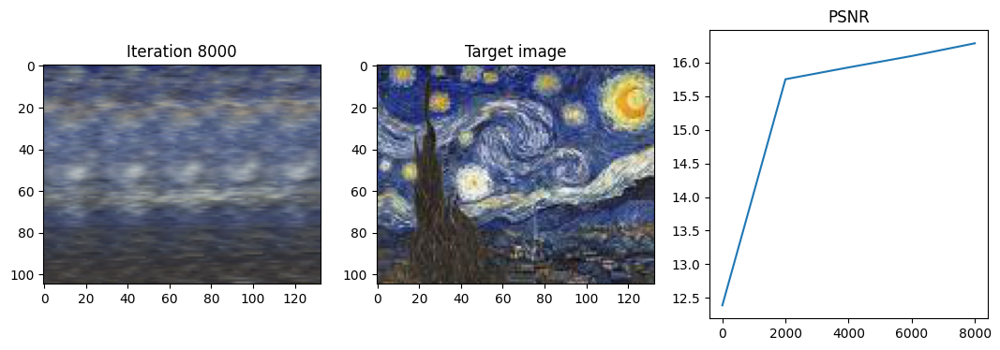

Iteration 10000  Loss: 0.0228  PSNR: 16.43 Time: 0.00 secs per iter 18.16 secs in total


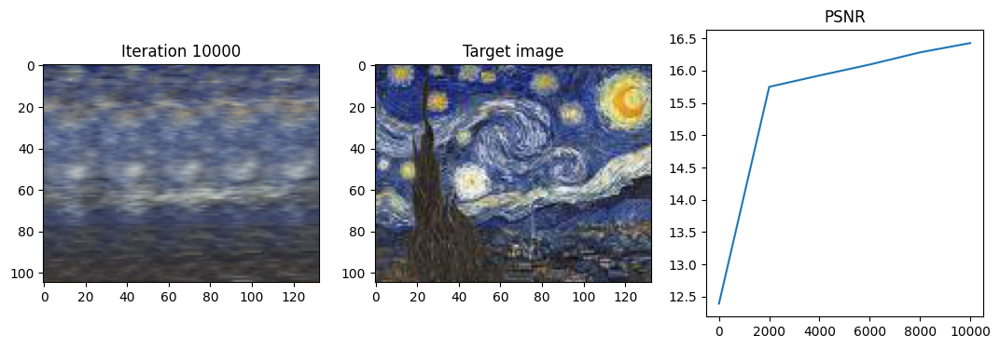

Done!


In [10]:
_ = train_2d_model(test_img=painting, num_frequencies=2, device=device)

### Part 2: Fitting a 3D Image

In [11]:
import os
import gdown
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F
import time

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [12]:
url = "https://drive.google.com/file/d/13eBK_LWxs4SkruFKH7glKK9jwQU1BkXK/view?usp=sharing"
gdown.download(url=url, output='lego_data.npz', quiet=False, fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=13eBK_LWxs4SkruFKH7glKK9jwQU1BkXK
To: c:\Users\prkri\Downloads\hw5\lego_data.npz
100%|██████████| 12.7M/12.7M [00:01<00:00, 6.96MB/s]


'lego_data.npz'

Here, we load the data that is comprised by the images, the R and T matrices of each camera position with respect to the world coordinates and the intrinsics parameters K of the camera.

torch.Size([106, 4, 4])


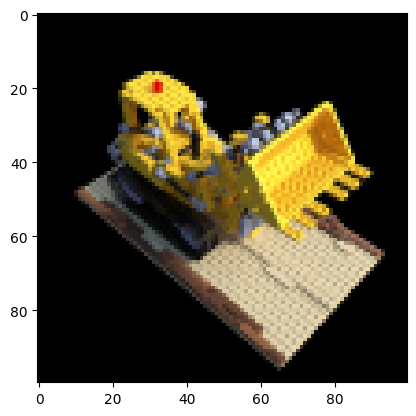

NpzFile 'lego_data.npz' with keys: images, poses, intrinsics


In [13]:
# Load input images, poses, and intrinsics
data = np.load("lego_data.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
poses = data["poses"]
poses = torch.from_numpy(poses).to(device)
print(poses.shape)

# Camera intrinsics
intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)

# Hold one image out (for test).
test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

print(data)

2.1 Complete the following function that calculates the rays that pass through all the pixels of an HxW image

In [14]:
def get_rays(height, width, intrinsics, w_R_c, w_T_c):

    """
    Compute the origin and direction of rays passing through all pixels of an image (one ray per pixel).

    Args:
    height: the height of an image.
    width: the width of an image.
    intrinsics: camera intrinsics matrix of shape (3, 3).
    w_R_c: Rotation matrix of shape (3,3) from camera to world coordinates.
    w_T_c: Translation vector of shape (3,1) that transforms

    Returns:
    ray_origins (torch.Tensor): A tensor of shape (height, width, 3) denoting the centers of
      each ray. Note that desipte that all ray share the same origin, here we ask you to return
      the ray origin for each ray as (height, width, 3).
    ray_directions (torch.Tensor): A tensor of shape (height, width, 3) denoting the
      direction of each ray.
    """

    device = intrinsics.device
    ray_directions = torch.zeros((height, width, 3), device=device)  # placeholder
    ray_origins = torch.zeros((height, width, 3), device=device)  # placeholder

    #############################  TODO 2.1 BEGIN  ##########################

   # Step 1: Create 2D pixel coordinates
    y_c, x_c = torch.meshgrid(
        torch.linspace(0, height - 1, height, device=device),
        torch.linspace(0, width - 1, width, device=device),
        indexing="ij",
    )

    # Step 2: Create homogeneous pixel coordinates
    points = torch.stack([x_c, y_c, torch.ones_like(x_c)], dim=-1)  # Shape: [H, W, 3]

    # Step 3: Transform pixel coordinates to world directions
    camera_directions = torch.inverse(intrinsics) @ points.view(-1, 3).T  # [3, H*W]
    camera_directions = camera_directions.T.view(height, width, 3)  # [H, W, 3]

    world_directions = w_R_c @ camera_directions.view(-1, 3).T  # Rotate as before
    world_directions = world_directions.T  # Transpose back to (H*W, 3)
    world_directions = world_directions.view(height, width, 3)  # Reshape to (H, W, 3)


    # Normalize the directions
    ray_directions = world_directions / torch.norm(world_directions, dim=-1, keepdim=True)


    # Step 4: Compute ray origins (same for all pixels)
    ray_origins = w_T_c.view(1, 1, 3).expand(height, width, 3)

    #############################  TODO 2.1 END  ############################
    return ray_origins, ray_directions

Complete the next function to visualize how is the dataset created. You will be able to see from which point of view each image has been captured for the 3D object. What we want to achieve here, is to being able to interpolate between these given views and synthesize new realistic views of the 3D object.

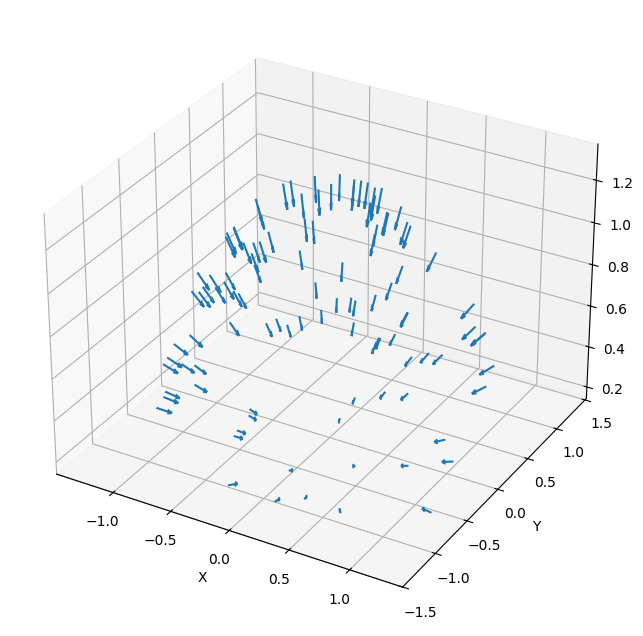

In [15]:
def plot_all_poses(poses):

    #############################  TODO 2.1 BEGIN  ############################
    origins,directions = poses[:, :3, 3],poses[:, :3, 2]

    #############################  TODO 2.1 END  ############################

    ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('z')
    plt.show()

plot_all_poses(data['poses'])

2.2 Complete the following function to implement the sampling of points along a given ray.

In [16]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):

    """
    Sample 3D points on the given rays. The near and far variables indicate the bounds of sampling range.

    Args:
    ray_origins: Origin of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    ray_directions: Direction of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    near: The 'near' extent of the bounding volume.
    far:  The 'far' extent of the bounding volume.
    samples: Number of samples to be drawn along each ray.

    Returns:
    ray_points: Query 3D points along each ray. Shape: (height, width, samples, 3).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
    """

    #############################  TODO 2.2 BEGIN  ############################



    depth_points = torch.linspace(near, far, samples, device=ray_origins.device) # 1d tensor
    # to multiply it with the current ray_points, we need to modify the dimension
    depth_points = depth_points.view(1,1, samples)
    depth_points = depth_points.expand(*ray_origins.shape[:2], samples)
    ray_points = ray_origins.unsqueeze(2) + ray_directions.unsqueeze(2) * depth_points.unsqueeze(-1)
    
    #############################  TODO 2.2 END  ############################
    return ray_points, depth_points

2.3 Define the network architecture of NeRF along with a function that divided data into chunks to avoid memory leaks during training.

In [17]:
class nerf_model(nn.Module):

    """
    Define a NeRF model comprising eight fully connected layers and following the
    architecture described in the NeRF paper.
    """

    def __init__(self, filter_size=256, num_x_frequencies=6, num_d_frequencies=3):
        super().__init__()
        x_dim = 3 * (num_x_frequencies * 2 + 1)
        d_dim = 3 * (num_d_frequencies * 2 + 1)

        #############################  TODO 2.3 BEGIN  ############################
        # for autograder compliance, please follow the given naming for your layers
        self.layers = nn.ModuleDict({
            'layer_1': nn.Linear(x_dim, filter_size),
            'layer_2': nn.Linear(filter_size, filter_size),
            'layer_3': nn.Linear(filter_size, filter_size),
            'layer_4': nn.Linear(filter_size, filter_size),
            'layer_5': nn.Linear(filter_size, filter_size),
            'layer_6': nn.Linear(filter_size + x_dim, filter_size),
            'layer_7': nn.Linear(filter_size, filter_size),
            'layer_8': nn.Linear(filter_size, filter_size),
            'layer_s': nn.Linear(filter_size, 1),
            'layer_9': nn.Linear(filter_size, filter_size),
            'layer_10': nn.Linear(filter_size + d_dim, 128),
            'layer_11': nn.Linear(128, 3),
        })

        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()
        #############################  TODO 2.3 END  ############################


    def forward(self, x, d):
        #############################  TODO 2.3 BEGIN  ############################
        # example of forward through a layer: y = self.layers['layer_1'](x)
        y = self.relu(self.layers['layer_1'](x))
        y = self.relu(self.layers['layer_2'](y))
        y = self.relu(self.layers['layer_3'](y))
        y = self.relu(self.layers['layer_4'](y))
        y = self.relu(self.layers['layer_5'](y))
        y = torch.cat([y, x], dim=1)
        y = self.relu(self.layers['layer_6'](y))
        y = self.relu(self.layers['layer_7'](y))
        y = self.relu(self.layers['layer_8'](y))
        sigma = self.layers['layer_s'](y)
        y = self.layers['layer_9'](y)
        y = torch.cat([y, d], dim=1)
        y = self.relu(self.layers['layer_10'](y))
        rgb = self.sigmoid(self.layers['layer_11'](y))
        #############################  TODO 2.3 END  ############################
        return rgb, sigma

In [18]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):

    def get_chunks(inputs, chunksize = 2**15):
        """
        This fuction gets an array/list as input and returns a list of chunks of the initial array/list
        """
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

    """
    This function returns chunks of the ray points and directions to avoid memory errors with the
    neural network. It also applies positional encoding to the input points and directions before
    dividing them into chunks, as well as normalizing and populating the directions.
    """
    #############################  TODO 2.3 BEGIN  ############################

    ray_direction_norm = ray_directions / torch.norm(ray_directions, dim = -1, keepdim= True) # h,w,3

    ray_directions = ray_direction_norm.unsqueeze(2).expand(-1, -1, ray_points.size(2), -1) # h,w,samples,3

    ray_directions =  ray_directions.reshape(-1,3)    #  h*w*samaples , 3
    ray_points = ray_points.reshape(-1, 3)

    ray_points_encoded = positional_encoding(ray_points, num_x_frequencies)  # Shape: [H*W*samples, encoded_dim]
    ray_directions_encoded = positional_encoding(ray_directions, num_d_frequencies)  # Shape: [H*W*samples, encoded_dim]

    ray_points_batches, ray_directions_batches = get_chunks(ray_points_encoded), get_chunks(ray_directions_encoded)

    #############################  TODO 2.3 END  ############################

    return ray_points_batches, ray_directions_batches

2.4 Compute the compositing weights of samples on camera ray and then complete the volumetric rendering procedure to reconstruct a whole RGB image from the sampled points and the outputs of the neural network.

In [19]:
def volumetric_rendering(rgb, s, depth_points):

    """
    Differentiably renders a radiance field, given the origin of each ray in the
    "bundle", and the sampled depth values along them.

    Args:
    rgb: RGB color at each query location (X, Y, Z). Shape: (height, width, samples, 3).
    sigma: Volume density at each query location (X, Y, Z). Shape: (height, width, samples).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).

    Returns:
    rec_image: The reconstructed image after applying the volumetric rendering to every pixel.
    Shape: (height, width, 3)
    """

    #############################  TODO 2.4 BEGIN  ############################
    depth_diff = torch.cat(
        [depth_points[..., 1:] - depth_points[..., :-1],
         torch.full_like(depth_points[..., :1], 1e10)], dim=-1
    )
    alpha = 1 - torch.exp(-F.relu(s) * depth_diff)
    T = torch.cumprod(1 - alpha + 1e-10, dim=-1)
    T = torch.roll(T, shifts=1, dims=-1)
    T[..., 0] = 1
    weights = T * alpha
    rec_image = torch.sum(weights[..., None] * rgb, dim=-2)

    #############################  TODO 2.4 END  ############################

    return rec_image

To test and visualize your implementation, independently of the previous and next steps of the
NeRF pipeline, you can load the sanity_volumentric.pt file, run your implementation of the volumetric function and expect to see the figure provided in the handout.


In [20]:
url = "https://drive.google.com/file/d/1ag6MqSh3h4KY10Mcx5fKxt9roGNLLILK/view?usp=sharing"
gdown.download(url=url, output='sanity_volumentric.pt', quiet=False, fuzzy=True)
rbd = torch.load('sanity_volumentric.pt')

Downloading...
From (original): https://drive.google.com/uc?id=1ag6MqSh3h4KY10Mcx5fKxt9roGNLLILK
From (redirected): https://drive.google.com/uc?id=1ag6MqSh3h4KY10Mcx5fKxt9roGNLLILK&confirm=t&uuid=0d037e93-d4f3-406c-8666-d19a962418c4
To: c:\Users\prkri\Downloads\hw5\sanity_volumentric.pt
100%|██████████| 120M/120M [00:10<00:00, 11.8MB/s] 
C:\Users\prkri\AppData\Local\Temp\ipykernel_30856\258645816.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicit

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000000099000008].


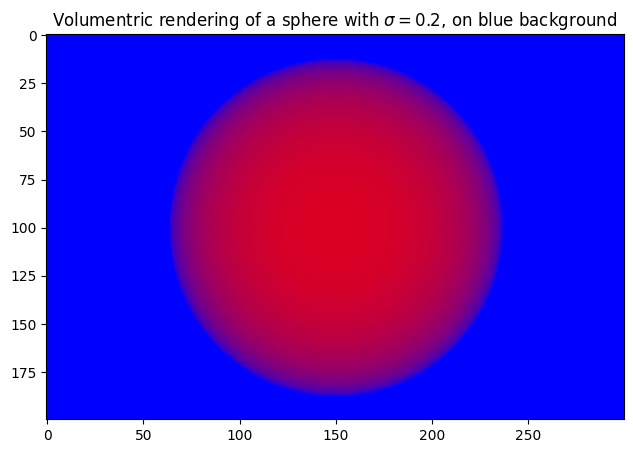

In [21]:
r = rbd['rgb']
s = rbd['sigma']
depth_points = rbd['depth_points']
rec_image = volumetric_rendering(r, s, depth_points)

plt.figure(figsize=(10, 5))
plt.imshow(rec_image.detach().cpu().numpy())
plt.title(f'Volumentric rendering of a sphere with $\\sigma={0.2}$, on blue background')
plt.show()

2.5 Combine everything together. Given the pose position of a camera, compute the camera rays and sample the 3D points along these rays. Divide those points into batches and feed them to the neural network. Concatenate them and use them for the volumetric rendering to reconstructed the final image.

In [22]:
def one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies):

    #############################  TODO 2.5 BEGIN  ############################

    #compute all the rays from the image
    ray_origins, ray_directions = get_rays(height, width, intrinsics, pose[:3, :3], pose[:3, 3])
    #sample the points from the rays
    ray_points, depth_points = stratified_sampling(ray_origins, ray_directions, near, far, samples)

    #divide data into batches to avoid memory errors
    ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies)

    #forward pass the batches and concatenate the outputs at the end
    rgb_batches, density_batches = zip(*[
        model(ray_points_batch, ray_directions_batch)
        for ray_points_batch, ray_directions_batch in zip(ray_points_batches, ray_directions_batches)
    ])
    rgb = torch.cat(rgb_batches, dim=0).reshape(height, width, samples, 3)
    density = torch.cat(density_batches, dim=0).reshape(height, width, samples)

    rec_image = volumetric_rendering(rgb, density, depth_points).to(device)

    # Apply volumetric rendering to obtain the reconstructed image


    #############################  TODO 2.5 END  ############################

    return rec_image

If you manage to pass the autograder for all the previous functions, then it is time to train a NeRF! We provide the hyperparameters for you, we initialize the NeRF model and its weights, and we define a couple lists that will be needed to store results.

In [23]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

psnrs = []
iternums = []

t = time.time()
t0 = time.time()

tensor([[ 0.1650, -0.4277,  0.6655],
        [ 0.1466, -0.4207,  0.6577],
        [ 0.1283, -0.4137,  0.6499],
        ...,
        [ 0.4961,  0.3874, -0.7309],
        [ 0.4934,  0.3986, -0.7486],
        [ 0.4907,  0.4098, -0.7664]], device='cuda:0')
tensor([[-0.8684,  0.3314, -0.3688],
        [-0.8684,  0.3314, -0.3688],
        [-0.8684,  0.3314, -0.3688],
        ...,
        [-0.1268,  0.5293, -0.8389],
        [-0.1268,  0.5293, -0.8389],
        [-0.1268,  0.5293, -0.8389]], device='cuda:0')
tensor([[-0.4003, -0.0856,  0.6967],
        [-0.3922, -0.0684,  0.6874],
        [-0.3840, -0.0513,  0.6781],
        ...,
        [ 0.2960, -0.5714, -0.7185],
        [ 0.3064, -0.5708, -0.7370],
        [ 0.3167, -0.5702, -0.7554]], device='cuda:0')
tensor([[ 0.3866,  0.8107, -0.4396],
        [ 0.3866,  0.8107, -0.4396],
        [ 0.3866,  0.8107, -0.4396],
        ...,
        [ 0.4874,  0.0280, -0.8727],
        [ 0.4874,  0.0280, -0.8727],
        [ 0.4874,  0.0280, -0.8727]], devic

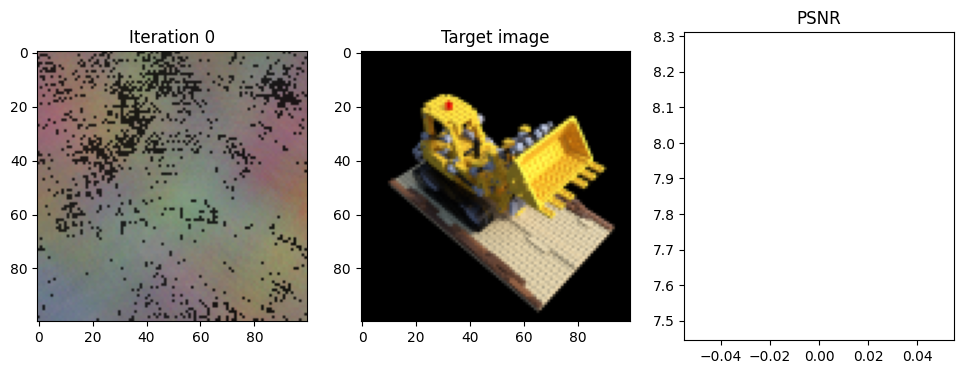

tensor([[-0.3587,  0.4649,  0.5553],
        [-0.3382,  0.4605,  0.5519],
        [-0.3178,  0.4562,  0.5485],
        ...,
        [-0.2746, -0.5560, -0.7388],
        [-0.2667, -0.5685, -0.7540],
        [-0.2588, -0.5810, -0.7691]], device='cuda:0')
tensor([[ 0.9656, -0.2054, -0.1597],
        [ 0.9656, -0.2054, -0.1597],
        [ 0.9656, -0.2054, -0.1597],
        ...,
        [ 0.3719, -0.5915, -0.7154],
        [ 0.3719, -0.5915, -0.7154],
        [ 0.3719, -0.5915, -0.7154]], device='cuda:0')
tensor([[-0.6569, -0.0859,  0.4627],
        [-0.6420, -0.0709,  0.4625],
        [-0.6270, -0.0560,  0.4622],
        ...,
        [ 0.4225, -0.4806, -0.7217],
        [ 0.4393, -0.4797, -0.7346],
        [ 0.4561, -0.4789, -0.7475]], device='cuda:0')
tensor([[ 0.7070,  0.7071, -0.0114],
        [ 0.7070,  0.7071, -0.0114],
        [ 0.7070,  0.7071, -0.0114],
        ...,
        [ 0.7923,  0.0393, -0.6089],
        [ 0.7923,  0.0393, -0.6089],
        [ 0.7923,  0.0393, -0.6089]], devic

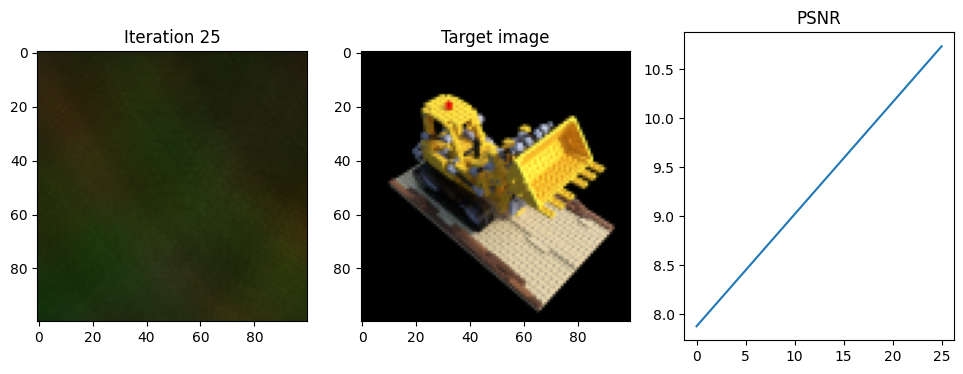

tensor([[ 0.1533,  0.4471,  0.6555],
        [ 0.1626,  0.4296,  0.6481],
        [ 0.1720,  0.4121,  0.6408],
        ...,
        [-0.6261,  0.0147, -0.7336],
        [-0.6314,  0.0041, -0.7511],
        [-0.6366, -0.0065, -0.7686]], device='cuda:0')
tensor([[ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        ...,
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279]], device='cuda:0')
tensor([[-0.3225,  0.6429,  0.3684],
        [-0.3039,  0.6333,  0.3710],
        [-0.2852,  0.6237,  0.3736],
        ...,
        [-0.2594, -0.6214, -0.6906],
        [-0.2524, -0.6383, -0.7012],
        [-0.2453, -0.6552, -0.7117]], device='cuda:0')
tensor([[ 0.8827, -0.4533,  0.1240],
        [ 0.8827, -0.4533,  0.1240],
        [ 0.8827, -0.4533,  0.1240],
        ...,
        [ 0.3330, -0.8003, -0.4987],
        [ 0.3330, -0.8003, -0.4987],
        [ 0.3330, -0.8003, -0.4987]], devic

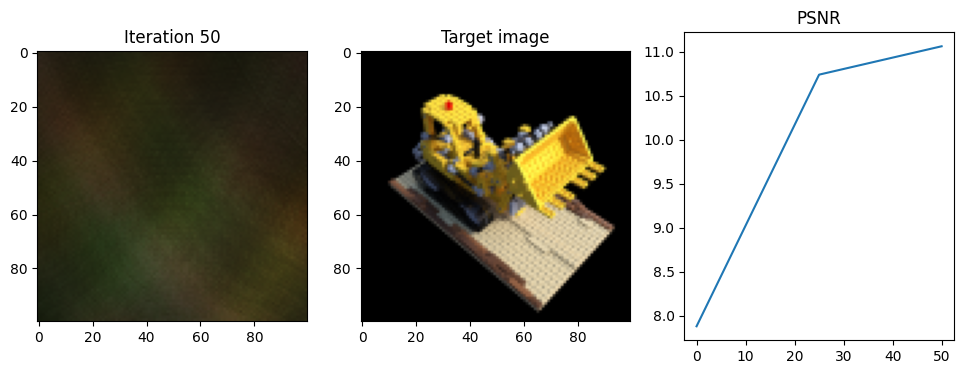

tensor([[-0.0081,  0.2179,  0.7781],
        [ 0.0054,  0.2226,  0.7625],
        [ 0.0188,  0.2274,  0.7469],
        ...,
        [-0.5417, -0.5406, -0.5871],
        [-0.5429, -0.5472, -0.6072],
        [-0.5441, -0.5537, -0.6272]], device='cuda:0')
tensor([[ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        ...,
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488]], device='cuda:0')
tensor([[-0.6953, -0.1746,  0.3729],
        [-0.6819, -0.1584,  0.3754],
        [-0.6685, -0.1422,  0.3779],
        ...,
        [ 0.5467, -0.3901, -0.6924],
        [ 0.5647, -0.3869, -0.7031],
        [ 0.5827, -0.3837, -0.7137]], device='cuda:0')
tensor([[ 0.6342,  0.7641,  0.1178],
        [ 0.6342,  0.7641,  0.1178],
        [ 0.6342,  0.7641,  0.1178],
        ...,
        [ 0.8505,  0.1503, -0.5040],
        [ 0.8505,  0.1503, -0.5040],
        [ 0.8505,  0.1503, -0.5040]], devic

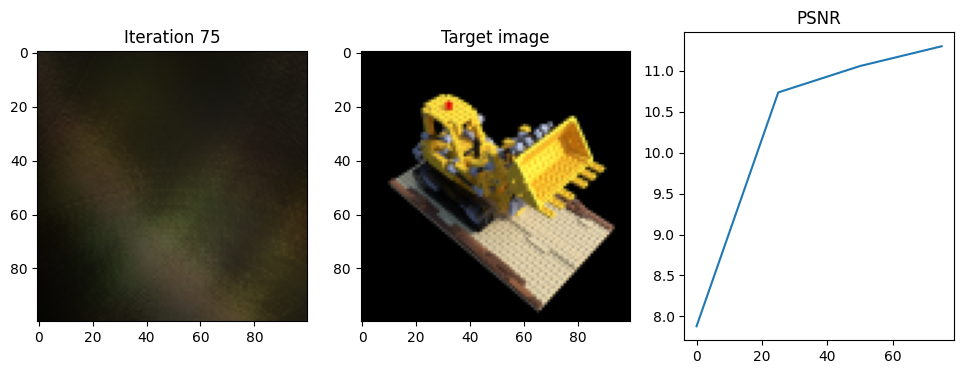

tensor([[-0.0081,  0.2179,  0.7781],
        [ 0.0054,  0.2226,  0.7625],
        [ 0.0188,  0.2274,  0.7469],
        ...,
        [-0.5417, -0.5406, -0.5871],
        [-0.5429, -0.5472, -0.6072],
        [-0.5441, -0.5537, -0.6272]], device='cuda:0')
tensor([[ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        ...,
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488]], device='cuda:0')
tensor([[-0.5430,  0.2406,  0.5480],
        [-0.5229,  0.2464,  0.5449],
        [-0.5028,  0.2522,  0.5417],
        ...,
        [ 0.0305, -0.6202, -0.7381],
        [ 0.0436, -0.6275, -0.7531],
        [ 0.0566, -0.6349, -0.7680]], device='cuda:0')
tensor([[ 0.9501,  0.2751, -0.1473],
        [ 0.9501,  0.2751, -0.1473],
        [ 0.9501,  0.2751, -0.1473],
        ...,
        [ 0.6167, -0.3460, -0.7071],
        [ 0.6167, -0.3460, -0.7071],
        [ 0.6167, -0.3460, -0.7071]], devic

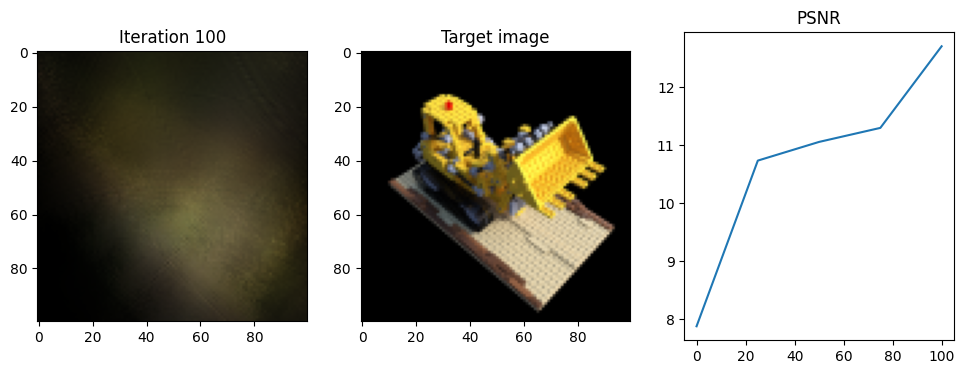

tensor([[-0.0397,  0.3443,  0.7300],
        [-0.0232,  0.3373,  0.7189],
        [-0.0066,  0.3302,  0.7077],
        ...,
        [-0.6187, -0.2534, -0.6953],
        [-0.6193, -0.2623, -0.7145],
        [-0.6199, -0.2712, -0.7337]], device='cuda:0')
tensor([[ 0.7818, -0.3338, -0.5267],
        [ 0.7818, -0.3338, -0.5267],
        [ 0.7818, -0.3338, -0.5267],
        ...,
        [-0.0294, -0.4191, -0.9075],
        [-0.0294, -0.4191, -0.9075],
        [-0.0294, -0.4191, -0.9075]], device='cuda:0')
tensor([[ 0.4143, -0.5436,  0.4312],
        [ 0.3940, -0.5378,  0.4319],
        [ 0.3736, -0.5321,  0.4327],
        ...,
        [ 0.1834,  0.6236, -0.7127],
        [ 0.1740,  0.6381, -0.7248],
        [ 0.1646,  0.6527, -0.7369]], device='cuda:0')
tensor([[-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        ...,
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722]], devic

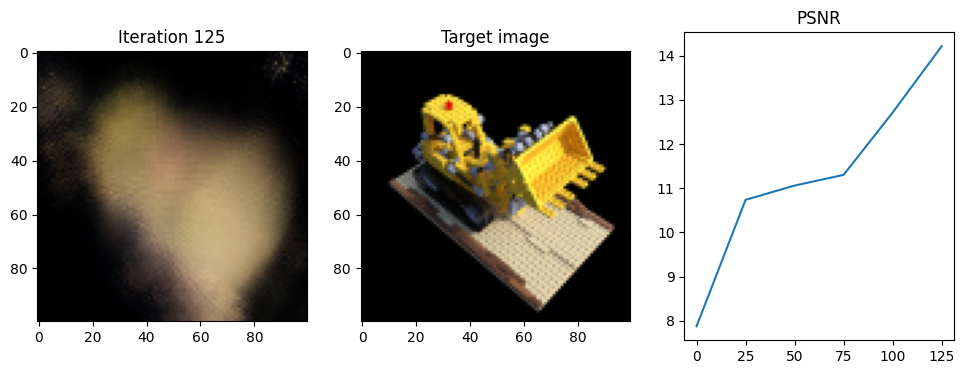

tensor([[ 0.2422, -0.3358,  0.6940],
        [ 0.2231, -0.3351,  0.6848],
        [ 0.2040, -0.3343,  0.6757],
        ...,
        [ 0.4022,  0.5004, -0.7199],
        [ 0.3974,  0.5097, -0.7383],
        [ 0.3927,  0.5190, -0.7567]], device='cuda:0')
tensor([[-0.9007,  0.0352, -0.4331],
        [-0.9007,  0.0352, -0.4331],
        [-0.9007,  0.0352, -0.4331],
        ...,
        [-0.2251,  0.4391, -0.8698],
        [-0.2251,  0.4391, -0.8698],
        [-0.2251,  0.4391, -0.8698]], device='cuda:0')
tensor([[-0.2644, -0.5968,  0.4764],
        [-0.2695, -0.5763,  0.4757],
        [-0.2746, -0.5557,  0.4751],
        ...,
        [ 0.6283,  0.0982, -0.7252],
        [ 0.6362,  0.1127, -0.7384],
        [ 0.6441,  0.1272, -0.7517]], device='cuda:0')
tensor([[-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        ...,
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248]], devic

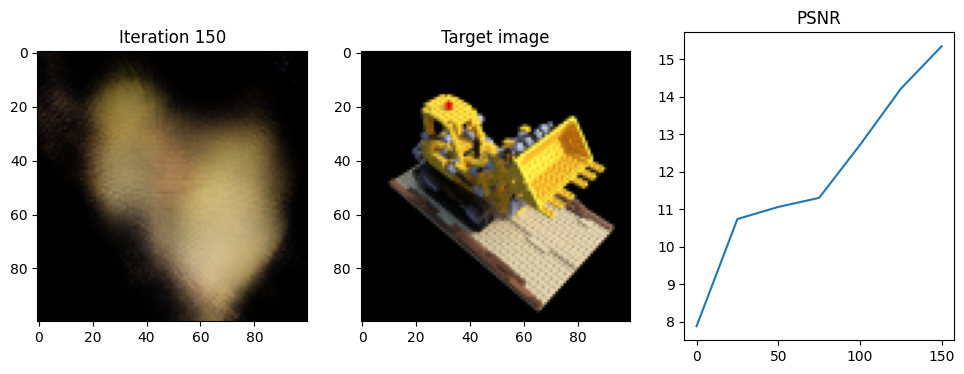

tensor([[-0.3644,  0.2603,  0.6727],
        [-0.3454,  0.2648,  0.6645],
        [-0.3264,  0.2693,  0.6564],
        ...,
        [-0.2068, -0.5973, -0.7286],
        [-0.1986, -0.6050, -0.7465],
        [-0.1904, -0.6128, -0.7645]], device='cuda:0')
tensor([[ 0.8983,  0.2130, -0.3844],
        [ 0.8983,  0.2130, -0.3844],
        [ 0.8983,  0.2130, -0.3844],
        ...,
        [ 0.3866, -0.3655, -0.8468],
        [ 0.3866, -0.3655, -0.8468],
        [ 0.3866, -0.3655, -0.8468]], device='cuda:0')
tensor([[ 0.6264,  0.2617,  0.4384],
        [ 0.6157,  0.2434,  0.4389],
        [ 0.6051,  0.2251,  0.4395],
        ...,
        [-0.5517,  0.3391, -0.7149],
        [-0.5680,  0.3337, -0.7272],
        [-0.5844,  0.3283, -0.7394]], device='cuda:0')
tensor([[-0.5034, -0.8637,  0.0248],
        [-0.5034, -0.8637,  0.0248],
        [-0.5034, -0.8637,  0.0248],
        ...,
        [-0.7733, -0.2547, -0.5807],
        [-0.7733, -0.2547, -0.5807],
        [-0.7733, -0.2547, -0.5807]], devic

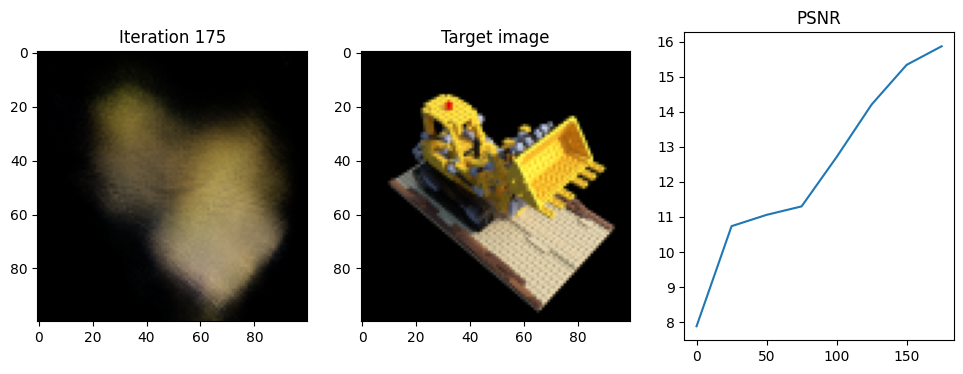

tensor([[ 0.2185, -0.6362,  0.4478],
        [ 0.2009, -0.6244,  0.4481],
        [ 0.1833, -0.6127,  0.4483],
        ...,
        [ 0.3790,  0.5213, -0.7176],
        [ 0.3747,  0.5378, -0.7302],
        [ 0.3705,  0.5543, -0.7427]], device='cuda:0')
tensor([[-0.8311,  0.5561,  0.0109],
        [-0.8311,  0.5561,  0.0109],
        [-0.8311,  0.5561,  0.0109],
        ...,
        [-0.2011,  0.7807, -0.5916],
        [-0.2011,  0.7807, -0.5916],
        [-0.2011,  0.7807, -0.5916]], device='cuda:0')
tensor([[-0.2759, -0.6663,  0.3647],
        [-0.2808, -0.6459,  0.3674],
        [-0.2858, -0.6255,  0.3701],
        ...,
        [ 0.6402,  0.2136, -0.6892],
        [ 0.6484,  0.2300, -0.6996],
        [ 0.6566,  0.2465, -0.7101]], device='cuda:0')
tensor([[-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        ...,
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943]], devic

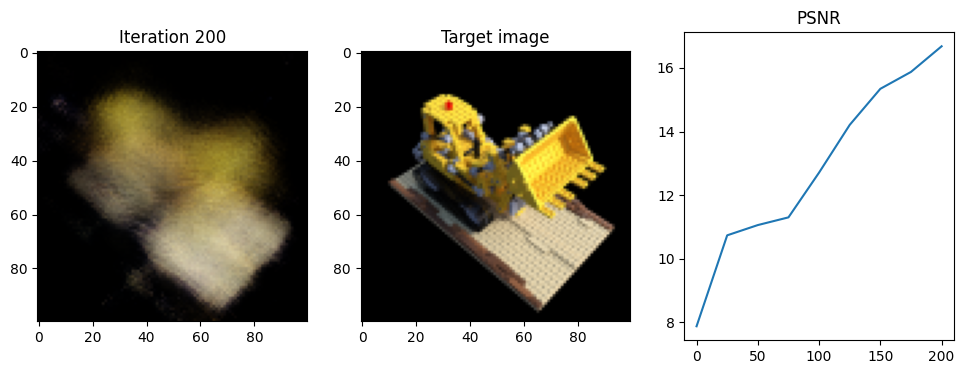

tensor([[ 0.3393, -0.4582,  0.5727],
        [ 0.3190, -0.4538,  0.5687],
        [ 0.2987, -0.4493,  0.5647],
        ...,
        [ 0.2995,  0.5413, -0.7401],
        [ 0.2921,  0.5536, -0.7556],
        [ 0.2848,  0.5659, -0.7712]], device='cuda:0')
tensor([[-0.9590,  0.2102, -0.1898],
        [-0.9590,  0.2102, -0.1898],
        [-0.9590,  0.2102, -0.1898],
        ...,
        [-0.3471,  0.5822, -0.7353],
        [-0.3471,  0.5822, -0.7353],
        [-0.3471,  0.5822, -0.7353]], device='cuda:0')
tensor([[-0.1194, -0.3818,  0.7022],
        [-0.1305, -0.3666,  0.6926],
        [-0.1416, -0.3513,  0.6830],
        ...,
        [ 0.6463, -0.0246, -0.7156],
        [ 0.6508, -0.0155, -0.7342],
        [ 0.6553, -0.0064, -0.7528]], device='cuda:0')
tensor([[-0.5249,  0.7208, -0.4528],
        [-0.5249,  0.7208, -0.4528],
        [-0.5249,  0.7208, -0.4528],
        ...,
        [ 0.2123,  0.4281, -0.8785],
        [ 0.2123,  0.4281, -0.8785],
        [ 0.2123,  0.4281, -0.8785]], devic

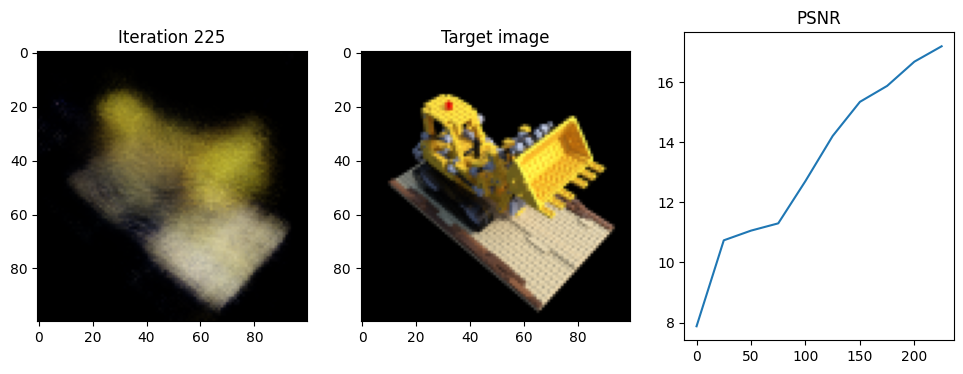

tensor([[ 0.1650, -0.4277,  0.6655],
        [ 0.1466, -0.4207,  0.6577],
        [ 0.1283, -0.4137,  0.6499],
        ...,
        [ 0.4961,  0.3874, -0.7309],
        [ 0.4934,  0.3986, -0.7486],
        [ 0.4907,  0.4098, -0.7664]], device='cuda:0')
tensor([[-0.8684,  0.3314, -0.3688],
        [-0.8684,  0.3314, -0.3688],
        [-0.8684,  0.3314, -0.3688],
        ...,
        [-0.1268,  0.5293, -0.8389],
        [-0.1268,  0.5293, -0.8389],
        [-0.1268,  0.5293, -0.8389]], device='cuda:0')
tensor([[-0.2759, -0.6663,  0.3647],
        [-0.2808, -0.6459,  0.3674],
        [-0.2858, -0.6255,  0.3701],
        ...,
        [ 0.6402,  0.2136, -0.6892],
        [ 0.6484,  0.2300, -0.6996],
        [ 0.6566,  0.2465, -0.7101]], device='cuda:0')
tensor([[-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        ...,
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943]], devic

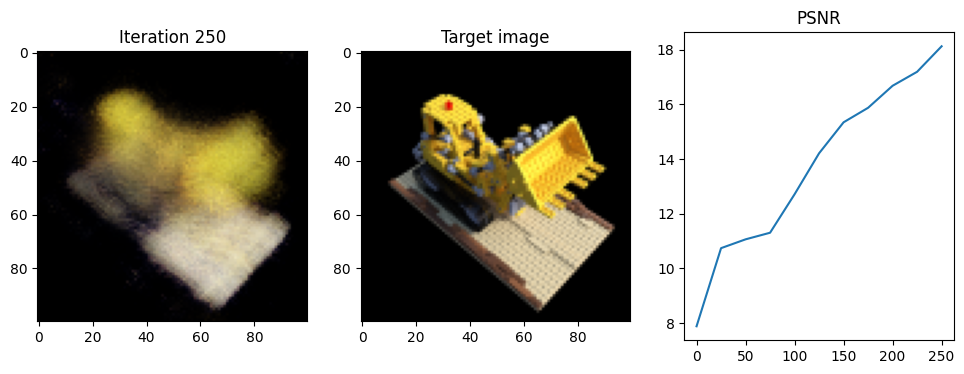

tensor([[-0.3286, -0.3203,  0.6652],
        [-0.3294, -0.3006,  0.6574],
        [-0.3301, -0.2810,  0.6496],
        ...,
        [ 0.5514, -0.3034, -0.7310],
        [ 0.5606, -0.2965, -0.7487],
        [ 0.5699, -0.2897, -0.7665]], device='cuda:0')
tensor([[-0.0365,  0.9291, -0.3681],
        [-0.0365,  0.9291, -0.3681],
        [-0.0365,  0.9291, -0.3681],
        ...,
        [ 0.4371,  0.3252, -0.8386],
        [ 0.4371,  0.3252, -0.8386],
        [ 0.4371,  0.3252, -0.8386]], device='cuda:0')
tensor([[-0.6953, -0.1746,  0.3729],
        [-0.6819, -0.1584,  0.3754],
        [-0.6685, -0.1422,  0.3779],
        ...,
        [ 0.5467, -0.3901, -0.6924],
        [ 0.5647, -0.3869, -0.7031],
        [ 0.5827, -0.3837, -0.7137]], device='cuda:0')
tensor([[ 0.6342,  0.7641,  0.1178],
        [ 0.6342,  0.7641,  0.1178],
        [ 0.6342,  0.7641,  0.1178],
        ...,
        [ 0.8505,  0.1503, -0.5040],
        [ 0.8505,  0.1503, -0.5040],
        [ 0.8505,  0.1503, -0.5040]], devic

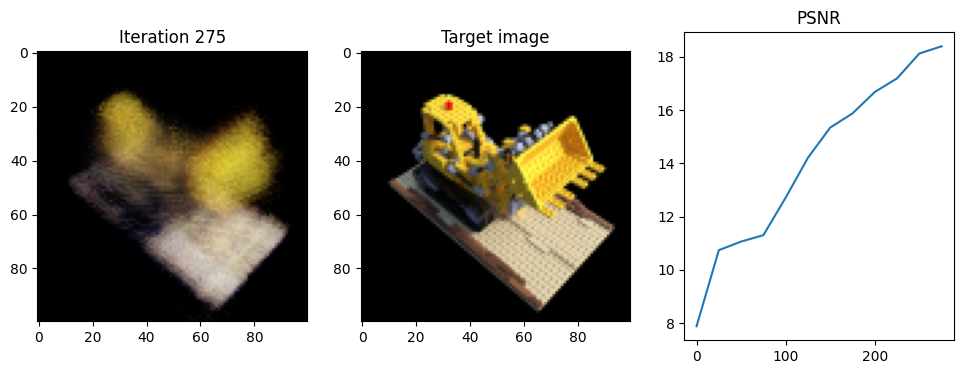

tensor([[-0.4930,  0.1510,  0.6222],
        [-0.4749,  0.1602,  0.6163],
        [-0.4568,  0.1695,  0.6103],
        ...,
        [ 0.0343, -0.6188, -0.7391],
        [ 0.0462, -0.6240, -0.7558],
        [ 0.0580, -0.6292, -0.7726]], device='cuda:0')
tensor([[ 0.8550,  0.4360, -0.2808],
        [ 0.8550,  0.4360, -0.2808],
        [ 0.8550,  0.4360, -0.2808],
        ...,
        [ 0.5607, -0.2447, -0.7911],
        [ 0.5607, -0.2447, -0.7911],
        [ 0.5607, -0.2447, -0.7911]], device='cuda:0')
tensor([[ 0.1917,  0.1007,  0.7786],
        [ 0.2021,  0.0912,  0.7628],
        [ 0.2126,  0.0817,  0.7471],
        ...,
        [-0.7331,  0.2328, -0.5820],
        [-0.7395,  0.2310, -0.6021],
        [-0.7460,  0.2292, -0.6222]], device='cuda:0')
tensor([[ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        ...,
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487]], devic

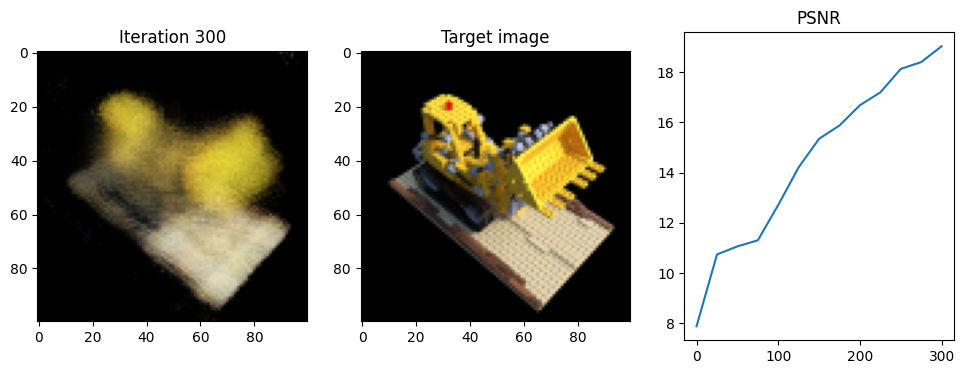

tensor([[ 0.5247, -0.4083,  0.4594],
        [ 0.5035, -0.4081,  0.4593],
        [ 0.4824, -0.4080,  0.4591],
        ...,
        [ 0.0420,  0.6395, -0.7209],
        [ 0.0296,  0.6509, -0.7337],
        [ 0.0171,  0.6623, -0.7465]], device='cuda:0')
tensor([[-1.0000,  0.0070, -0.0064],
        [-1.0000,  0.0070, -0.0064],
        [-1.0000,  0.0070, -0.0064],
        ...,
        [-0.5873,  0.5376, -0.6051],
        [-0.5873,  0.5376, -0.6051],
        [-0.5873,  0.5376, -0.6051]], device='cuda:0')
tensor([[-0.1726,  0.6780,  0.4044],
        [-0.1563,  0.6647,  0.4060],
        [-0.1399,  0.6514,  0.4075],
        ...,
        [-0.4013, -0.5234, -0.7039],
        [-0.3982, -0.5409, -0.7153],
        [-0.3950, -0.5584, -0.7268]], device='cuda:0')
tensor([[ 0.7735, -0.6295,  0.0739],
        [ 0.7735, -0.6295,  0.0739],
        [ 0.7735, -0.6295,  0.0739],
        ...,
        [ 0.1467, -0.8282, -0.5409],
        [ 0.1467, -0.8282, -0.5409],
        [ 0.1467, -0.8282, -0.5409]], devic

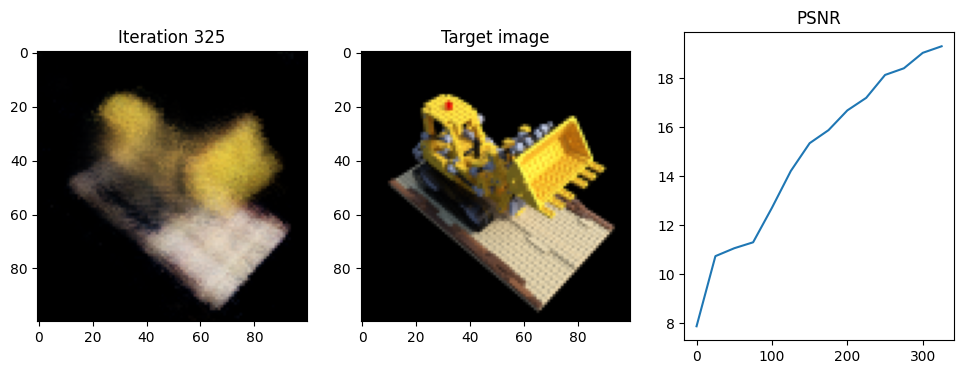

tensor([[-0.1679,  0.6262,  0.4825],
        [-0.1510,  0.6134,  0.4816],
        [-0.1341,  0.6007,  0.4807],
        ...,
        [-0.4302, -0.4661, -0.7267],
        [-0.4273, -0.4823, -0.7400],
        [-0.4243, -0.4984, -0.7534]], device='cuda:0')
tensor([[ 0.7981, -0.6011, -0.0416],
        [ 0.7981, -0.6011, -0.0416],
        [ 0.7981, -0.6011, -0.0416],
        ...,
        [ 0.1380, -0.7628, -0.6318],
        [ 0.1380, -0.7628, -0.6318],
        [ 0.1380, -0.7628, -0.6318]], device='cuda:0')
tensor([[ 0.1610,  0.2420,  0.7540],
        [ 0.1713,  0.2287,  0.7412],
        [ 0.1816,  0.2153,  0.7284],
        ...,
        [-0.6775,  0.1683, -0.6656],
        [-0.6831,  0.1630, -0.6853],
        [-0.6886,  0.1576, -0.7050]], device='cuda:0')
tensor([[ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        ...,
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310]], devic

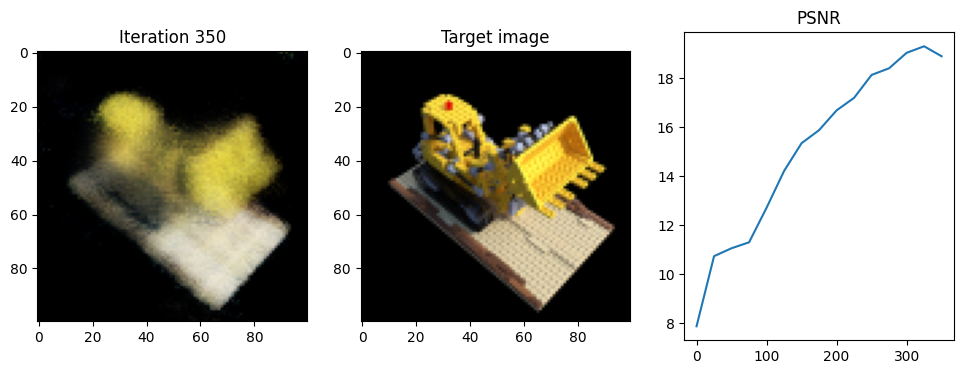

tensor([[ 0.2204,  0.1682,  0.7591],
        [ 0.2266,  0.1529,  0.7459],
        [ 0.2329,  0.1376,  0.7327],
        ...,
        [-0.6048,  0.3653, -0.6566],
        [-0.6116,  0.3623, -0.6764],
        [-0.6184,  0.3592, -0.6962]], device='cuda:0')
tensor([[ 0.2940, -0.7243, -0.6237],
        [ 0.2940, -0.7243, -0.6237],
        [ 0.2940, -0.7243, -0.6237],
        ...,
        [-0.3214, -0.1461, -0.9356],
        [-0.3214, -0.1461, -0.9356],
        [-0.3214, -0.1461, -0.9356]], device='cuda:0')
tensor([[ 0.4143, -0.5436,  0.4312],
        [ 0.3940, -0.5378,  0.4319],
        [ 0.3736, -0.5321,  0.4327],
        ...,
        [ 0.1834,  0.6236, -0.7127],
        [ 0.1740,  0.6381, -0.7248],
        [ 0.1646,  0.6527, -0.7369]], device='cuda:0')
tensor([[-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        ...,
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722]], devic

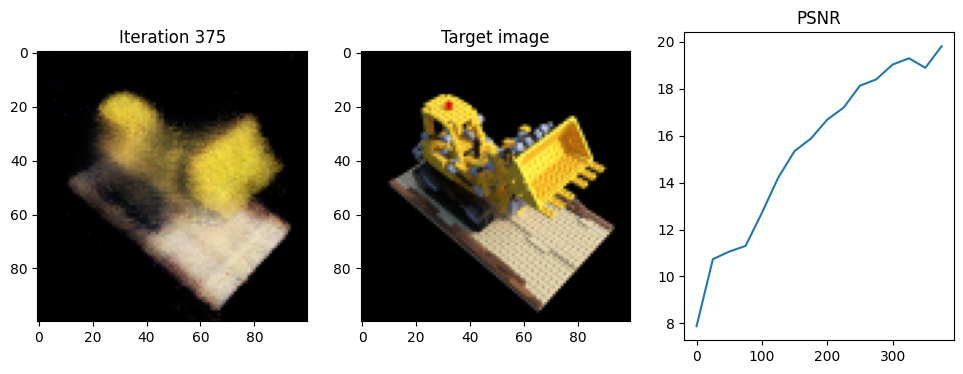

tensor([[-0.4791, -0.2477,  0.6018],
        [-0.4721, -0.2284,  0.5966],
        [-0.4651, -0.2091,  0.5915],
        ...,
        [ 0.4687, -0.4032, -0.7404],
        [ 0.4813, -0.3983, -0.7567],
        [ 0.4939, -0.3934, -0.7729]], device='cuda:0')
tensor([[ 0.3315,  0.9118, -0.2422],
        [ 0.3315,  0.9118, -0.2422],
        [ 0.3315,  0.9118, -0.2422],
        ...,
        [ 0.5971,  0.2313, -0.7681],
        [ 0.5971,  0.2313, -0.7681],
        [ 0.5971,  0.2313, -0.7681]], device='cuda:0')
tensor([[ 0.5413, -0.5155,  0.3070],
        [ 0.5208, -0.5127,  0.3114],
        [ 0.5003, -0.5099,  0.3157],
        ...,
        [-0.0109,  0.6989, -0.6646],
        [-0.0238,  0.7130, -0.6737],
        [-0.0368,  0.7271, -0.6827]], device='cuda:0')
tensor([[-0.9695,  0.1333,  0.2056],
        [-0.9695,  0.1333,  0.2056],
        [-0.9695,  0.1333,  0.2056],
        ...,
        [-0.6124,  0.6658, -0.4263],
        [-0.6124,  0.6658, -0.4263],
        [-0.6124,  0.6658, -0.4263]], devic

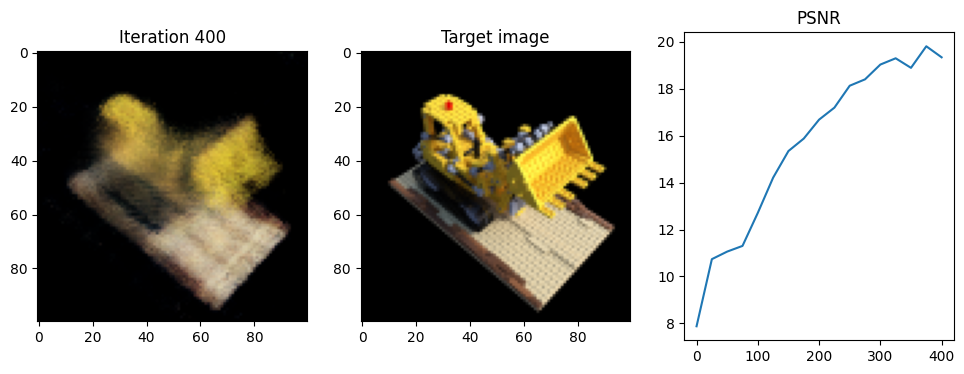

tensor([[-0.3587,  0.4649,  0.5553],
        [-0.3382,  0.4605,  0.5519],
        [-0.3178,  0.4562,  0.5485],
        ...,
        [-0.2746, -0.5560, -0.7388],
        [-0.2667, -0.5685, -0.7540],
        [-0.2588, -0.5810, -0.7691]], device='cuda:0')
tensor([[ 0.9656, -0.2054, -0.1597],
        [ 0.9656, -0.2054, -0.1597],
        [ 0.9656, -0.2054, -0.1597],
        ...,
        [ 0.3719, -0.5915, -0.7154],
        [ 0.3719, -0.5915, -0.7154],
        [ 0.3719, -0.5915, -0.7154]], device='cuda:0')
tensor([[ 0.0786, -0.2004,  0.7789],
        [ 0.0719, -0.2116,  0.7623],
        [ 0.0651, -0.2228,  0.7457],
        ...,
        [ 0.1555,  0.7788, -0.5475],
        [ 0.1540,  0.7855, -0.5675],
        [ 0.1525,  0.7923, -0.5875]], device='cuda:0')
tensor([[-0.3210, -0.5300, -0.7849],
        [-0.3210, -0.5300, -0.7849],
        [-0.3210, -0.5300, -0.7849],
        ...,
        [-0.0701,  0.3196, -0.9450],
        [-0.0701,  0.3196, -0.9450],
        [-0.0701,  0.3196, -0.9450]], devic

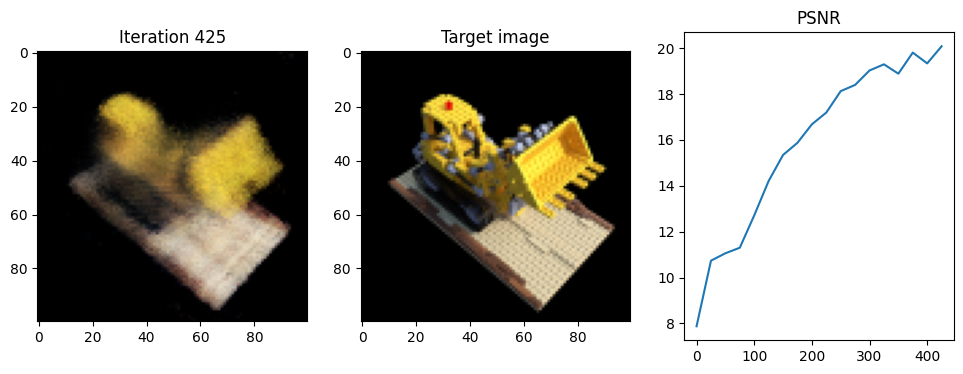

tensor([[ 0.5135,  0.0252,  0.6234],
        [ 0.4997,  0.0104,  0.6175],
        [ 0.4858, -0.0045,  0.6115],
        ...,
        [-0.2413,  0.5710, -0.7390],
        [-0.2542,  0.5719, -0.7557],
        [-0.2671,  0.5727, -0.7725]], device='cuda:0')
tensor([[-0.6547, -0.7008, -0.2832],
        [-0.6547, -0.7008, -0.2832],
        [-0.6547, -0.7008, -0.2832],
        ...,
        [-0.6087,  0.0400, -0.7924],
        [-0.6087,  0.0400, -0.7924],
        [-0.6087,  0.0400, -0.7924]], device='cuda:0')
tensor([[-0.4533,  0.4589,  0.4868],
        [-0.4324,  0.4562,  0.4858],
        [-0.4114,  0.4536,  0.4847],
        ...,
        [-0.1469, -0.6159, -0.7277],
        [-0.1364, -0.6284, -0.7411],
        [-0.1260, -0.6409, -0.7546]], device='cuda:0')
tensor([[ 0.9909, -0.1259, -0.0483],
        [ 0.9909, -0.1259, -0.0483],
        [ 0.9909, -0.1259, -0.0483],
        ...,
        [ 0.4941, -0.5919, -0.6368],
        [ 0.4941, -0.5919, -0.6368],
        [ 0.4941, -0.5919, -0.6368]], devic

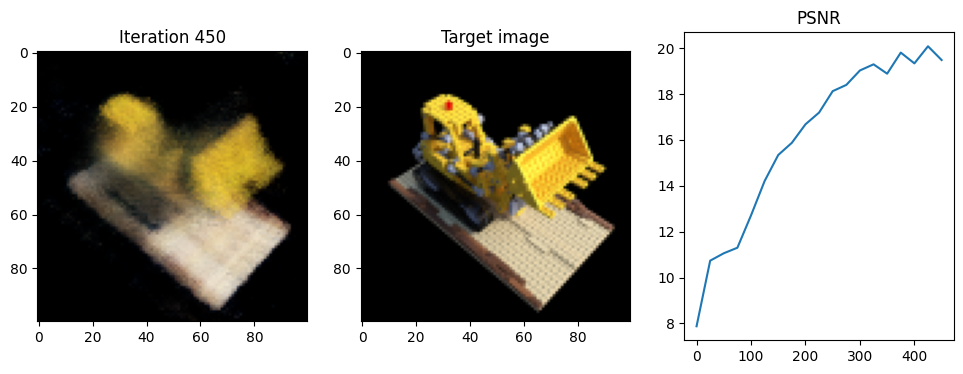

tensor([[ 0.1917,  0.1007,  0.7786],
        [ 0.2021,  0.0912,  0.7628],
        [ 0.2126,  0.0817,  0.7471],
        ...,
        [-0.7331,  0.2328, -0.5820],
        [-0.7395,  0.2310, -0.6021],
        [-0.7460,  0.2292, -0.6222]], device='cuda:0')
tensor([[ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        ...,
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487]], device='cuda:0')
tensor([[-0.1726,  0.6780,  0.4044],
        [-0.1563,  0.6647,  0.4060],
        [-0.1399,  0.6514,  0.4075],
        ...,
        [-0.4013, -0.5234, -0.7039],
        [-0.3982, -0.5409, -0.7153],
        [-0.3950, -0.5584, -0.7268]], device='cuda:0')
tensor([[ 0.7735, -0.6295,  0.0739],
        [ 0.7735, -0.6295,  0.0739],
        [ 0.7735, -0.6295,  0.0739],
        ...,
        [ 0.1467, -0.8282, -0.5409],
        [ 0.1467, -0.8282, -0.5409],
        [ 0.1467, -0.8282, -0.5409]], devic

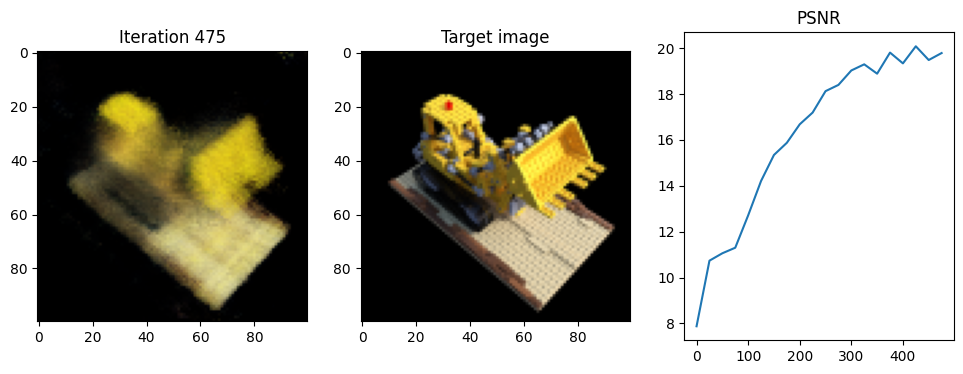

tensor([[-0.0299, -0.6820,  0.4324],
        [-0.0419, -0.6646,  0.4332],
        [-0.0539, -0.6471,  0.4339],
        ...,
        [ 0.5405,  0.3603, -0.7131],
        [ 0.5426,  0.3775, -0.7252],
        [ 0.5447,  0.3947, -0.7373]], device='cuda:0')
tensor([[-0.5658,  0.8239,  0.0336],
        [-0.5658,  0.8239,  0.0336],
        [-0.5658,  0.8239,  0.0336],
        ...,
        [ 0.0986,  0.8131, -0.5737],
        [ 0.0986,  0.8131, -0.5737],
        [ 0.0986,  0.8131, -0.5737]], device='cuda:0')
tensor([[ 0.1539, -0.5407,  0.5805],
        [ 0.1364, -0.5296,  0.5762],
        [ 0.1190, -0.5184,  0.5719],
        ...,
        [ 0.4755,  0.3950, -0.7404],
        [ 0.4731,  0.4090, -0.7561],
        [ 0.4706,  0.4229, -0.7719]], device='cuda:0')
tensor([[-0.8247,  0.5277, -0.2037],
        [-0.8247,  0.5277, -0.2037],
        [-0.8247,  0.5277, -0.2037],
        ...,
        [-0.1167,  0.6578, -0.7441],
        [-0.1167,  0.6578, -0.7441],
        [-0.1167,  0.6578, -0.7441]], devic

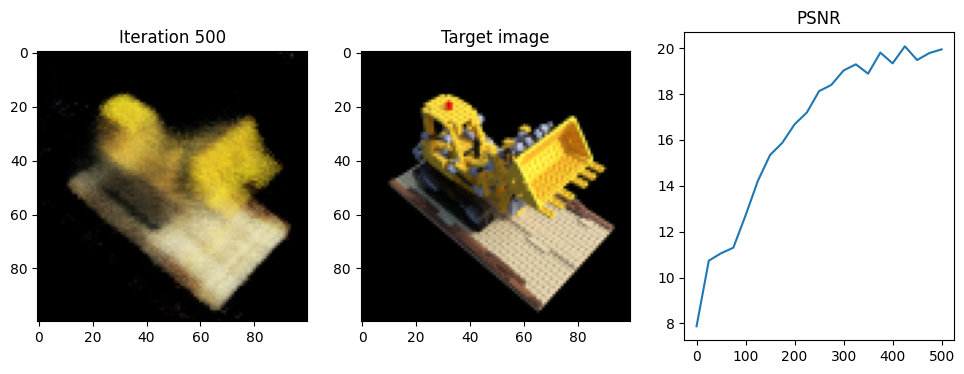

tensor([[-0.1679,  0.6262,  0.4825],
        [-0.1510,  0.6134,  0.4816],
        [-0.1341,  0.6007,  0.4807],
        ...,
        [-0.4302, -0.4661, -0.7267],
        [-0.4273, -0.4823, -0.7400],
        [-0.4243, -0.4984, -0.7534]], device='cuda:0')
tensor([[ 0.7981, -0.6011, -0.0416],
        [ 0.7981, -0.6011, -0.0416],
        [ 0.7981, -0.6011, -0.0416],
        ...,
        [ 0.1380, -0.7628, -0.6318],
        [ 0.1380, -0.7628, -0.6318],
        [ 0.1380, -0.7628, -0.6318]], device='cuda:0')
tensor([[-0.7315,  0.0633,  0.3375],
        [-0.7136,  0.0740,  0.3410],
        [-0.6958,  0.0848,  0.3445],
        ...,
        [ 0.4198, -0.5426, -0.6781],
        [ 0.4383, -0.5455, -0.6878],
        [ 0.4568, -0.5484, -0.6976]], device='cuda:0')
tensor([[ 0.8455,  0.5077,  0.1657],
        [ 0.8455,  0.5077,  0.1657],
        [ 0.8455,  0.5077,  0.1657],
        ...,
        [ 0.8761, -0.1365, -0.4623],
        [ 0.8761, -0.1365, -0.4623],
        [ 0.8761, -0.1365, -0.4623]], devic

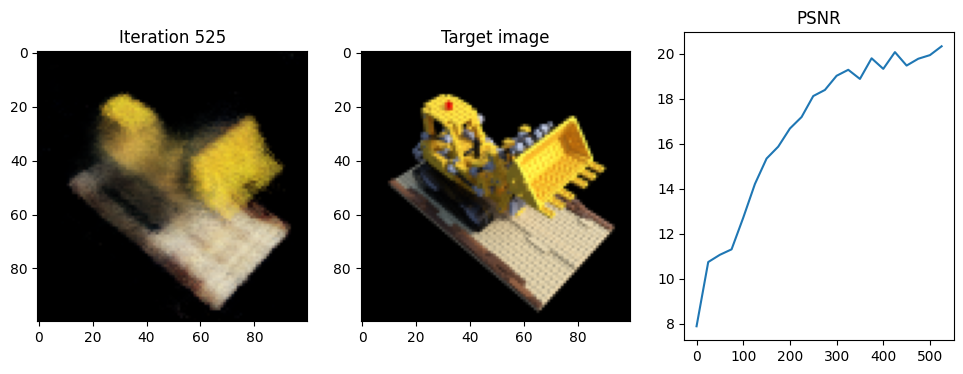

tensor([[-0.2874,  0.0875,  0.7502],
        [-0.2768,  0.1010,  0.7377],
        [-0.2663,  0.1144,  0.7252],
        ...,
        [ 0.0204, -0.6921, -0.6716],
        [ 0.0273, -0.6959, -0.6912],
        [ 0.0342, -0.6998, -0.7108]], device='cuda:0')
tensor([[ 0.4979,  0.6352, -0.5904],
        [ 0.4979,  0.6352, -0.5904],
        [ 0.4979,  0.6352, -0.5904],
        ...,
        [ 0.3269, -0.1818, -0.9274],
        [ 0.3269, -0.1818, -0.9274],
        [ 0.3269, -0.1818, -0.9274]], device='cuda:0')
tensor([[ 0.2113,  0.3496,  0.6972],
        [ 0.2182,  0.3319,  0.6879],
        [ 0.2252,  0.3143,  0.6786],
        ...,
        [-0.6194,  0.1757, -0.7182],
        [-0.6260,  0.1678, -0.7367],
        [-0.6326,  0.1599, -0.7552]], device='cuda:0')
tensor([[ 0.3272, -0.8358, -0.4409],
        [ 0.3272, -0.8358, -0.4409],
        [ 0.3272, -0.8358, -0.4409],
        ...,
        [-0.3128, -0.3736, -0.8732],
        [-0.3128, -0.3736, -0.8732],
        [-0.3128, -0.3736, -0.8732]], devic

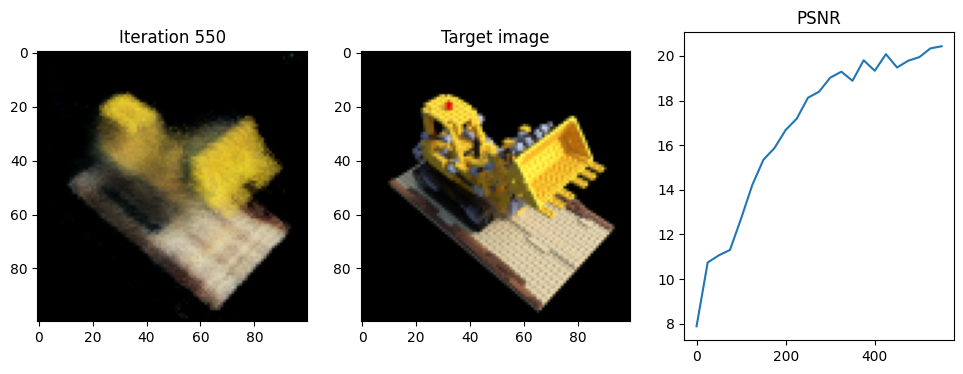

tensor([[ 0.0786, -0.2004,  0.7789],
        [ 0.0719, -0.2116,  0.7623],
        [ 0.0651, -0.2228,  0.7457],
        ...,
        [ 0.1555,  0.7788, -0.5475],
        [ 0.1540,  0.7855, -0.5675],
        [ 0.1525,  0.7923, -0.5875]], device='cuda:0')
tensor([[-0.3210, -0.5300, -0.7849],
        [-0.3210, -0.5300, -0.7849],
        [-0.3210, -0.5300, -0.7849],
        ...,
        [-0.0701,  0.3196, -0.9450],
        [-0.0701,  0.3196, -0.9450],
        [-0.0701,  0.3196, -0.9450]], device='cuda:0')
tensor([[-0.2644, -0.5968,  0.4764],
        [-0.2695, -0.5763,  0.4757],
        [-0.2746, -0.5557,  0.4751],
        ...,
        [ 0.6283,  0.0982, -0.7252],
        [ 0.6362,  0.1127, -0.7384],
        [ 0.6441,  0.1272, -0.7517]], device='cuda:0')
tensor([[-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        ...,
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248]], devic

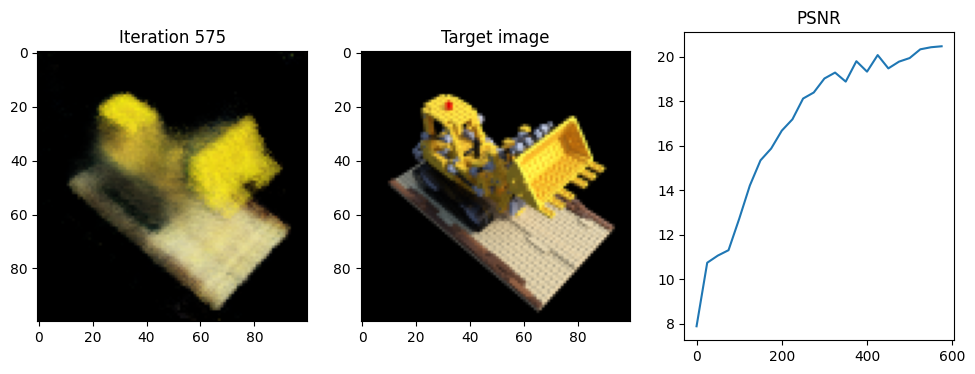

tensor([[ 0.2185, -0.6362,  0.4478],
        [ 0.2009, -0.6244,  0.4481],
        [ 0.1833, -0.6127,  0.4483],
        ...,
        [ 0.3790,  0.5213, -0.7176],
        [ 0.3747,  0.5378, -0.7302],
        [ 0.3705,  0.5543, -0.7427]], device='cuda:0')
tensor([[-0.8311,  0.5561,  0.0109],
        [-0.8311,  0.5561,  0.0109],
        [-0.8311,  0.5561,  0.0109],
        ...,
        [-0.2011,  0.7807, -0.5916],
        [-0.2011,  0.7807, -0.5916],
        [-0.2011,  0.7807, -0.5916]], device='cuda:0')
tensor([[-0.2874,  0.0875,  0.7502],
        [-0.2768,  0.1010,  0.7377],
        [-0.2663,  0.1144,  0.7252],
        ...,
        [ 0.0204, -0.6921, -0.6716],
        [ 0.0273, -0.6959, -0.6912],
        [ 0.0342, -0.6998, -0.7108]], device='cuda:0')
tensor([[ 0.4979,  0.6352, -0.5904],
        [ 0.4979,  0.6352, -0.5904],
        [ 0.4979,  0.6352, -0.5904],
        ...,
        [ 0.3269, -0.1818, -0.9274],
        [ 0.3269, -0.1818, -0.9274],
        [ 0.3269, -0.1818, -0.9274]], devic

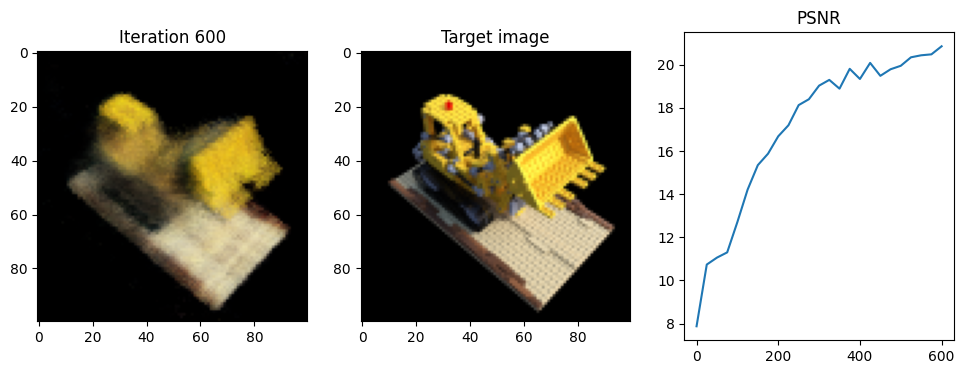

tensor([[ 0.3633,  0.6349,  0.3435],
        [ 0.3656,  0.6141,  0.3468],
        [ 0.3678,  0.5933,  0.3501],
        ...,
        [-0.6673, -0.1481, -0.6806],
        [-0.6776, -0.1637, -0.6905],
        [-0.6880, -0.1792, -0.7004]], device='cuda:0')
tensor([[ 0.1064, -0.9817,  0.1577],
        [ 0.1064, -0.9817,  0.1577],
        [ 0.1064, -0.9817,  0.1577],
        ...,
        [-0.4902, -0.7345, -0.4694],
        [-0.4902, -0.7345, -0.4694],
        [-0.4902, -0.7345, -0.4694]], device='cuda:0')
tensor([[-0.2644, -0.5968,  0.4764],
        [-0.2695, -0.5763,  0.4757],
        [-0.2746, -0.5557,  0.4751],
        ...,
        [ 0.6283,  0.0982, -0.7252],
        [ 0.6362,  0.1127, -0.7384],
        [ 0.6441,  0.1272, -0.7517]], device='cuda:0')
tensor([[-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        ...,
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248]], devic

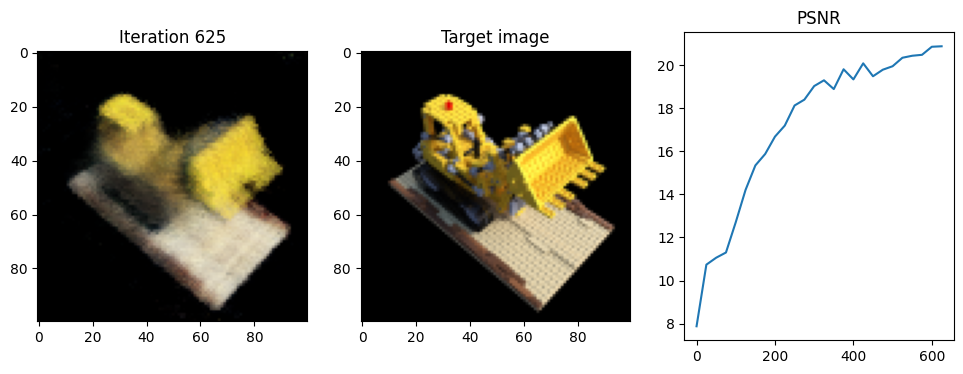

tensor([[-0.0299, -0.6820,  0.4324],
        [-0.0419, -0.6646,  0.4332],
        [-0.0539, -0.6471,  0.4339],
        ...,
        [ 0.5405,  0.3603, -0.7131],
        [ 0.5426,  0.3775, -0.7252],
        [ 0.5447,  0.3947, -0.7373]], device='cuda:0')
tensor([[-0.5658,  0.8239,  0.0336],
        [-0.5658,  0.8239,  0.0336],
        [-0.5658,  0.8239,  0.0336],
        ...,
        [ 0.0986,  0.8131, -0.5737],
        [ 0.0986,  0.8131, -0.5737],
        [ 0.0986,  0.8131, -0.5737]], device='cuda:0')
tensor([[ 0.0350,  0.2122,  0.7790],
        [ 0.0485,  0.2156,  0.7630],
        [ 0.0620,  0.2190,  0.7471],
        ...,
        [-0.6117, -0.4746, -0.5753],
        [-0.6141, -0.4808, -0.5954],
        [-0.6165, -0.4871, -0.6154]], device='cuda:0')
tensor([[ 0.6384,  0.1594, -0.7531],
        [ 0.6384,  0.1594, -0.7531],
        [ 0.6384,  0.1594, -0.7531],
        ...,
        [-0.1128, -0.2965, -0.9483],
        [-0.1128, -0.2965, -0.9483],
        [-0.1128, -0.2965, -0.9483]], devic

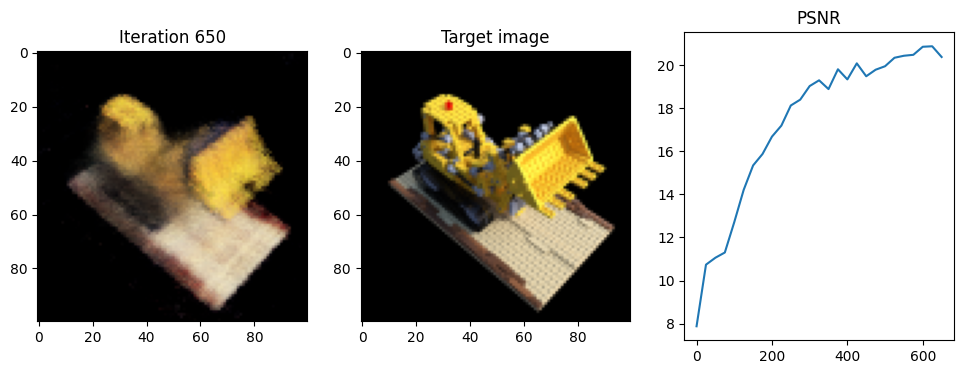

tensor([[ 0.0615, -0.4058,  0.6961],
        [ 0.0448, -0.3966,  0.6868],
        [ 0.0282, -0.3873,  0.6776],
        ...,
        [ 0.5878,  0.2611, -0.7188],
        [ 0.5878,  0.2715, -0.7373],
        [ 0.5878,  0.2818, -0.7557]], device='cuda:0')
tensor([[-0.7858,  0.4366, -0.4381],
        [-0.7858,  0.4366, -0.4381],
        [-0.7858,  0.4366, -0.4381],
        ...,
        [ 0.0011,  0.4894, -0.8720],
        [ 0.0011,  0.4894, -0.8720],
        [ 0.0011,  0.4894, -0.8720]], device='cuda:0')
tensor([[ 0.5135,  0.0252,  0.6234],
        [ 0.4997,  0.0104,  0.6175],
        [ 0.4858, -0.0045,  0.6115],
        ...,
        [-0.2413,  0.5710, -0.7390],
        [-0.2542,  0.5719, -0.7557],
        [-0.2671,  0.5727, -0.7725]], device='cuda:0')
tensor([[-0.6547, -0.7008, -0.2832],
        [-0.6547, -0.7008, -0.2832],
        [-0.6547, -0.7008, -0.2832],
        ...,
        [-0.6087,  0.0400, -0.7924],
        [-0.6087,  0.0400, -0.7924],
        [-0.6087,  0.0400, -0.7924]], devic

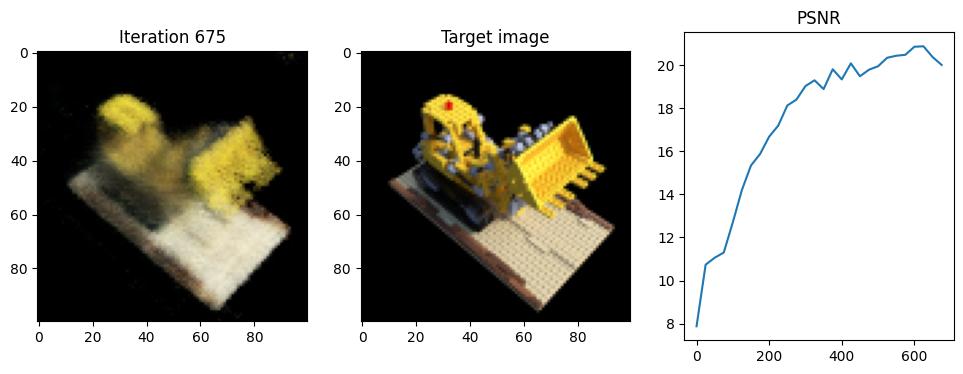

tensor([[-0.1639,  0.2248,  0.7587],
        [-0.1484,  0.2307,  0.7455],
        [-0.1329,  0.2365,  0.7324],
        ...,
        [-0.3797, -0.5951, -0.6573],
        [-0.3768, -0.6020, -0.6771],
        [-0.3738, -0.6089, -0.6969]], device='cuda:0')
tensor([[ 0.7330,  0.2748, -0.6222],
        [ 0.7330,  0.2748, -0.6222],
        [ 0.7330,  0.2748, -0.6222],
        ...,
        [ 0.1395, -0.3252, -0.9353],
        [ 0.1395, -0.3252, -0.9353],
        [ 0.1395, -0.3252, -0.9353]], device='cuda:0')
tensor([[-0.2614, -0.0530,  0.7628],
        [-0.2613, -0.0367,  0.7493],
        [-0.2611, -0.0204,  0.7358],
        ...,
        [ 0.4071, -0.5863, -0.6487],
        [ 0.4144, -0.5866, -0.6686],
        [ 0.4217, -0.5868, -0.6885]], device='cuda:0')
tensor([[ 0.0072,  0.7687, -0.6395],
        [ 0.0072,  0.7687, -0.6395],
        [ 0.0072,  0.7687, -0.6395],
        ...,
        [ 0.3439, -0.0105, -0.9389],
        [ 0.3439, -0.0105, -0.9389],
        [ 0.3439, -0.0105, -0.9389]], devic

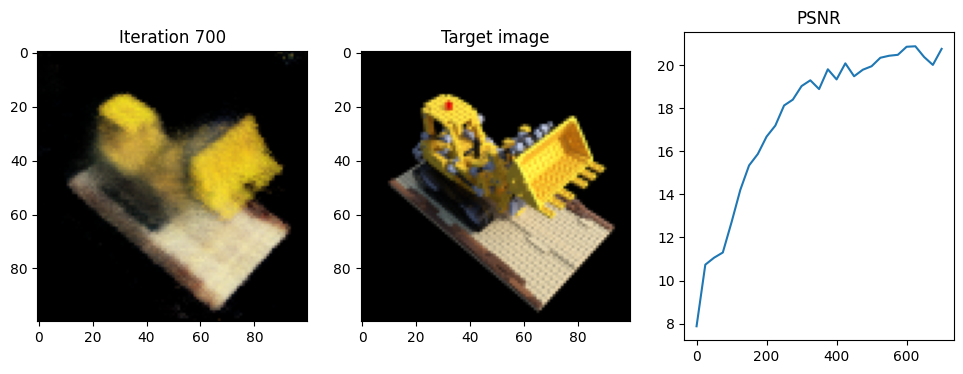

tensor([[ 0.1403, -0.3072,  0.7341],
        [ 0.1225, -0.3061,  0.7227],
        [ 0.1047, -0.3049,  0.7113],
        ...,
        [ 0.5109,  0.4377, -0.6912],
        [ 0.5089,  0.4461, -0.7105],
        [ 0.5068,  0.4546, -0.7298]], device='cuda:0')
tensor([[-0.8407,  0.0553, -0.5388],
        [-0.8407,  0.0553, -0.5388],
        [-0.8407,  0.0553, -0.5388],
        ...,
        [-0.0971,  0.3993, -0.9116],
        [-0.0971,  0.3993, -0.9116],
        [-0.0971,  0.3993, -0.9116]], device='cuda:0')
tensor([[ 0.1961, -0.7050,  0.3430],
        [ 0.1798, -0.6919,  0.3463],
        [ 0.1634, -0.6789,  0.3497],
        ...,
        [ 0.3636,  0.5791, -0.6804],
        [ 0.3598,  0.5974, -0.6903],
        [ 0.3560,  0.6157, -0.7002]], device='cuda:0')
tensor([[-0.7729,  0.6145,  0.1584],
        [-0.7729,  0.6145,  0.1584],
        [-0.7729,  0.6145,  0.1584],
        ...,
        [-0.1778,  0.8652, -0.4688],
        [-0.1778,  0.8652, -0.4688],
        [-0.1778,  0.8652, -0.4688]], devic

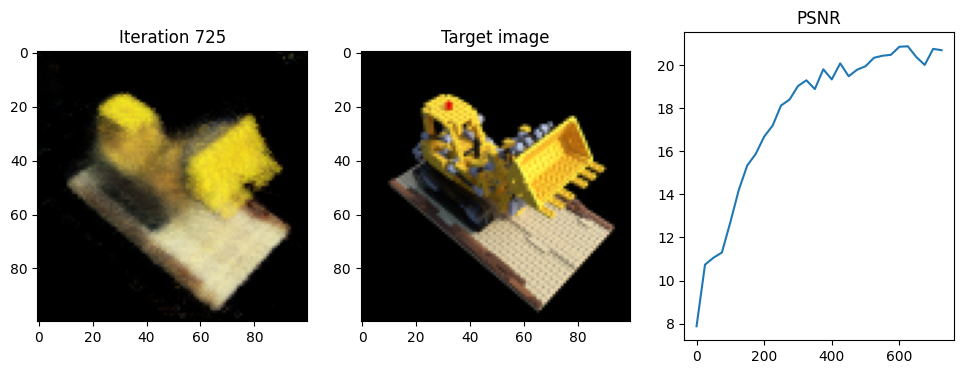

tensor([[ 0.1874, -0.1649,  0.7686],
        [ 0.1759, -0.1756,  0.7545],
        [ 0.1644, -0.1864,  0.7404],
        ...,
        [ 0.1772,  0.7051, -0.6339],
        [ 0.1731,  0.7109, -0.6538],
        [ 0.1691,  0.7166, -0.6738]], device='cuda:0')
tensor([[-0.5432, -0.5099, -0.6671],
        [-0.5432, -0.5099, -0.6671],
        [-0.5432, -0.5099, -0.6671],
        ...,
        [-0.1903,  0.2707, -0.9437],
        [-0.1903,  0.2707, -0.9437],
        [-0.1903,  0.2707, -0.9437]], device='cuda:0')
tensor([[ 0.5314, -0.0670,  0.6052],
        [ 0.5147, -0.0790,  0.5999],
        [ 0.4981, -0.0910,  0.5946],
        ...,
        [-0.1545,  0.5987, -0.7403],
        [-0.1676,  0.6018, -0.7566],
        [-0.1807,  0.6050, -0.7730]], device='cuda:0')
tensor([[-0.7866, -0.5653, -0.2485],
        [-0.7866, -0.5653, -0.2485],
        [-0.7866, -0.5653, -0.2485],
        ...,
        [-0.6184,  0.1475, -0.7719],
        [-0.6184,  0.1475, -0.7719],
        [-0.6184,  0.1475, -0.7719]], devic

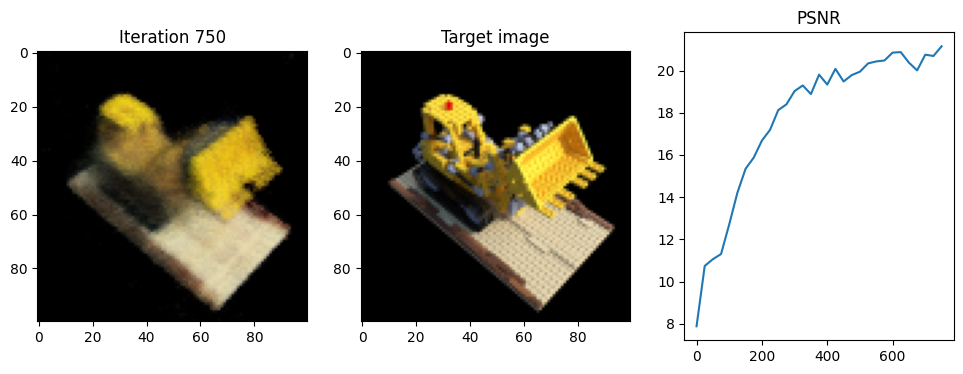

tensor([[ 0.1610,  0.2420,  0.7540],
        [ 0.1713,  0.2287,  0.7412],
        [ 0.1816,  0.2153,  0.7284],
        ...,
        [-0.6775,  0.1683, -0.6656],
        [-0.6831,  0.1630, -0.6853],
        [-0.6886,  0.1576, -0.7050]], device='cuda:0')
tensor([[ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        ...,
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310]], device='cuda:0')
tensor([[ 0.5135,  0.0252,  0.6234],
        [ 0.4997,  0.0104,  0.6175],
        [ 0.4858, -0.0045,  0.6115],
        ...,
        [-0.2413,  0.5710, -0.7390],
        [-0.2542,  0.5719, -0.7557],
        [-0.2671,  0.5727, -0.7725]], device='cuda:0')
tensor([[-0.6547, -0.7008, -0.2832],
        [-0.6547, -0.7008, -0.2832],
        [-0.6547, -0.7008, -0.2832],
        ...,
        [-0.6087,  0.0400, -0.7924],
        [-0.6087,  0.0400, -0.7924],
        [-0.6087,  0.0400, -0.7924]], devic

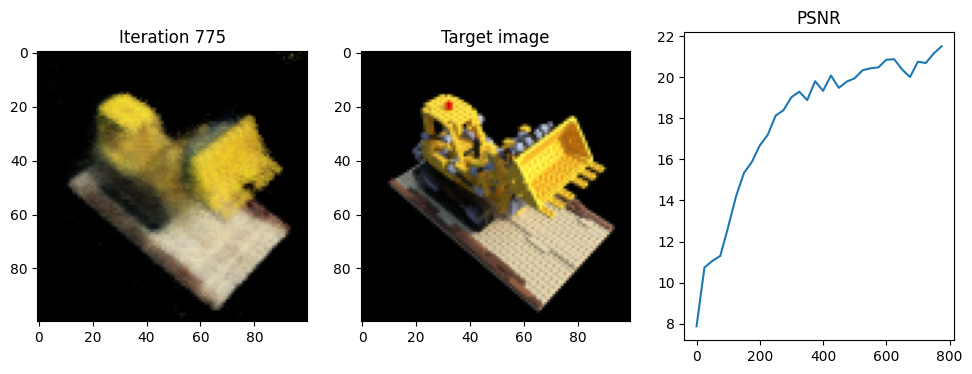

tensor([[-0.2905, -0.0283,  0.7536],
        [-0.2865, -0.0119,  0.7408],
        [-0.2825,  0.0046,  0.7281],
        ...,
        [ 0.2959, -0.6315, -0.6663],
        [ 0.3036, -0.6324, -0.6860],
        [ 0.3113, -0.6334, -0.7057]], device='cuda:0')
tensor([[ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        ...,
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306]], device='cuda:0')
tensor([[ 0.1403, -0.3072,  0.7341],
        [ 0.1225, -0.3061,  0.7227],
        [ 0.1047, -0.3049,  0.7113],
        ...,
        [ 0.5109,  0.4377, -0.6912],
        [ 0.5089,  0.4461, -0.7105],
        [ 0.5068,  0.4546, -0.7298]], device='cuda:0')
tensor([[-0.8407,  0.0553, -0.5388],
        [-0.8407,  0.0553, -0.5388],
        [-0.8407,  0.0553, -0.5388],
        ...,
        [-0.0971,  0.3993, -0.9116],
        [-0.0971,  0.3993, -0.9116],
        [-0.0971,  0.3993, -0.9116]], devic

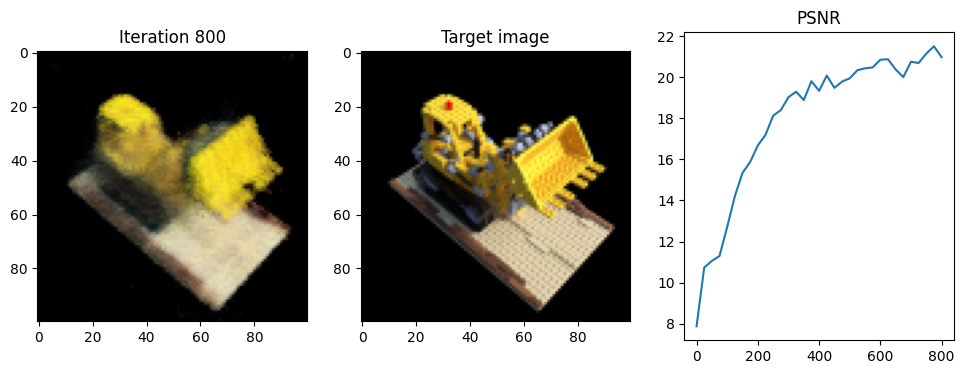

tensor([[-0.2130, -0.3744,  0.6837],
        [-0.2198, -0.3563,  0.6751],
        [-0.2267, -0.3383,  0.6664],
        ...,
        [ 0.6184, -0.1518, -0.7245],
        [ 0.6251, -0.1433, -0.7427],
        [ 0.6317, -0.1347, -0.7608]], device='cuda:0')
tensor([[-0.3231,  0.8533, -0.4092],
        [-0.3231,  0.8533, -0.4092],
        [-0.3231,  0.8533, -0.4092],
        ...,
        [ 0.3146,  0.4044, -0.8588],
        [ 0.3146,  0.4044, -0.8588],
        [ 0.3146,  0.4044, -0.8588]], device='cuda:0')
tensor([[-0.0073, -0.2157,  0.7788],
        [-0.0177, -0.2236,  0.7621],
        [-0.0281, -0.2314,  0.7454],
        ...,
        [ 0.4396,  0.6640, -0.5442],
        [ 0.4409,  0.6709, -0.5642],
        [ 0.4422,  0.6777, -0.5841]], device='cuda:0')
tensor([[-0.4911, -0.3705, -0.7884],
        [-0.4911, -0.3705, -0.7884],
        [-0.4911, -0.3705, -0.7884],
        ...,
        [ 0.0610,  0.3232, -0.9444],
        [ 0.0610,  0.3232, -0.9444],
        [ 0.0610,  0.3232, -0.9444]], devic

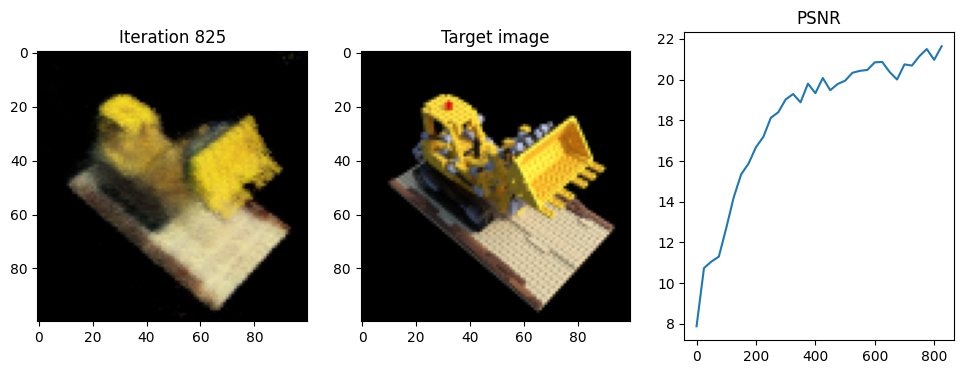

tensor([[-0.2905, -0.0283,  0.7536],
        [-0.2865, -0.0119,  0.7408],
        [-0.2825,  0.0046,  0.7281],
        ...,
        [ 0.2959, -0.6315, -0.6663],
        [ 0.3036, -0.6324, -0.6860],
        [ 0.3113, -0.6334, -0.7057]], device='cuda:0')
tensor([[ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        ...,
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306]], device='cuda:0')
tensor([[-0.6654,  0.3115,  0.3365],
        [-0.6449,  0.3155,  0.3400],
        [-0.6244,  0.3194,  0.3436],
        ...,
        [ 0.2080, -0.6541, -0.6776],
        [ 0.2245, -0.6632, -0.6874],
        [ 0.2409, -0.6723, -0.6972]], device='cuda:0')
tensor([[ 0.9684,  0.1853,  0.1670],
        [ 0.9684,  0.1853,  0.1670],
        [ 0.9684,  0.1853,  0.1670],
        ...,
        [ 0.7761, -0.4301, -0.4611],
        [ 0.7761, -0.4301, -0.4611],
        [ 0.7761, -0.4301, -0.4611]], devic

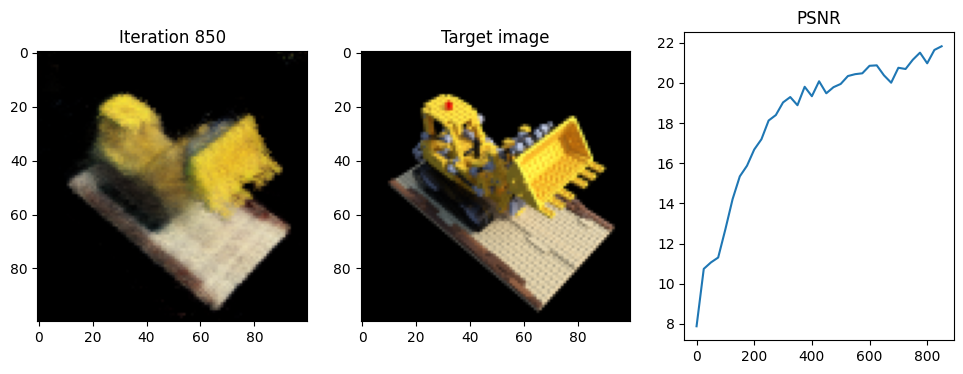

tensor([[-0.0081,  0.2179,  0.7781],
        [ 0.0054,  0.2226,  0.7625],
        [ 0.0188,  0.2274,  0.7469],
        ...,
        [-0.5417, -0.5406, -0.5871],
        [-0.5429, -0.5472, -0.6072],
        [-0.5441, -0.5537, -0.6272]], device='cuda:0')
tensor([[ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        ...,
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488]], device='cuda:0')
tensor([[-0.1828,  0.5388,  0.5739],
        [-0.1648,  0.5284,  0.5698],
        [-0.1468,  0.5179,  0.5658],
        ...,
        [-0.4512, -0.4231, -0.7401],
        [-0.4480, -0.4370, -0.7557],
        [-0.4448, -0.4510, -0.7713]], device='cuda:0')
tensor([[ 0.8492, -0.4920, -0.1920],
        [ 0.8492, -0.4920, -0.1920],
        [ 0.8492, -0.4920, -0.1920],
        ...,
        [ 0.1522, -0.6589, -0.7366],
        [ 0.1522, -0.6589, -0.7366],
        [ 0.1522, -0.6589, -0.7366]], devic

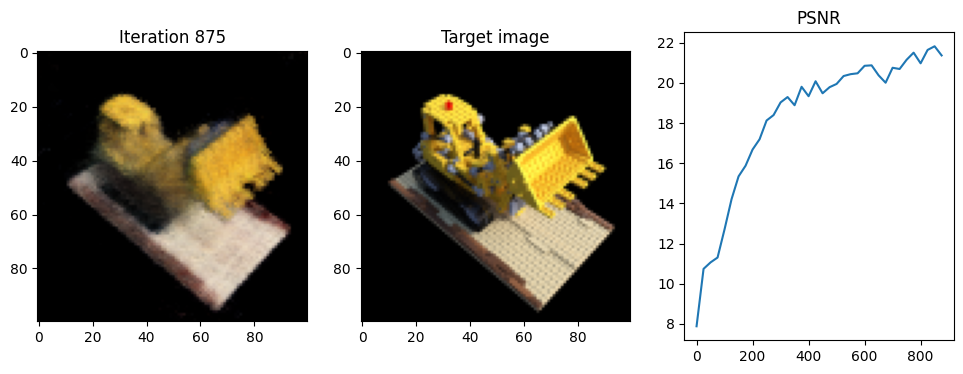

tensor([[ 0.2049,  0.6537,  0.4287],
        [ 0.2119,  0.6337,  0.4295],
        [ 0.2190,  0.6138,  0.4304],
        ...,
        [-0.6151, -0.2127, -0.7119],
        [-0.6216, -0.2289, -0.7239],
        [-0.6280, -0.2450, -0.7360]], device='cuda:0')
tensor([[ 0.3340, -0.9418,  0.0390],
        [ 0.3340, -0.9418,  0.0390],
        [ 0.3340, -0.9418,  0.0390],
        ...,
        [-0.3050, -0.7634, -0.5693],
        [-0.3050, -0.7634, -0.5693],
        [-0.3050, -0.7634, -0.5693]], device='cuda:0')
tensor([[-0.4467, -0.4113,  0.5333],
        [-0.4438, -0.3905,  0.5307],
        [-0.4409, -0.3697,  0.5281],
        ...,
        [ 0.5879, -0.2066, -0.7363],
        [ 0.6001, -0.1973, -0.7509],
        [ 0.6122, -0.1880, -0.7655]], device='cuda:0')
tensor([[ 0.1358,  0.9831, -0.1227],
        [ 0.1358,  0.9831, -0.1227],
        [ 0.1358,  0.9831, -0.1227],
        ...,
        [ 0.5747,  0.4395, -0.6903],
        [ 0.5747,  0.4395, -0.6903],
        [ 0.5747,  0.4395, -0.6903]], devic

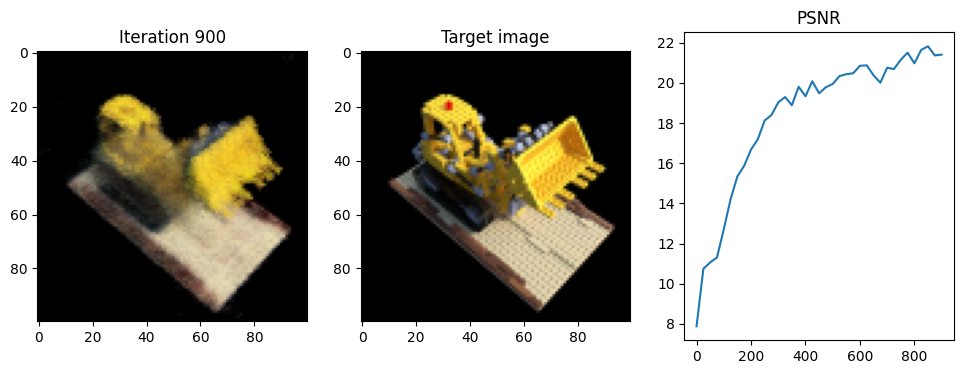

tensor([[ 0.0976, -0.3416,  0.7258],
        [ 0.0801, -0.3369,  0.7149],
        [ 0.0626, -0.3322,  0.7040],
        ...,
        [ 0.5674,  0.3462, -0.6990],
        [ 0.5665,  0.3552, -0.7181],
        [ 0.5656,  0.3642, -0.7373]], device='cuda:0')
tensor([[-0.8280,  0.2226, -0.5147],
        [-0.8280,  0.2226, -0.5147],
        [-0.8280,  0.2226, -0.5147],
        ...,
        [-0.0421,  0.4272, -0.9032],
        [-0.0421,  0.4272, -0.9032],
        [-0.0421,  0.4272, -0.9032]], device='cuda:0')
tensor([[ 0.1650, -0.4277,  0.6655],
        [ 0.1466, -0.4207,  0.6577],
        [ 0.1283, -0.4137,  0.6499],
        ...,
        [ 0.4961,  0.3874, -0.7309],
        [ 0.4934,  0.3986, -0.7486],
        [ 0.4907,  0.4098, -0.7664]], device='cuda:0')
tensor([[-0.8684,  0.3314, -0.3688],
        [-0.8684,  0.3314, -0.3688],
        [-0.8684,  0.3314, -0.3688],
        ...,
        [-0.1268,  0.5293, -0.8389],
        [-0.1268,  0.5293, -0.8389],
        [-0.1268,  0.5293, -0.8389]], devic

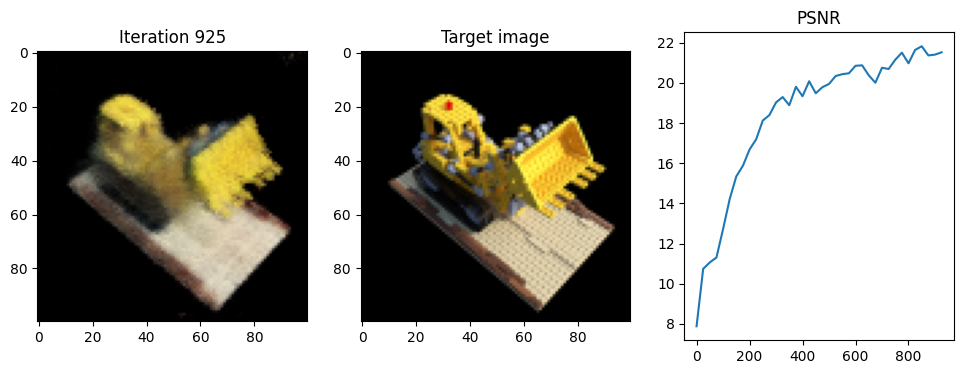

tensor([[ 0.1533,  0.4471,  0.6555],
        [ 0.1626,  0.4296,  0.6481],
        [ 0.1720,  0.4121,  0.6408],
        ...,
        [-0.6261,  0.0147, -0.7336],
        [-0.6314,  0.0041, -0.7511],
        [-0.6366, -0.0065, -0.7686]], device='cuda:0')
tensor([[ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        ...,
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279]], device='cuda:0')
tensor([[-0.2537, -0.5904,  0.4900],
        [-0.2591, -0.5700,  0.4888],
        [-0.2646, -0.5496,  0.4877],
        ...,
        [ 0.6255,  0.0926, -0.7284],
        [ 0.6332,  0.1069, -0.7419],
        [ 0.6408,  0.1213, -0.7555]], device='cuda:0')
tensor([[-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        ...,
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405]], devic

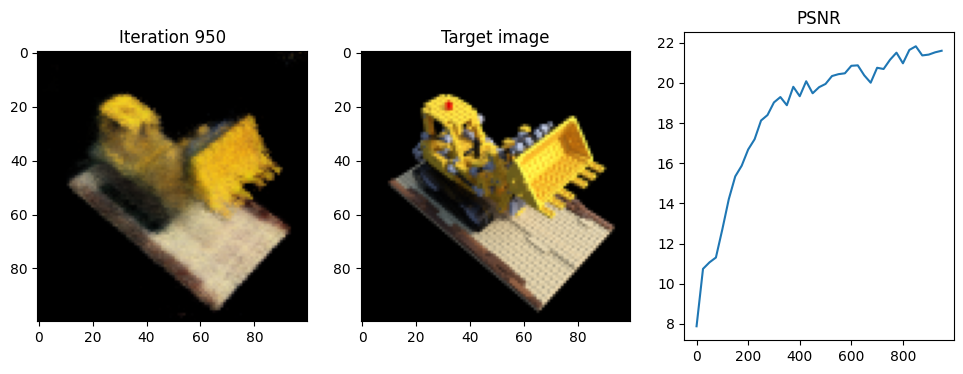

tensor([[ 0.1610,  0.2420,  0.7540],
        [ 0.1713,  0.2287,  0.7412],
        [ 0.1816,  0.2153,  0.7284],
        ...,
        [-0.6775,  0.1683, -0.6656],
        [-0.6831,  0.1630, -0.6853],
        [-0.6886,  0.1576, -0.7050]], device='cuda:0')
tensor([[ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        ...,
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310]], device='cuda:0')
tensor([[-0.2644, -0.5968,  0.4764],
        [-0.2695, -0.5763,  0.4757],
        [-0.2746, -0.5557,  0.4751],
        ...,
        [ 0.6283,  0.0982, -0.7252],
        [ 0.6362,  0.1127, -0.7384],
        [ 0.6441,  0.1272, -0.7517]], device='cuda:0')
tensor([[-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        ...,
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248]], devic

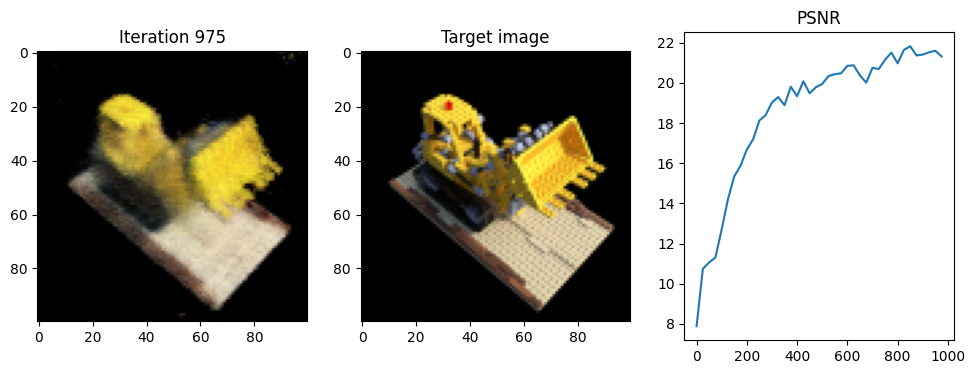

tensor([[-0.2759, -0.6663,  0.3647],
        [-0.2808, -0.6459,  0.3674],
        [-0.2858, -0.6255,  0.3701],
        ...,
        [ 0.6402,  0.2136, -0.6892],
        [ 0.6484,  0.2300, -0.6996],
        [ 0.6566,  0.2465, -0.7101]], device='cuda:0')
tensor([[-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        ...,
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943]], device='cuda:0')
tensor([[ 0.1533,  0.4471,  0.6555],
        [ 0.1626,  0.4296,  0.6481],
        [ 0.1720,  0.4121,  0.6408],
        ...,
        [-0.6261,  0.0147, -0.7336],
        [-0.6314,  0.0041, -0.7511],
        [-0.6366, -0.0065, -0.7686]], device='cuda:0')
tensor([[ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        ...,
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279]], devic

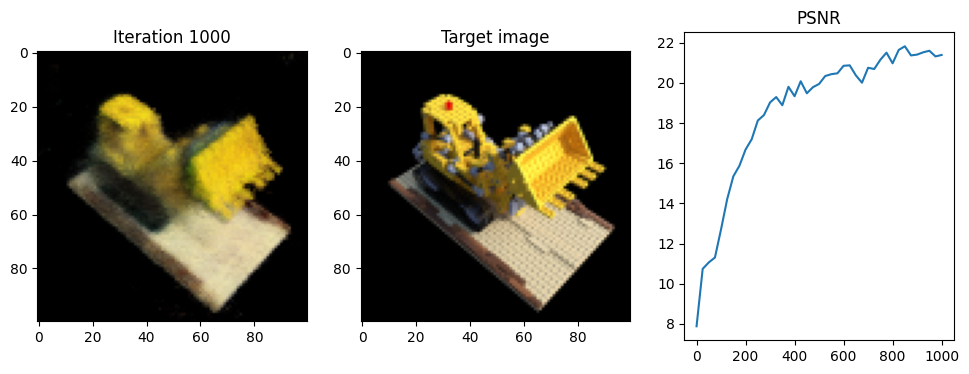

tensor([[ 0.2965,  0.6745,  0.3320],
        [ 0.3009,  0.6541,  0.3357],
        [ 0.3053,  0.6337,  0.3393],
        ...,
        [-0.6497, -0.2272, -0.6757],
        [-0.6585, -0.2439, -0.6854],
        [-0.6672, -0.2606, -0.6950]], device='cuda:0')
tensor([[ 0.2075, -0.9628,  0.1729],
        [ 0.2075, -0.9628,  0.1729],
        [ 0.2075, -0.9628,  0.1729],
        ...,
        [-0.4127, -0.7886, -0.4558],
        [-0.4127, -0.7886, -0.4558],
        [-0.4127, -0.7886, -0.4558]], device='cuda:0')
tensor([[-0.3225,  0.6429,  0.3684],
        [-0.3039,  0.6333,  0.3710],
        [-0.2852,  0.6237,  0.3736],
        ...,
        [-0.2594, -0.6214, -0.6906],
        [-0.2524, -0.6383, -0.7012],
        [-0.2453, -0.6552, -0.7117]], device='cuda:0')
tensor([[ 0.8827, -0.4533,  0.1240],
        [ 0.8827, -0.4533,  0.1240],
        [ 0.8827, -0.4533,  0.1240],
        ...,
        [ 0.3330, -0.8003, -0.4987],
        [ 0.3330, -0.8003, -0.4987],
        [ 0.3330, -0.8003, -0.4987]], devic

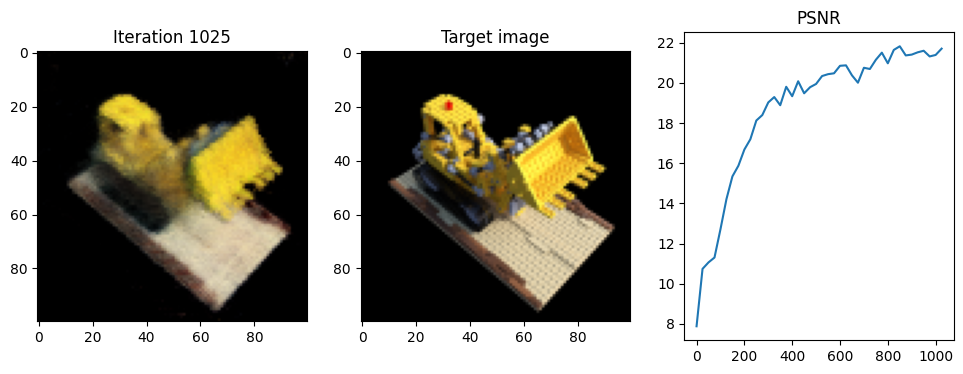

tensor([[-0.0358,  0.6754,  0.4423],
        [-0.0222,  0.6592,  0.4427],
        [-0.0085,  0.6430,  0.4431],
        ...,
        [-0.5059, -0.4022, -0.7160],
        [-0.5063, -0.4194, -0.7284],
        [-0.5067, -0.4365, -0.7408]], device='cuda:0')
tensor([[ 0.6453, -0.7637,  0.0191],
        [ 0.6453, -0.7637,  0.0191],
        [ 0.6453, -0.7637,  0.0191],
        ...,
        [-0.0203, -0.8106, -0.5852],
        [-0.0203, -0.8106, -0.5852],
        [-0.0203, -0.8106, -0.5852]], device='cuda:0')
tensor([[-0.1267,  0.2331,  0.7633],
        [-0.1293,  0.2434,  0.7450],
        [-0.1320,  0.2537,  0.7267],
        ...,
        [ 0.3093, -0.7931, -0.4535],
        [ 0.3131, -0.8007, -0.4729],
        [ 0.3170, -0.8083, -0.4923]], device='cuda:0')
tensor([[-0.1251,  0.4870, -0.8644],
        [-0.1251,  0.4870, -0.8644],
        [-0.1251,  0.4870, -0.8644],
        ...,
        [ 0.1801, -0.3582, -0.9161],
        [ 0.1801, -0.3582, -0.9161],
        [ 0.1801, -0.3582, -0.9161]], devic

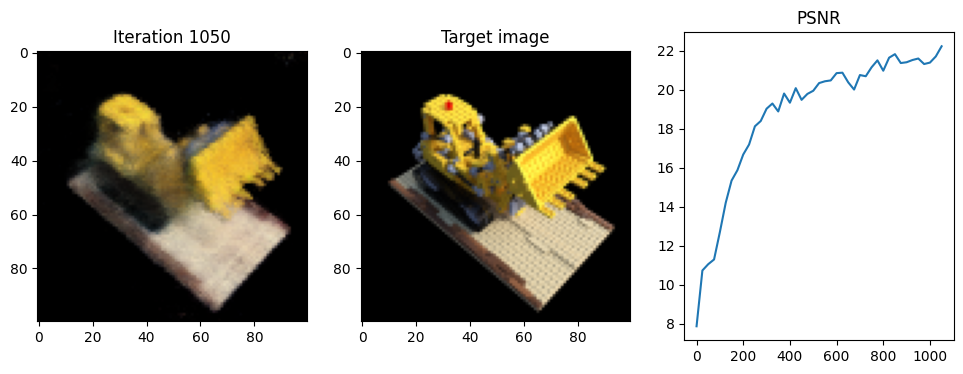

tensor([[ 0.2267, -0.1866,  0.7529],
        [ 0.2339, -0.1933,  0.7342],
        [ 0.2411, -0.1999,  0.7154],
        ...,
        [-0.6566,  0.5692, -0.4187],
        [-0.6637,  0.5751, -0.4377],
        [-0.6708,  0.5810, -0.4567]], device='cuda:0')
tensor([[ 0.3421, -0.3145, -0.8855],
        [ 0.3421, -0.3145, -0.8855],
        [ 0.3421, -0.3145, -0.8855],
        ...,
        [-0.3346,  0.2789, -0.9001],
        [-0.3346,  0.2789, -0.9001],
        [-0.3346,  0.2789, -0.9001]], device='cuda:0')
tensor([[ 0.1789,  0.1363,  0.7762],
        [ 0.1911,  0.1360,  0.7589],
        [ 0.2034,  0.1358,  0.7417],
        ...,
        [-0.7880, -0.2052, -0.5170],
        [-0.7943, -0.2090, -0.5369],
        [-0.8006, -0.2128, -0.5567]], device='cuda:0')
tensor([[ 0.5795, -0.0118, -0.8149],
        [ 0.5795, -0.0118, -0.8149],
        [ 0.5795, -0.0118, -0.8149],
        ...,
        [-0.2965, -0.1785, -0.9382],
        [-0.2965, -0.1785, -0.9382],
        [-0.2965, -0.1785, -0.9382]], devic

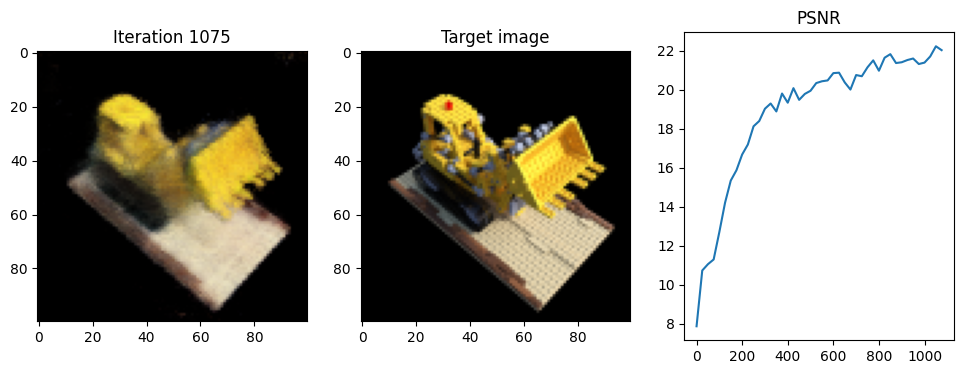

tensor([[-0.7369,  0.0438,  0.3288],
        [-0.7193,  0.0550,  0.3325],
        [-0.7018,  0.0662,  0.3363],
        ...,
        [ 0.4415, -0.5299, -0.6743],
        [ 0.4602, -0.5323, -0.6839],
        [ 0.4789, -0.5347, -0.6935]], device='cuda:0')
tensor([[ 0.8303,  0.5284,  0.1772],
        [ 0.8303,  0.5284,  0.1772],
        [ 0.8303,  0.5284,  0.1772],
        ...,
        [ 0.8848, -0.1130, -0.4520],
        [ 0.8848, -0.1130, -0.4520],
        [ 0.8848, -0.1130, -0.4520]], device='cuda:0')
tensor([[ 0.3393, -0.4582,  0.5727],
        [ 0.3190, -0.4538,  0.5687],
        [ 0.2987, -0.4493,  0.5647],
        ...,
        [ 0.2995,  0.5413, -0.7401],
        [ 0.2921,  0.5536, -0.7556],
        [ 0.2848,  0.5659, -0.7712]], device='cuda:0')
tensor([[-0.9590,  0.2102, -0.1898],
        [-0.9590,  0.2102, -0.1898],
        [-0.9590,  0.2102, -0.1898],
        ...,
        [-0.3471,  0.5822, -0.7353],
        [-0.3471,  0.5822, -0.7353],
        [-0.3471,  0.5822, -0.7353]], devic

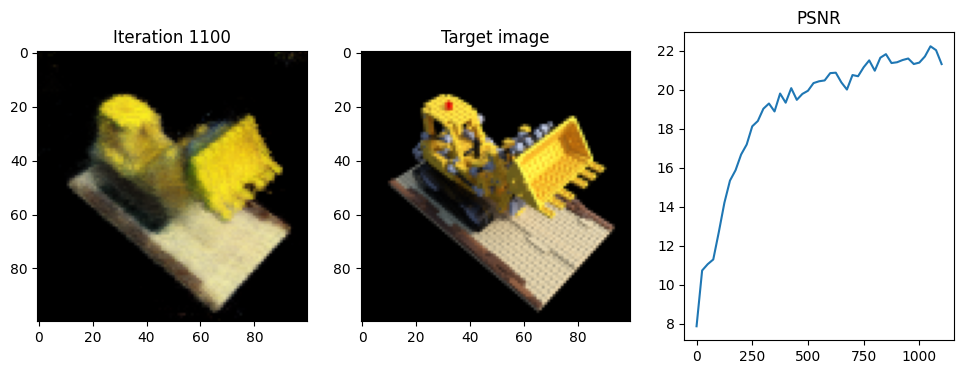

tensor([[-0.0081,  0.2179,  0.7781],
        [ 0.0054,  0.2226,  0.7625],
        [ 0.0188,  0.2274,  0.7469],
        ...,
        [-0.5417, -0.5406, -0.5871],
        [-0.5429, -0.5472, -0.6072],
        [-0.5441, -0.5537, -0.6272]], device='cuda:0')
tensor([[ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        ...,
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488]], device='cuda:0')
tensor([[-0.3453,  0.4308,  0.5901],
        [-0.3249,  0.4275,  0.5854],
        [-0.3045,  0.4242,  0.5808],
        ...,
        [-0.2931, -0.5441, -0.7406],
        [-0.2856, -0.5558, -0.7565],
        [-0.2781, -0.5674, -0.7725]], device='cuda:0')
tensor([[ 0.9625, -0.1574, -0.2209],
        [ 0.9625, -0.1574, -0.2209],
        [ 0.9625, -0.1574, -0.2209],
        ...,
        [ 0.3546, -0.5516, -0.7550],
        [ 0.3546, -0.5516, -0.7550],
        [ 0.3546, -0.5516, -0.7550]], devic

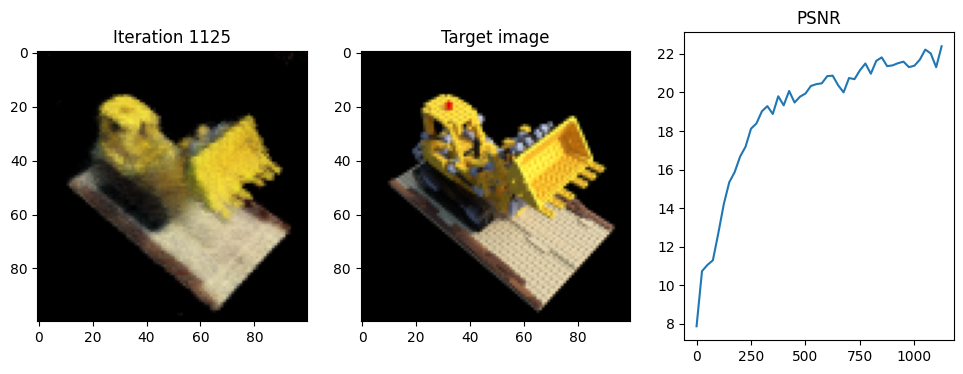

tensor([[-0.1828,  0.5388,  0.5739],
        [-0.1648,  0.5284,  0.5698],
        [-0.1468,  0.5179,  0.5658],
        ...,
        [-0.4512, -0.4231, -0.7401],
        [-0.4480, -0.4370, -0.7557],
        [-0.4448, -0.4510, -0.7713]], device='cuda:0')
tensor([[ 0.8492, -0.4920, -0.1920],
        [ 0.8492, -0.4920, -0.1920],
        [ 0.8492, -0.4920, -0.1920],
        ...,
        [ 0.1522, -0.6589, -0.7366],
        [ 0.1522, -0.6589, -0.7366],
        [ 0.1522, -0.6589, -0.7366]], device='cuda:0')
tensor([[-0.2537, -0.5904,  0.4900],
        [-0.2591, -0.5700,  0.4888],
        [-0.2646, -0.5496,  0.4877],
        ...,
        [ 0.6255,  0.0926, -0.7284],
        [ 0.6332,  0.1069, -0.7419],
        [ 0.6408,  0.1213, -0.7555]], device='cuda:0')
tensor([[-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        ...,
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405]], devic

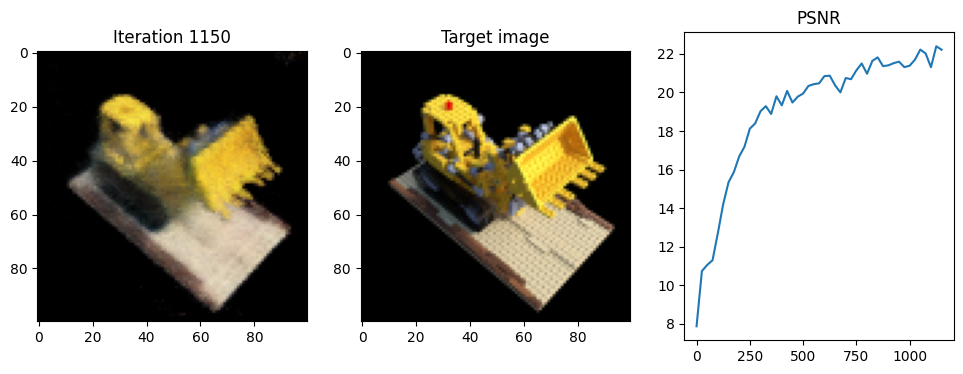

tensor([[ 0.2185, -0.6362,  0.4478],
        [ 0.2009, -0.6244,  0.4481],
        [ 0.1833, -0.6127,  0.4483],
        ...,
        [ 0.3790,  0.5213, -0.7176],
        [ 0.3747,  0.5378, -0.7302],
        [ 0.3705,  0.5543, -0.7427]], device='cuda:0')
tensor([[-0.8311,  0.5561,  0.0109],
        [-0.8311,  0.5561,  0.0109],
        [-0.8311,  0.5561,  0.0109],
        ...,
        [-0.2011,  0.7807, -0.5916],
        [-0.2011,  0.7807, -0.5916],
        [-0.2011,  0.7807, -0.5916]], device='cuda:0')
tensor([[-0.1679,  0.6262,  0.4825],
        [-0.1510,  0.6134,  0.4816],
        [-0.1341,  0.6007,  0.4807],
        ...,
        [-0.4302, -0.4661, -0.7267],
        [-0.4273, -0.4823, -0.7400],
        [-0.4243, -0.4984, -0.7534]], device='cuda:0')
tensor([[ 0.7981, -0.6011, -0.0416],
        [ 0.7981, -0.6011, -0.0416],
        [ 0.7981, -0.6011, -0.0416],
        ...,
        [ 0.1380, -0.7628, -0.6318],
        [ 0.1380, -0.7628, -0.6318],
        [ 0.1380, -0.7628, -0.6318]], devic

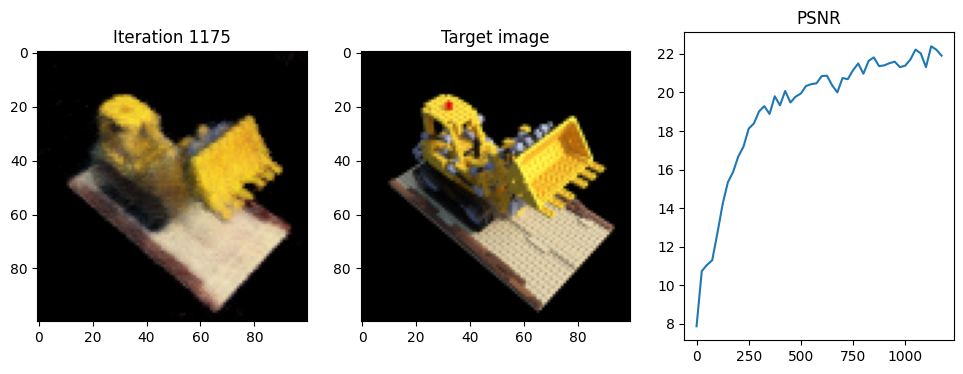

tensor([[ 0.2001, -0.1635,  0.7657],
        [ 0.1882, -0.1741,  0.7519],
        [ 0.1762, -0.1848,  0.7381],
        ...,
        [ 0.1766,  0.6980, -0.6419],
        [ 0.1723,  0.7036, -0.6618],
        [ 0.1679,  0.7093, -0.6817]], device='cuda:0')
tensor([[-0.5657, -0.5042, -0.6526],
        [-0.5657, -0.5042, -0.6526],
        [-0.5657, -0.5042, -0.6526],
        ...,
        [-0.2047,  0.2682, -0.9413],
        [-0.2047,  0.2682, -0.9413],
        [-0.2047,  0.2682, -0.9413]], device='cuda:0')
tensor([[-0.2759, -0.6663,  0.3647],
        [-0.2808, -0.6459,  0.3674],
        [-0.2858, -0.6255,  0.3701],
        ...,
        [ 0.6402,  0.2136, -0.6892],
        [ 0.6484,  0.2300, -0.6996],
        [ 0.6566,  0.2465, -0.7101]], device='cuda:0')
tensor([[-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        ...,
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943]], devic

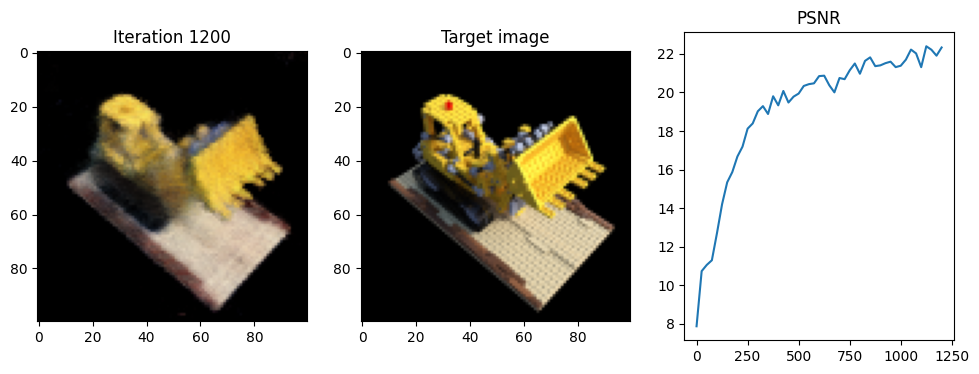

tensor([[ 0.1789,  0.1363,  0.7762],
        [ 0.1911,  0.1360,  0.7589],
        [ 0.2034,  0.1358,  0.7417],
        ...,
        [-0.7880, -0.2052, -0.5170],
        [-0.7943, -0.2090, -0.5369],
        [-0.8006, -0.2128, -0.5567]], device='cuda:0')
tensor([[ 0.5795, -0.0118, -0.8149],
        [ 0.5795, -0.0118, -0.8149],
        [ 0.5795, -0.0118, -0.8149],
        ...,
        [-0.2965, -0.1785, -0.9382],
        [-0.2965, -0.1785, -0.9382],
        [-0.2965, -0.1785, -0.9382]], device='cuda:0')
tensor([[-0.3644,  0.2603,  0.6727],
        [-0.3454,  0.2648,  0.6645],
        [-0.3264,  0.2693,  0.6564],
        ...,
        [-0.2068, -0.5973, -0.7286],
        [-0.1986, -0.6050, -0.7465],
        [-0.1904, -0.6128, -0.7645]], device='cuda:0')
tensor([[ 0.8983,  0.2130, -0.3844],
        [ 0.8983,  0.2130, -0.3844],
        [ 0.8983,  0.2130, -0.3844],
        ...,
        [ 0.3866, -0.3655, -0.8468],
        [ 0.3866, -0.3655, -0.8468],
        [ 0.3866, -0.3655, -0.8468]], devic

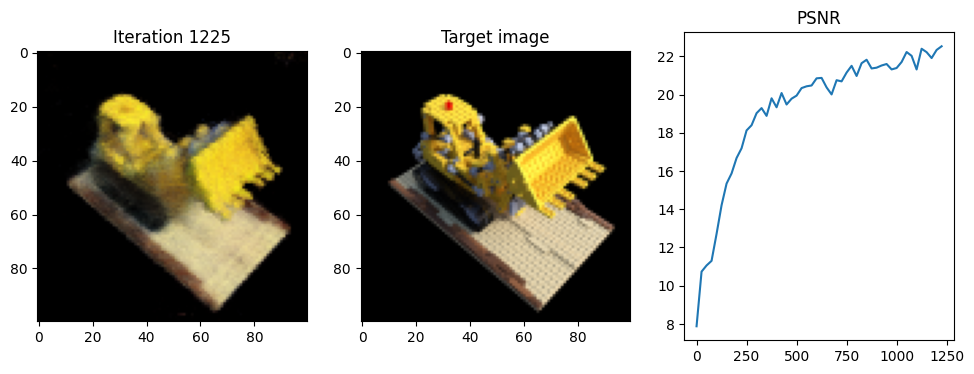

tensor([[ 0.2109,  0.5471,  0.5561],
        [ 0.2178,  0.5274,  0.5527],
        [ 0.2247,  0.5076,  0.5493],
        ...,
        [-0.6177, -0.0531, -0.7389],
        [-0.6243, -0.0663, -0.7541],
        [-0.6309, -0.0795, -0.7692]], device='cuda:0')
tensor([[ 0.3261, -0.9315, -0.1612],
        [ 0.3261, -0.9315, -0.1612],
        [ 0.3261, -0.9315, -0.1612],
        ...,
        [-0.3122, -0.6239, -0.7164],
        [-0.3122, -0.6239, -0.7164],
        [-0.3122, -0.6239, -0.7164]], device='cuda:0')
tensor([[-0.6871,  0.2139,  0.3677],
        [-0.6672,  0.2207,  0.3703],
        [-0.6474,  0.2275,  0.3730],
        ...,
        [ 0.2681, -0.6180, -0.6904],
        [ 0.2852, -0.6247, -0.7009],
        [ 0.3023, -0.6314, -0.7114]], device='cuda:0')
tensor([[ 0.9388,  0.3209,  0.1250],
        [ 0.9388,  0.3209,  0.1250],
        [ 0.9388,  0.3209,  0.1250],
        ...,
        [ 0.8078, -0.3156, -0.4979],
        [ 0.8078, -0.3156, -0.4979],
        [ 0.8078, -0.3156, -0.4979]], devic

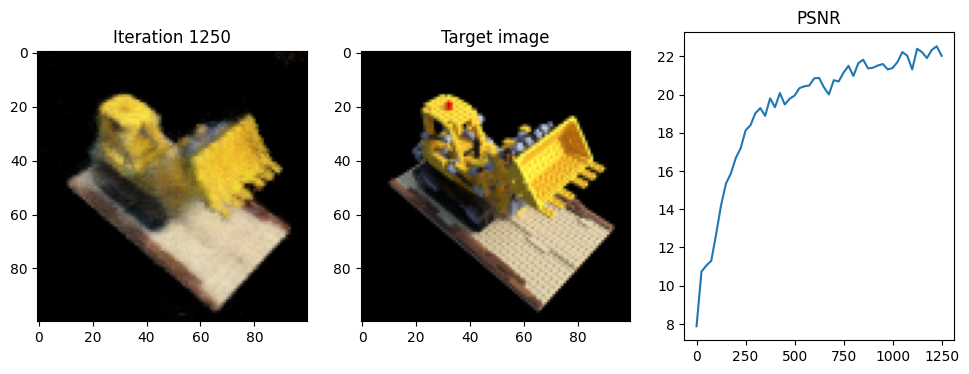

tensor([[-0.2874,  0.0875,  0.7502],
        [-0.2768,  0.1010,  0.7377],
        [-0.2663,  0.1144,  0.7252],
        ...,
        [ 0.0204, -0.6921, -0.6716],
        [ 0.0273, -0.6959, -0.6912],
        [ 0.0342, -0.6998, -0.7108]], device='cuda:0')
tensor([[ 0.4979,  0.6352, -0.5904],
        [ 0.4979,  0.6352, -0.5904],
        [ 0.4979,  0.6352, -0.5904],
        ...,
        [ 0.3269, -0.1818, -0.9274],
        [ 0.3269, -0.1818, -0.9274],
        [ 0.3269, -0.1818, -0.9274]], device='cuda:0')
tensor([[ 0.2204,  0.1682,  0.7591],
        [ 0.2266,  0.1529,  0.7459],
        [ 0.2329,  0.1376,  0.7327],
        ...,
        [-0.6048,  0.3653, -0.6566],
        [-0.6116,  0.3623, -0.6764],
        [-0.6184,  0.3592, -0.6962]], device='cuda:0')
tensor([[ 0.2940, -0.7243, -0.6237],
        [ 0.2940, -0.7243, -0.6237],
        [ 0.2940, -0.7243, -0.6237],
        ...,
        [-0.3214, -0.1461, -0.9356],
        [-0.3214, -0.1461, -0.9356],
        [-0.3214, -0.1461, -0.9356]], devic

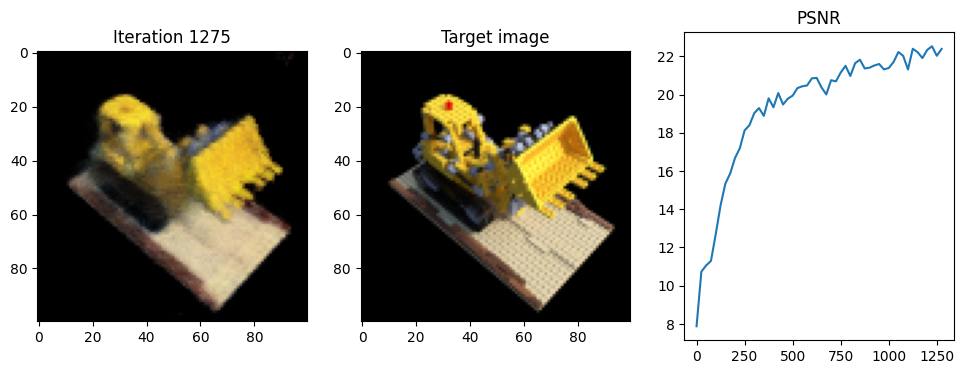

tensor([[ 0.4143, -0.5436,  0.4312],
        [ 0.3940, -0.5378,  0.4319],
        [ 0.3736, -0.5321,  0.4327],
        ...,
        [ 0.1834,  0.6236, -0.7127],
        [ 0.1740,  0.6381, -0.7248],
        [ 0.1646,  0.6527, -0.7369]], device='cuda:0')
tensor([[-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        ...,
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722]], device='cuda:0')
tensor([[ 0.0630,  0.7312,  0.3383],
        [ 0.0738,  0.7133,  0.3418],
        [ 0.0845,  0.6954,  0.3452],
        ...,
        [-0.5426, -0.4193, -0.6784],
        [-0.5454, -0.4378, -0.6882],
        [-0.5483, -0.4563, -0.6980]], device='cuda:0')
tensor([[ 0.5081, -0.8454,  0.1646],
        [ 0.5081, -0.8454,  0.1646],
        [ 0.5081, -0.8454,  0.1646],
        ...,
        [-0.1362, -0.8757, -0.4632],
        [-0.1362, -0.8757, -0.4632],
        [-0.1362, -0.8757, -0.4632]], devic

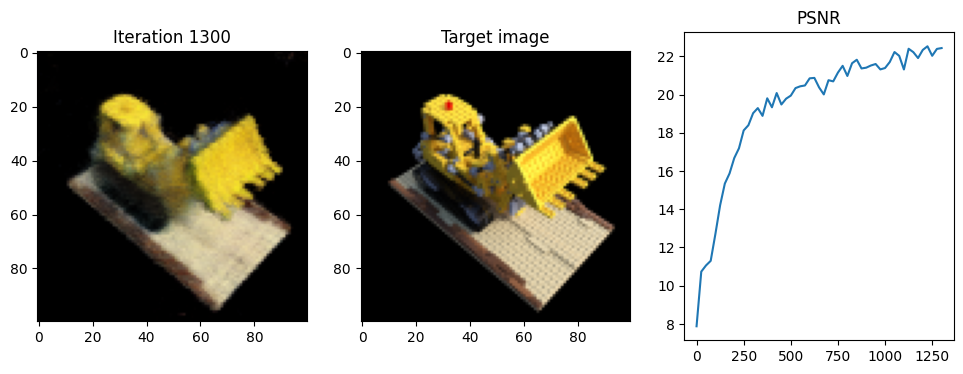

tensor([[ 0.1610,  0.2420,  0.7540],
        [ 0.1713,  0.2287,  0.7412],
        [ 0.1816,  0.2153,  0.7284],
        ...,
        [-0.6775,  0.1683, -0.6656],
        [-0.6831,  0.1630, -0.6853],
        [-0.6886,  0.1576, -0.7050]], device='cuda:0')
tensor([[ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        ...,
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310]], device='cuda:0')
tensor([[-0.0971,  0.6718,  0.4385],
        [-0.0820,  0.6569,  0.4390],
        [-0.0670,  0.6421,  0.4396],
        ...,
        [-0.4661, -0.4495, -0.7149],
        [-0.4650, -0.4667, -0.7272],
        [-0.4638, -0.4839, -0.7395]], device='cuda:0')
tensor([[ 0.7108, -0.7030,  0.0246],
        [ 0.7108, -0.7030,  0.0246],
        [ 0.7108, -0.7030,  0.0246],
        ...,
        [ 0.0536, -0.8123, -0.5808],
        [ 0.0536, -0.8123, -0.5808],
        [ 0.0536, -0.8123, -0.5808]], devic

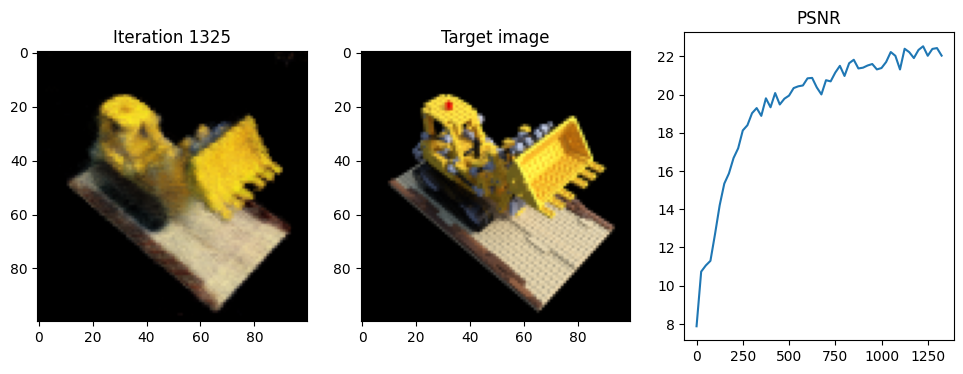

tensor([[-0.3580,  0.6105,  0.3901],
        [-0.3386,  0.6022,  0.3921],
        [-0.3193,  0.5939,  0.3940],
        ...,
        [-0.2315, -0.6233, -0.6988],
        [-0.2235, -0.6395, -0.7099],
        [-0.2155, -0.6556, -0.7210]], device='cuda:0')
tensor([[ 0.9150, -0.3924,  0.0941],
        [ 0.9150, -0.3924,  0.0941],
        [ 0.9150, -0.3924,  0.0941],
        ...,
        [ 0.3764, -0.7639, -0.5242],
        [ 0.3764, -0.7639, -0.5242],
        [ 0.3764, -0.7639, -0.5242]], device='cuda:0')
tensor([[-0.2759, -0.6663,  0.3647],
        [-0.2808, -0.6459,  0.3674],
        [-0.2858, -0.6255,  0.3701],
        ...,
        [ 0.6402,  0.2136, -0.6892],
        [ 0.6484,  0.2300, -0.6996],
        [ 0.6566,  0.2465, -0.7101]], device='cuda:0')
tensor([[-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        ...,
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943]], devic

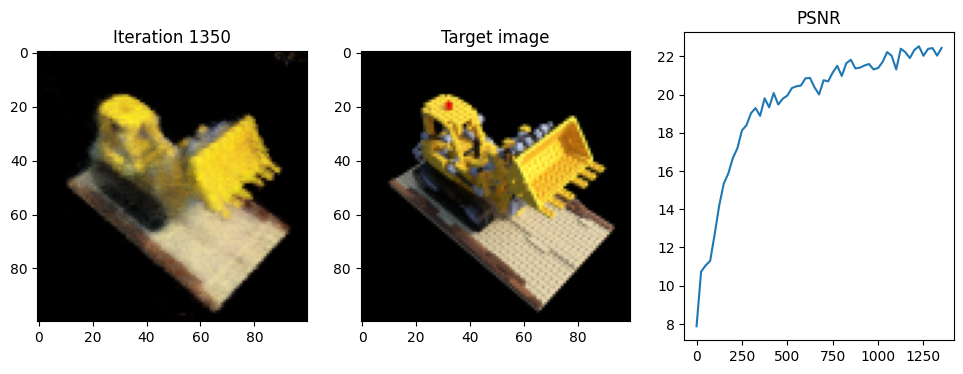

tensor([[ 0.0630,  0.7312,  0.3383],
        [ 0.0738,  0.7133,  0.3418],
        [ 0.0845,  0.6954,  0.3452],
        ...,
        [-0.5426, -0.4193, -0.6784],
        [-0.5454, -0.4378, -0.6882],
        [-0.5483, -0.4563, -0.6980]], device='cuda:0')
tensor([[ 0.5081, -0.8454,  0.1646],
        [ 0.5081, -0.8454,  0.1646],
        [ 0.5081, -0.8454,  0.1646],
        ...,
        [-0.1362, -0.8757, -0.4632],
        [-0.1362, -0.8757, -0.4632],
        [-0.1362, -0.8757, -0.4632]], device='cuda:0')
tensor([[ 0.1610,  0.2420,  0.7540],
        [ 0.1713,  0.2287,  0.7412],
        [ 0.1816,  0.2153,  0.7284],
        ...,
        [-0.6775,  0.1683, -0.6656],
        [-0.6831,  0.1630, -0.6853],
        [-0.6886,  0.1576, -0.7050]], device='cuda:0')
tensor([[ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        [ 0.4851, -0.6322, -0.6042],
        ...,
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310],
        [-0.2631, -0.2530, -0.9310]], devic

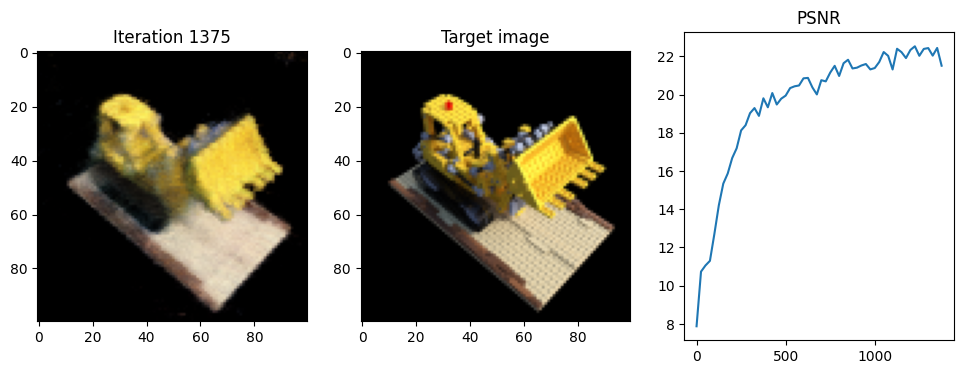

tensor([[-0.2759, -0.6663,  0.3647],
        [-0.2808, -0.6459,  0.3674],
        [-0.2858, -0.6255,  0.3701],
        ...,
        [ 0.6402,  0.2136, -0.6892],
        [ 0.6484,  0.2300, -0.6996],
        [ 0.6566,  0.2465, -0.7101]], device='cuda:0')
tensor([[-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        ...,
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943]], device='cuda:0')
tensor([[ 0.2696,  0.2243,  0.7280],
        [ 0.2726,  0.2065,  0.7170],
        [ 0.2756,  0.1887,  0.7060],
        ...,
        [-0.5483,  0.3793, -0.6971],
        [-0.5561,  0.3749, -0.7162],
        [-0.5639,  0.3705, -0.7354]], device='cuda:0')
tensor([[ 0.1399, -0.8420, -0.5210],
        [ 0.1399, -0.8420, -0.5210],
        [ 0.1399, -0.8420, -0.5210],
        ...,
        [-0.3701, -0.2077, -0.9054],
        [-0.3701, -0.2077, -0.9054],
        [-0.3701, -0.2077, -0.9054]], devic

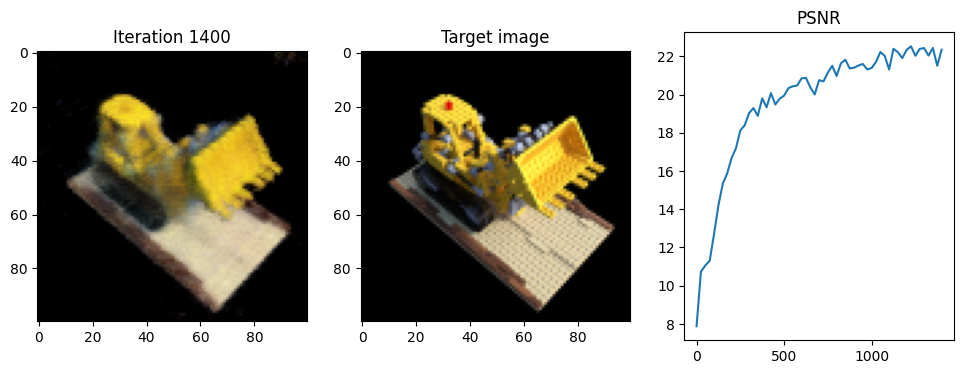

tensor([[-0.2905, -0.0283,  0.7536],
        [-0.2865, -0.0119,  0.7408],
        [-0.2825,  0.0046,  0.7281],
        ...,
        [ 0.2959, -0.6315, -0.6663],
        [ 0.3036, -0.6324, -0.6860],
        [ 0.3113, -0.6334, -0.7057]], device='cuda:0')
tensor([[ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        ...,
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306]], device='cuda:0')
tensor([[-0.5465,  0.1685,  0.5710],
        [-0.5275,  0.1769,  0.5670],
        [-0.5085,  0.1853,  0.5631],
        ...,
        [ 0.0812, -0.6134, -0.7400],
        [ 0.0945, -0.6189, -0.7555],
        [ 0.1077, -0.6245, -0.7710]], device='cuda:0')
tensor([[ 0.8981,  0.3980, -0.1869],
        [ 0.8981,  0.3980, -0.1869],
        [ 0.8981,  0.3980, -0.1869],
        ...,
        [ 0.6266, -0.2637, -0.7333],
        [ 0.6266, -0.2637, -0.7333],
        [ 0.6266, -0.2637, -0.7333]], devic

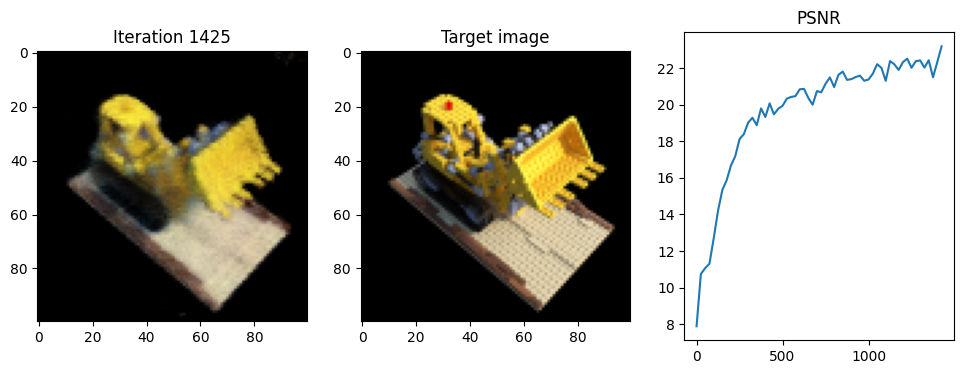

tensor([[ 0.1874, -0.1649,  0.7686],
        [ 0.1759, -0.1756,  0.7545],
        [ 0.1644, -0.1864,  0.7404],
        ...,
        [ 0.1772,  0.7051, -0.6339],
        [ 0.1731,  0.7109, -0.6538],
        [ 0.1691,  0.7166, -0.6738]], device='cuda:0')
tensor([[-0.5432, -0.5099, -0.6671],
        [-0.5432, -0.5099, -0.6671],
        [-0.5432, -0.5099, -0.6671],
        ...,
        [-0.1903,  0.2707, -0.9437],
        [-0.1903,  0.2707, -0.9437],
        [-0.1903,  0.2707, -0.9437]], device='cuda:0')
tensor([[ 0.1533,  0.4471,  0.6555],
        [ 0.1626,  0.4296,  0.6481],
        [ 0.1720,  0.4121,  0.6408],
        ...,
        [-0.6261,  0.0147, -0.7336],
        [-0.6314,  0.0041, -0.7511],
        [-0.6366, -0.0065, -0.7686]], device='cuda:0')
tensor([[ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        ...,
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279]], devic

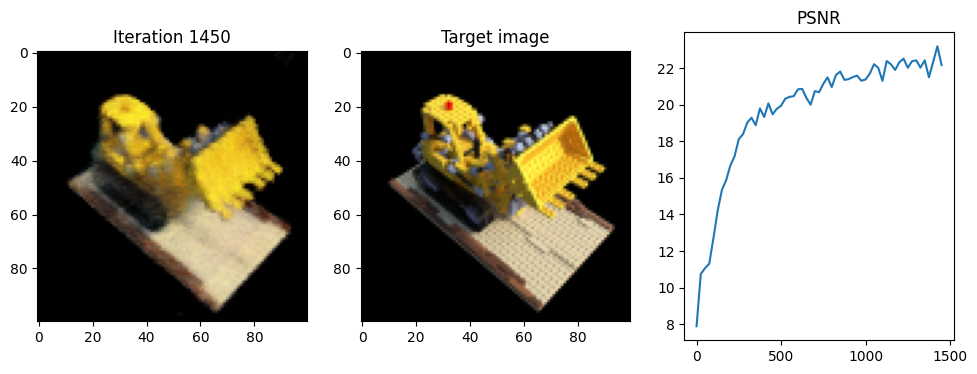

tensor([[ 0.2185, -0.6362,  0.4478],
        [ 0.2009, -0.6244,  0.4481],
        [ 0.1833, -0.6127,  0.4483],
        ...,
        [ 0.3790,  0.5213, -0.7176],
        [ 0.3747,  0.5378, -0.7302],
        [ 0.3705,  0.5543, -0.7427]], device='cuda:0')
tensor([[-0.8311,  0.5561,  0.0109],
        [-0.8311,  0.5561,  0.0109],
        [-0.8311,  0.5561,  0.0109],
        ...,
        [-0.2011,  0.7807, -0.5916],
        [-0.2011,  0.7807, -0.5916],
        [-0.2011,  0.7807, -0.5916]], device='cuda:0')
tensor([[-0.1267,  0.2331,  0.7633],
        [-0.1293,  0.2434,  0.7450],
        [-0.1320,  0.2537,  0.7267],
        ...,
        [ 0.3093, -0.7931, -0.4535],
        [ 0.3131, -0.8007, -0.4729],
        [ 0.3170, -0.8083, -0.4923]], device='cuda:0')
tensor([[-0.1251,  0.4870, -0.8644],
        [-0.1251,  0.4870, -0.8644],
        [-0.1251,  0.4870, -0.8644],
        ...,
        [ 0.1801, -0.3582, -0.9161],
        [ 0.1801, -0.3582, -0.9161],
        [ 0.1801, -0.3582, -0.9161]], devic

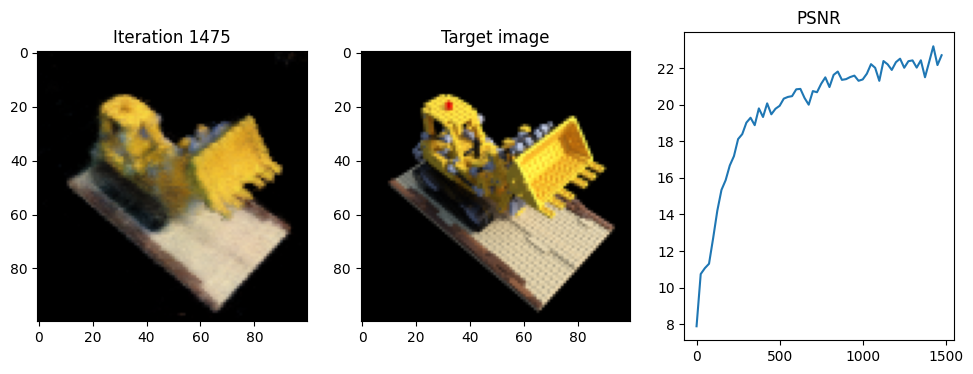

tensor([[-0.2759, -0.6663,  0.3647],
        [-0.2808, -0.6459,  0.3674],
        [-0.2858, -0.6255,  0.3701],
        ...,
        [ 0.6402,  0.2136, -0.6892],
        [ 0.6484,  0.2300, -0.6996],
        [ 0.6566,  0.2465, -0.7101]], device='cuda:0')
tensor([[-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        [-0.2339,  0.9637,  0.1291],
        ...,
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943],
        [ 0.3882,  0.7778, -0.4943]], device='cuda:0')
tensor([[-0.2614, -0.0530,  0.7628],
        [-0.2613, -0.0367,  0.7493],
        [-0.2611, -0.0204,  0.7358],
        ...,
        [ 0.4071, -0.5863, -0.6487],
        [ 0.4144, -0.5866, -0.6686],
        [ 0.4217, -0.5868, -0.6885]], device='cuda:0')
tensor([[ 0.0072,  0.7687, -0.6395],
        [ 0.0072,  0.7687, -0.6395],
        [ 0.0072,  0.7687, -0.6395],
        ...,
        [ 0.3439, -0.0105, -0.9389],
        [ 0.3439, -0.0105, -0.9389],
        [ 0.3439, -0.0105, -0.9389]], devic

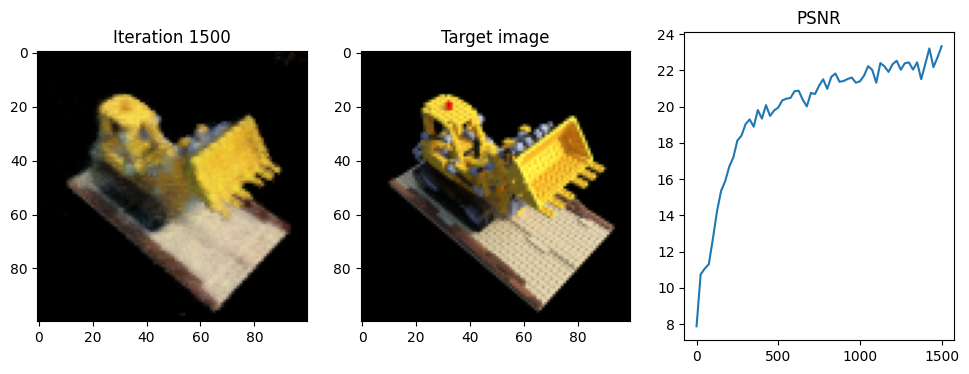

tensor([[ 0.3393, -0.4582,  0.5727],
        [ 0.3190, -0.4538,  0.5687],
        [ 0.2987, -0.4493,  0.5647],
        ...,
        [ 0.2995,  0.5413, -0.7401],
        [ 0.2921,  0.5536, -0.7556],
        [ 0.2848,  0.5659, -0.7712]], device='cuda:0')
tensor([[-0.9590,  0.2102, -0.1898],
        [-0.9590,  0.2102, -0.1898],
        [-0.9590,  0.2102, -0.1898],
        ...,
        [-0.3471,  0.5822, -0.7353],
        [-0.3471,  0.5822, -0.7353],
        [-0.3471,  0.5822, -0.7353]], device='cuda:0')
tensor([[-0.5269,  0.2599,  0.5549],
        [-0.5066,  0.2649,  0.5515],
        [-0.4864,  0.2700,  0.5482],
        ...,
        [-0.0016, -0.6201, -0.7388],
        [ 0.0110, -0.6279, -0.7539],
        [ 0.0236, -0.6357, -0.7690]], device='cuda:0')
tensor([[ 0.9576,  0.2400, -0.1590],
        [ 0.9576,  0.2400, -0.1590],
        [ 0.9576,  0.2400, -0.1590],
        ...,
        [ 0.5946, -0.3677, -0.7150],
        [ 0.5946, -0.3677, -0.7150],
        [ 0.5946, -0.3677, -0.7150]], devic

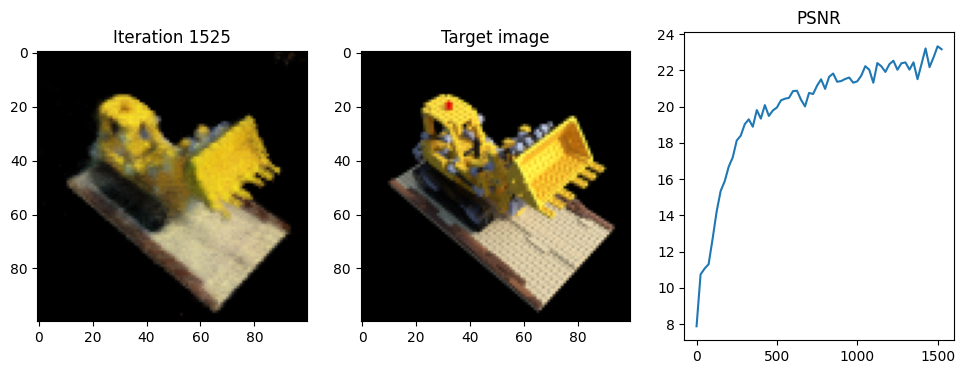

tensor([[-0.6569, -0.0859,  0.4627],
        [-0.6420, -0.0709,  0.4625],
        [-0.6270, -0.0560,  0.4622],
        ...,
        [ 0.4225, -0.4806, -0.7217],
        [ 0.4393, -0.4797, -0.7346],
        [ 0.4561, -0.4789, -0.7475]], device='cuda:0')
tensor([[ 0.7070,  0.7071, -0.0114],
        [ 0.7070,  0.7071, -0.0114],
        [ 0.7070,  0.7071, -0.0114],
        ...,
        [ 0.7923,  0.0393, -0.6089],
        [ 0.7923,  0.0393, -0.6089],
        [ 0.7923,  0.0393, -0.6089]], device='cuda:0')
tensor([[-0.2537, -0.5904,  0.4900],
        [-0.2591, -0.5700,  0.4888],
        [-0.2646, -0.5496,  0.4877],
        ...,
        [ 0.6255,  0.0926, -0.7284],
        [ 0.6332,  0.1069, -0.7419],
        [ 0.6408,  0.1213, -0.7555]], device='cuda:0')
tensor([[-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        ...,
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405]], devic

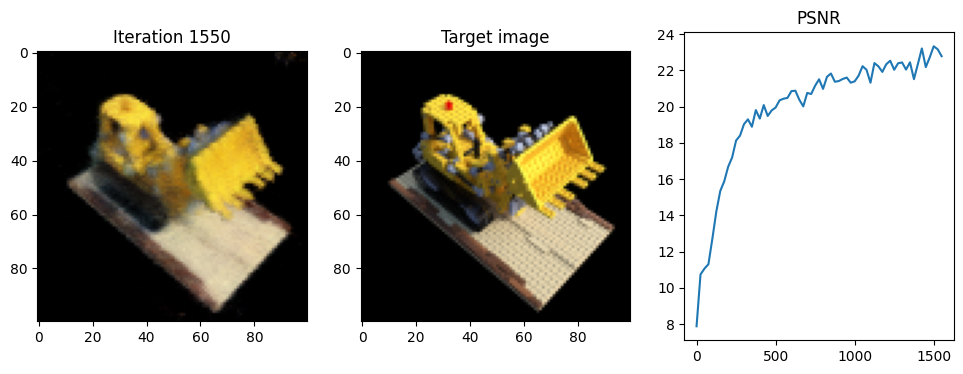

tensor([[-0.0397,  0.3443,  0.7300],
        [-0.0232,  0.3373,  0.7189],
        [-0.0066,  0.3302,  0.7077],
        ...,
        [-0.6187, -0.2534, -0.6953],
        [-0.6193, -0.2623, -0.7145],
        [-0.6199, -0.2712, -0.7337]], device='cuda:0')
tensor([[ 0.7818, -0.3338, -0.5267],
        [ 0.7818, -0.3338, -0.5267],
        [ 0.7818, -0.3338, -0.5267],
        ...,
        [-0.0294, -0.4191, -0.9075],
        [-0.0294, -0.4191, -0.9075],
        [-0.0294, -0.4191, -0.9075]], device='cuda:0')
tensor([[-0.1267,  0.2331,  0.7633],
        [-0.1293,  0.2434,  0.7450],
        [-0.1320,  0.2537,  0.7267],
        ...,
        [ 0.3093, -0.7931, -0.4535],
        [ 0.3131, -0.8007, -0.4729],
        [ 0.3170, -0.8083, -0.4923]], device='cuda:0')
tensor([[-0.1251,  0.4870, -0.8644],
        [-0.1251,  0.4870, -0.8644],
        [-0.1251,  0.4870, -0.8644],
        ...,
        [ 0.1801, -0.3582, -0.9161],
        [ 0.1801, -0.3582, -0.9161],
        [ 0.1801, -0.3582, -0.9161]], devic

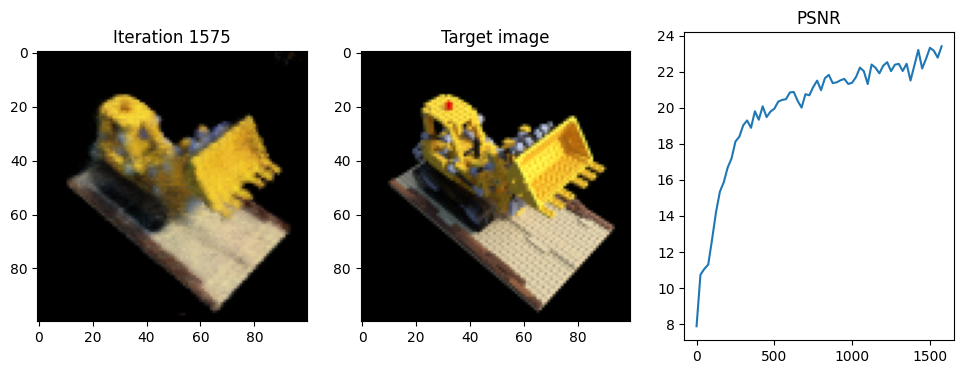

tensor([[-0.6871,  0.2139,  0.3677],
        [-0.6672,  0.2207,  0.3703],
        [-0.6474,  0.2275,  0.3730],
        ...,
        [ 0.2681, -0.6180, -0.6904],
        [ 0.2852, -0.6247, -0.7009],
        [ 0.3023, -0.6314, -0.7114]], device='cuda:0')
tensor([[ 0.9388,  0.3209,  0.1250],
        [ 0.9388,  0.3209,  0.1250],
        [ 0.9388,  0.3209,  0.1250],
        ...,
        [ 0.8078, -0.3156, -0.4979],
        [ 0.8078, -0.3156, -0.4979],
        [ 0.8078, -0.3156, -0.4979]], device='cuda:0')
tensor([[ 0.3633,  0.6349,  0.3435],
        [ 0.3656,  0.6141,  0.3468],
        [ 0.3678,  0.5933,  0.3501],
        ...,
        [-0.6673, -0.1481, -0.6806],
        [-0.6776, -0.1637, -0.6905],
        [-0.6880, -0.1792, -0.7004]], device='cuda:0')
tensor([[ 0.1064, -0.9817,  0.1577],
        [ 0.1064, -0.9817,  0.1577],
        [ 0.1064, -0.9817,  0.1577],
        ...,
        [-0.4902, -0.7345, -0.4694],
        [-0.4902, -0.7345, -0.4694],
        [-0.4902, -0.7345, -0.4694]], devic

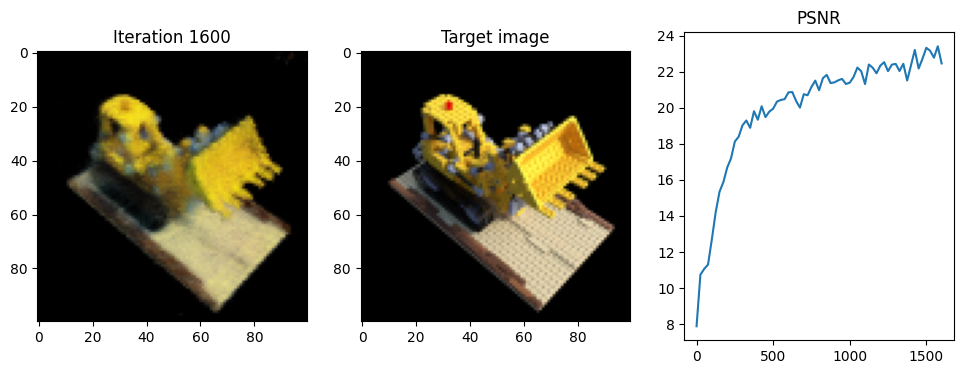

tensor([[ 0.5767, -0.3959,  0.4047],
        [ 0.5556, -0.3967,  0.4062],
        [ 0.5345, -0.3974,  0.4078],
        ...,
        [-0.0431,  0.6580, -0.7040],
        [-0.0570,  0.6691, -0.7154],
        [-0.0709,  0.6802, -0.7269]], device='cuda:0')
tensor([[-0.9966, -0.0367,  0.0735],
        [-0.9966, -0.0367,  0.0735],
        [-0.9966, -0.0367,  0.0735],
        ...,
        [-0.6562,  0.5258, -0.5413],
        [-0.6562,  0.5258, -0.5413],
        [-0.6562,  0.5258, -0.5413]], device='cuda:0')
tensor([[ 0.5413, -0.5155,  0.3070],
        [ 0.5208, -0.5127,  0.3114],
        [ 0.5003, -0.5099,  0.3157],
        ...,
        [-0.0109,  0.6989, -0.6646],
        [-0.0238,  0.7130, -0.6737],
        [-0.0368,  0.7271, -0.6827]], device='cuda:0')
tensor([[-0.9695,  0.1333,  0.2056],
        [-0.9695,  0.1333,  0.2056],
        [-0.9695,  0.1333,  0.2056],
        ...,
        [-0.6124,  0.6658, -0.4263],
        [-0.6124,  0.6658, -0.4263],
        [-0.6124,  0.6658, -0.4263]], devic

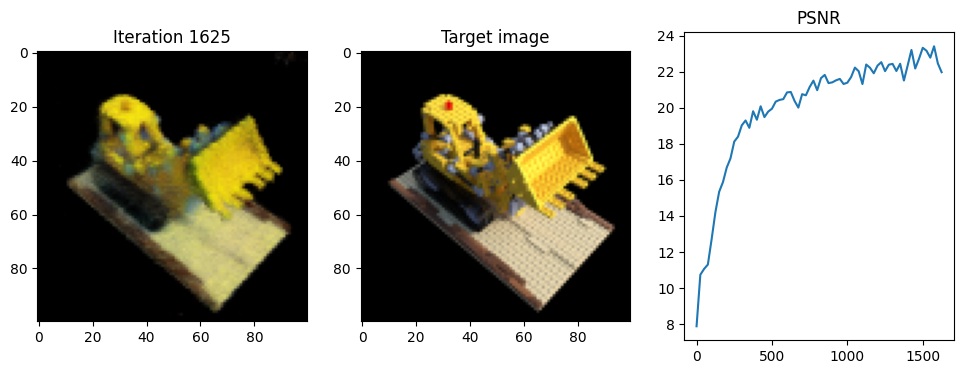

tensor([[-0.3547, -0.1633,  0.7075],
        [-0.3512, -0.1450,  0.6976],
        [-0.3477, -0.1266,  0.6878],
        ...,
        [ 0.4165, -0.4993, -0.7124],
        [ 0.4261, -0.4967, -0.7312],
        [ 0.4356, -0.4940, -0.7499]], device='cuda:0')
tensor([[ 0.1656,  0.8691, -0.4661],
        [ 0.1656,  0.8691, -0.4661],
        [ 0.1656,  0.8691, -0.4661],
        ...,
        [ 0.4504,  0.1245, -0.8841],
        [ 0.4504,  0.1245, -0.8841],
        [ 0.4504,  0.1245, -0.8841]], device='cuda:0')
tensor([[ 0.1917,  0.1007,  0.7786],
        [ 0.2021,  0.0912,  0.7628],
        [ 0.2126,  0.0817,  0.7471],
        ...,
        [-0.7331,  0.2328, -0.5820],
        [-0.7395,  0.2310, -0.6021],
        [-0.7460,  0.2292, -0.6222]], device='cuda:0')
tensor([[ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        ...,
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487]], devic

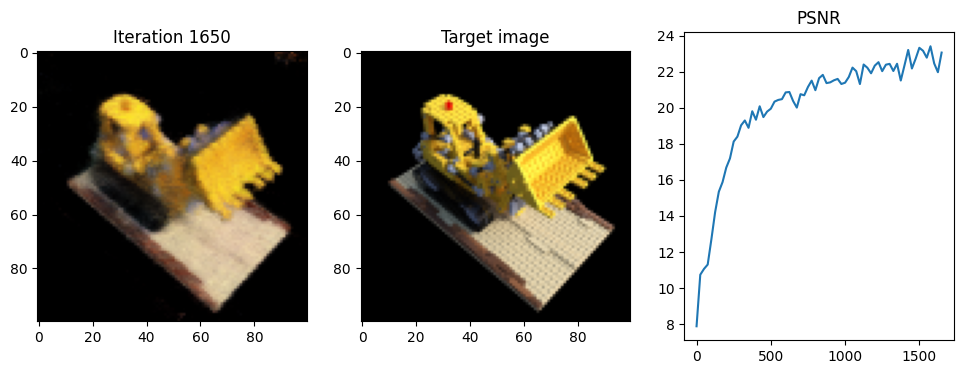

tensor([[-0.2537, -0.5904,  0.4900],
        [-0.2591, -0.5700,  0.4888],
        [-0.2646, -0.5496,  0.4877],
        ...,
        [ 0.6255,  0.0926, -0.7284],
        [ 0.6332,  0.1069, -0.7419],
        [ 0.6408,  0.1213, -0.7555]], device='cuda:0')
tensor([[-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        ...,
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405]], device='cuda:0')
tensor([[-0.0299, -0.6820,  0.4324],
        [-0.0419, -0.6646,  0.4332],
        [-0.0539, -0.6471,  0.4339],
        ...,
        [ 0.5405,  0.3603, -0.7131],
        [ 0.5426,  0.3775, -0.7252],
        [ 0.5447,  0.3947, -0.7373]], device='cuda:0')
tensor([[-0.5658,  0.8239,  0.0336],
        [-0.5658,  0.8239,  0.0336],
        [-0.5658,  0.8239,  0.0336],
        ...,
        [ 0.0986,  0.8131, -0.5737],
        [ 0.0986,  0.8131, -0.5737],
        [ 0.0986,  0.8131, -0.5737]], devic

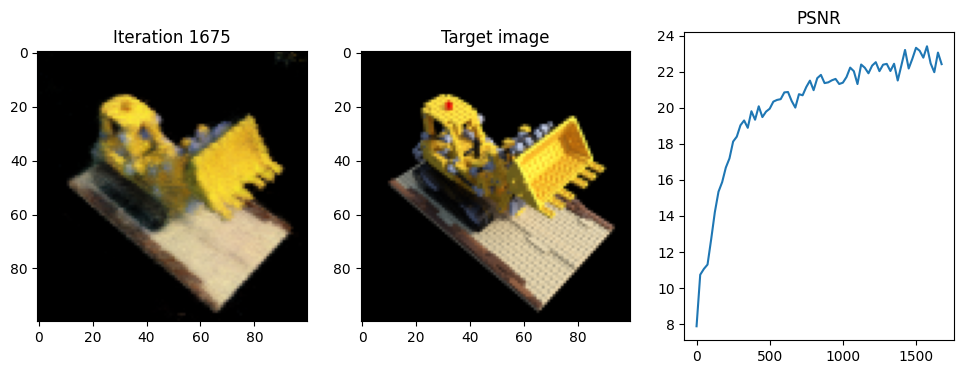

tensor([[ 0.2049,  0.6537,  0.4287],
        [ 0.2119,  0.6337,  0.4295],
        [ 0.2190,  0.6138,  0.4304],
        ...,
        [-0.6151, -0.2127, -0.7119],
        [-0.6216, -0.2289, -0.7239],
        [-0.6280, -0.2450, -0.7360]], device='cuda:0')
tensor([[ 0.3340, -0.9418,  0.0390],
        [ 0.3340, -0.9418,  0.0390],
        [ 0.3340, -0.9418,  0.0390],
        ...,
        [-0.3050, -0.7634, -0.5693],
        [-0.3050, -0.7634, -0.5693],
        [-0.3050, -0.7634, -0.5693]], device='cuda:0')
tensor([[ 0.2422, -0.3358,  0.6940],
        [ 0.2231, -0.3351,  0.6848],
        [ 0.2040, -0.3343,  0.6757],
        ...,
        [ 0.4022,  0.5004, -0.7199],
        [ 0.3974,  0.5097, -0.7383],
        [ 0.3927,  0.5190, -0.7567]], device='cuda:0')
tensor([[-0.9007,  0.0352, -0.4331],
        [-0.9007,  0.0352, -0.4331],
        [-0.9007,  0.0352, -0.4331],
        ...,
        [-0.2251,  0.4391, -0.8698],
        [-0.2251,  0.4391, -0.8698],
        [-0.2251,  0.4391, -0.8698]], devic

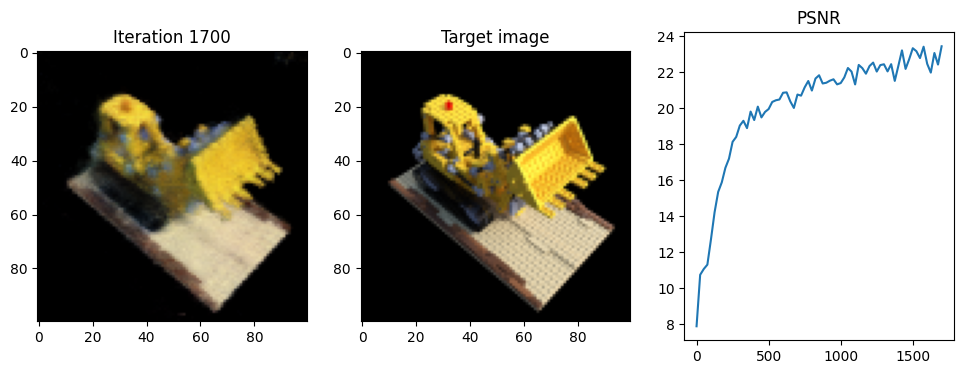

tensor([[-0.2537, -0.5904,  0.4900],
        [-0.2591, -0.5700,  0.4888],
        [-0.2646, -0.5496,  0.4877],
        ...,
        [ 0.6255,  0.0926, -0.7284],
        [ 0.6332,  0.1069, -0.7419],
        [ 0.6408,  0.1213, -0.7555]], device='cuda:0')
tensor([[-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        ...,
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405]], device='cuda:0')
tensor([[ 0.4143, -0.5436,  0.4312],
        [ 0.3940, -0.5378,  0.4319],
        [ 0.3736, -0.5321,  0.4327],
        ...,
        [ 0.1834,  0.6236, -0.7127],
        [ 0.1740,  0.6381, -0.7248],
        [ 0.1646,  0.6527, -0.7369]], device='cuda:0')
tensor([[-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        ...,
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722]], devic

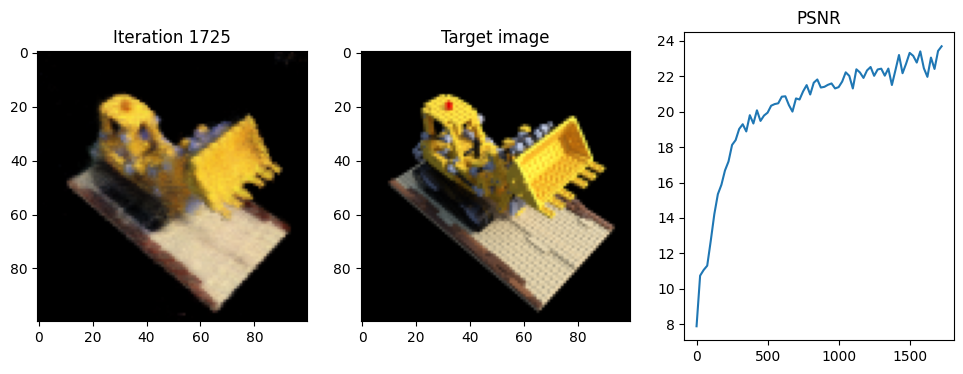

tensor([[ 0.0696,  0.7305,  0.3385],
        [ 0.0802,  0.7125,  0.3420],
        [ 0.0908,  0.6945,  0.3455],
        ...,
        [-0.5463, -0.4142, -0.6785],
        [-0.5494, -0.4327, -0.6883],
        [-0.5524, -0.4512, -0.6981]], device='cuda:0')
tensor([[ 0.5005, -0.8500,  0.1643],
        [ 0.5005, -0.8500,  0.1643],
        [ 0.5005, -0.8500,  0.1643],
        ...,
        [-0.1441, -0.8743, -0.4635],
        [-0.1441, -0.8743, -0.4635],
        [-0.1441, -0.8743, -0.4635]], device='cuda:0')
tensor([[-0.5430,  0.2406,  0.5480],
        [-0.5229,  0.2464,  0.5449],
        [-0.5028,  0.2522,  0.5417],
        ...,
        [ 0.0305, -0.6202, -0.7381],
        [ 0.0436, -0.6275, -0.7531],
        [ 0.0566, -0.6349, -0.7680]], device='cuda:0')
tensor([[ 0.9501,  0.2751, -0.1473],
        [ 0.9501,  0.2751, -0.1473],
        [ 0.9501,  0.2751, -0.1473],
        ...,
        [ 0.6167, -0.3460, -0.7071],
        [ 0.6167, -0.3460, -0.7071],
        [ 0.6167, -0.3460, -0.7071]], devic

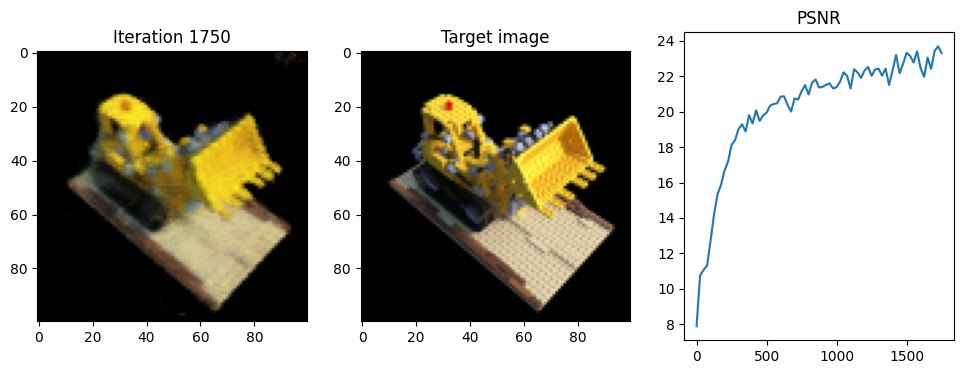

tensor([[-0.5041,  0.3411,  0.5316],
        [-0.4832,  0.3430,  0.5290],
        [-0.4623,  0.3450,  0.5265],
        ...,
        [-0.0644, -0.6201, -0.7360],
        [-0.0526, -0.6298, -0.7506],
        [-0.0407, -0.6395, -0.7651]], device='cuda:0')
tensor([[ 0.9884,  0.0927, -0.1199],
        [ 0.9884,  0.0927, -0.1199],
        [ 0.9884,  0.0927, -0.1199],
        ...,
        [ 0.5614, -0.4594, -0.6884],
        [ 0.5614, -0.4594, -0.6884],
        [ 0.5614, -0.4594, -0.6884]], device='cuda:0')
tensor([[ 0.3627,  0.3446,  0.6346],
        [ 0.3622,  0.3245,  0.6281],
        [ 0.3617,  0.3043,  0.6217],
        ...,
        [-0.5524,  0.2850, -0.7376],
        [-0.5625,  0.2775, -0.7546],
        [-0.5725,  0.2699, -0.7716]], device='cuda:0')
tensor([[-0.0243, -0.9520, -0.3050],
        [-0.0243, -0.9520, -0.3050],
        [-0.0243, -0.9520, -0.3050],
        ...,
        [-0.4757, -0.3548, -0.8048],
        [-0.4757, -0.3548, -0.8048],
        [-0.4757, -0.3548, -0.8048]], devic

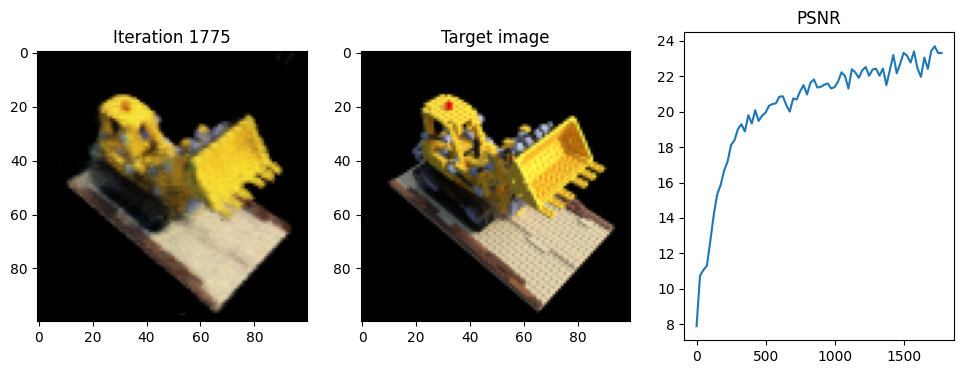

tensor([[ 0.2032,  0.1392,  0.7697],
        [ 0.2112,  0.1257,  0.7554],
        [ 0.2191,  0.1122,  0.7412],
        ...,
        [-0.6478,  0.3362, -0.6306],
        [-0.6543,  0.3337, -0.6506],
        [-0.6608,  0.3313, -0.6706]], device='cuda:0')
tensor([[ 0.3745, -0.6382, -0.6727],
        [ 0.3745, -0.6382, -0.6727],
        [ 0.3745, -0.6382, -0.6727],
        ...,
        [-0.3071, -0.1168, -0.9445],
        [-0.3071, -0.1168, -0.9445],
        [-0.3071, -0.1168, -0.9445]], device='cuda:0')
tensor([[-0.1726,  0.6780,  0.4044],
        [-0.1563,  0.6647,  0.4060],
        [-0.1399,  0.6514,  0.4075],
        ...,
        [-0.4013, -0.5234, -0.7039],
        [-0.3982, -0.5409, -0.7153],
        [-0.3950, -0.5584, -0.7268]], device='cuda:0')
tensor([[ 0.7735, -0.6295,  0.0739],
        [ 0.7735, -0.6295,  0.0739],
        [ 0.7735, -0.6295,  0.0739],
        ...,
        [ 0.1467, -0.8282, -0.5409],
        [ 0.1467, -0.8282, -0.5409],
        [ 0.1467, -0.8282, -0.5409]], devic

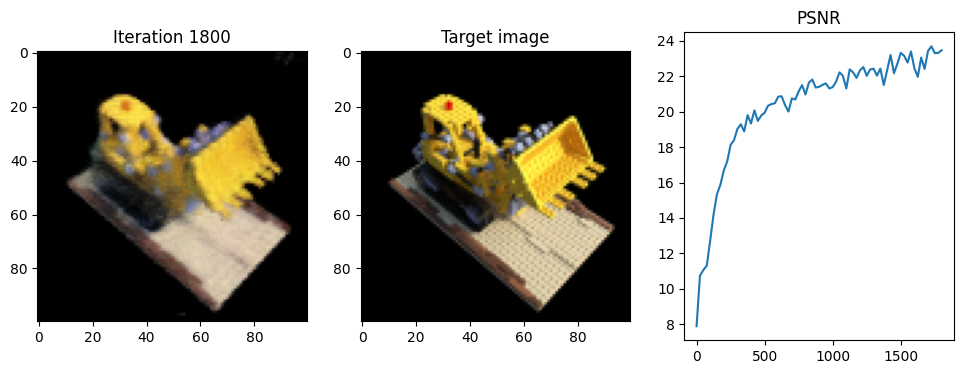

tensor([[ 0.3627,  0.3446,  0.6346],
        [ 0.3622,  0.3245,  0.6281],
        [ 0.3617,  0.3043,  0.6217],
        ...,
        [-0.5524,  0.2850, -0.7376],
        [-0.5625,  0.2775, -0.7546],
        [-0.5725,  0.2699, -0.7716]], device='cuda:0')
tensor([[-0.0243, -0.9520, -0.3050],
        [-0.0243, -0.9520, -0.3050],
        [-0.0243, -0.9520, -0.3050],
        ...,
        [-0.4757, -0.3548, -0.8048],
        [-0.4757, -0.3548, -0.8048],
        [-0.4757, -0.3548, -0.8048]], device='cuda:0')
tensor([[-0.4533,  0.4589,  0.4868],
        [-0.4324,  0.4562,  0.4858],
        [-0.4114,  0.4536,  0.4847],
        ...,
        [-0.1469, -0.6159, -0.7277],
        [-0.1364, -0.6284, -0.7411],
        [-0.1260, -0.6409, -0.7546]], device='cuda:0')
tensor([[ 0.9909, -0.1259, -0.0483],
        [ 0.9909, -0.1259, -0.0483],
        [ 0.9909, -0.1259, -0.0483],
        ...,
        [ 0.4941, -0.5919, -0.6368],
        [ 0.4941, -0.5919, -0.6368],
        [ 0.4941, -0.5919, -0.6368]], devic

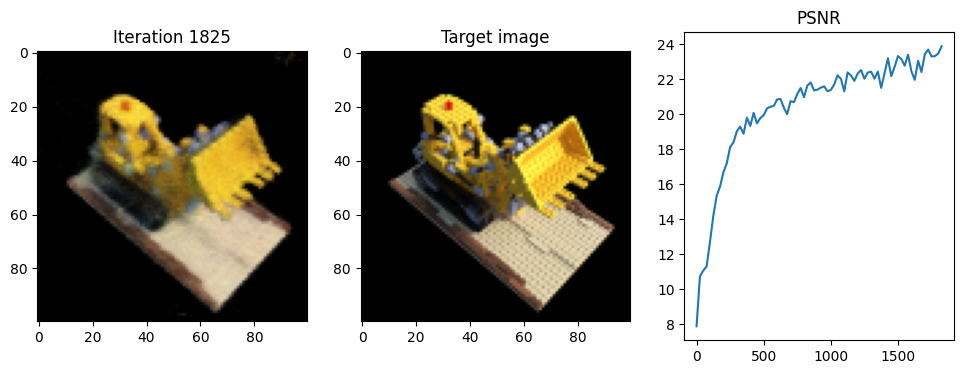

tensor([[-0.6069, -0.1623,  0.5083],
        [-0.5944, -0.1454,  0.5065],
        [-0.5819, -0.1284,  0.5048],
        ...,
        [ 0.4450, -0.4431, -0.7321],
        [ 0.4606, -0.4404, -0.7461],
        [ 0.4762, -0.4376, -0.7601]], device='cuda:0')
tensor([[ 0.5905,  0.8029, -0.0821],
        [ 0.5905,  0.8029, -0.0821],
        [ 0.5905,  0.8029, -0.0821],
        ...,
        [ 0.7385,  0.1301, -0.6616],
        [ 0.7385,  0.1301, -0.6616],
        [ 0.7385,  0.1301, -0.6616]], device='cuda:0')
tensor([[ 0.1397,  0.7110,  0.3577],
        [ 0.1486,  0.6920,  0.3606],
        [ 0.1574,  0.6731,  0.3635],
        ...,
        [-0.5852, -0.3417, -0.6864],
        [-0.5900, -0.3595, -0.6967],
        [-0.5949, -0.3774, -0.7070]], device='cuda:0')
tensor([[ 0.4179, -0.8979,  0.1386],
        [ 0.4179, -0.8979,  0.1386],
        [ 0.4179, -0.8979,  0.1386],
        ...,
        [-0.2279, -0.8437, -0.4861],
        [-0.2279, -0.8437, -0.4861],
        [-0.2279, -0.8437, -0.4861]], devic

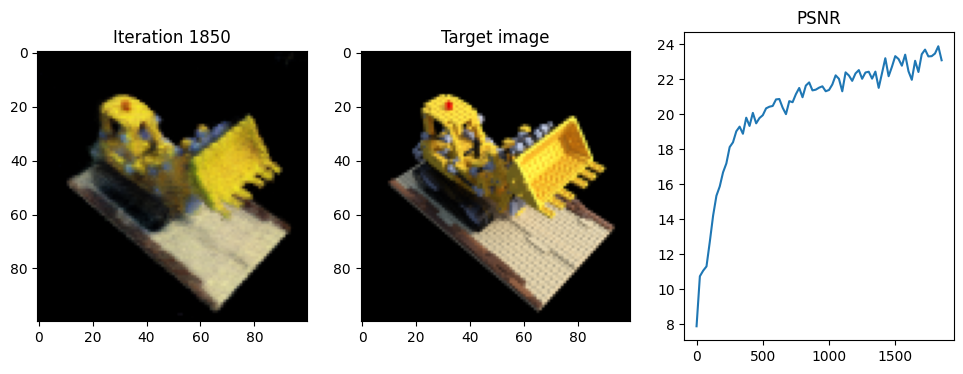

tensor([[-0.3644,  0.2603,  0.6727],
        [-0.3454,  0.2648,  0.6645],
        [-0.3264,  0.2693,  0.6564],
        ...,
        [-0.2068, -0.5973, -0.7286],
        [-0.1986, -0.6050, -0.7465],
        [-0.1904, -0.6128, -0.7645]], device='cuda:0')
tensor([[ 0.8983,  0.2130, -0.3844],
        [ 0.8983,  0.2130, -0.3844],
        [ 0.8983,  0.2130, -0.3844],
        ...,
        [ 0.3866, -0.3655, -0.8468],
        [ 0.3866, -0.3655, -0.8468],
        [ 0.3866, -0.3655, -0.8468]], device='cuda:0')
tensor([[ 0.2375,  0.1026,  0.7656],
        [ 0.2414,  0.0871,  0.7518],
        [ 0.2454,  0.0715,  0.7380],
        ...,
        [-0.5378,  0.4784, -0.6422],
        [-0.5448,  0.4771, -0.6621],
        [-0.5518,  0.4759, -0.6820]], device='cuda:0')
tensor([[ 0.1861, -0.7349, -0.6521],
        [ 0.1861, -0.7349, -0.6521],
        [ 0.1861, -0.7349, -0.6521],
        ...,
        [-0.3326, -0.0585, -0.9413],
        [-0.3326, -0.0585, -0.9413],
        [-0.3326, -0.0585, -0.9413]], devic

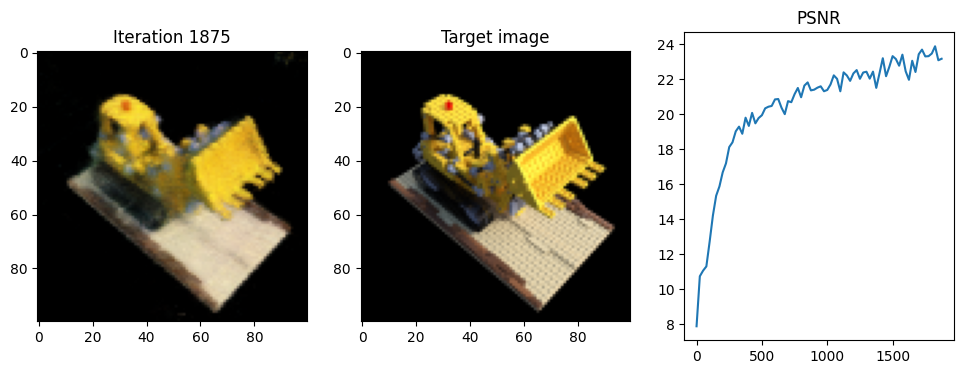

tensor([[-0.4646,  0.4347,  0.4983],
        [-0.4435,  0.4329,  0.4969],
        [-0.4225,  0.4312,  0.4955],
        ...,
        [-0.1322, -0.6163, -0.7301],
        [-0.1215, -0.6282, -0.7439],
        [-0.1107, -0.6402, -0.7577]], device='cuda:0')
tensor([[ 0.9945, -0.0815, -0.0662],
        [ 0.9945, -0.0815, -0.0662],
        [ 0.9945, -0.0815, -0.0662],
        ...,
        [ 0.5086, -0.5646, -0.6501],
        [ 0.5086, -0.5646, -0.6501],
        [ 0.5086, -0.5646, -0.6501]], device='cuda:0')
tensor([[ 0.1917,  0.1007,  0.7786],
        [ 0.2021,  0.0912,  0.7628],
        [ 0.2126,  0.0817,  0.7471],
        ...,
        [-0.7331,  0.2328, -0.5820],
        [-0.7395,  0.2310, -0.6021],
        [-0.7460,  0.2292, -0.6222]], device='cuda:0')
tensor([[ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        ...,
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487]], devic

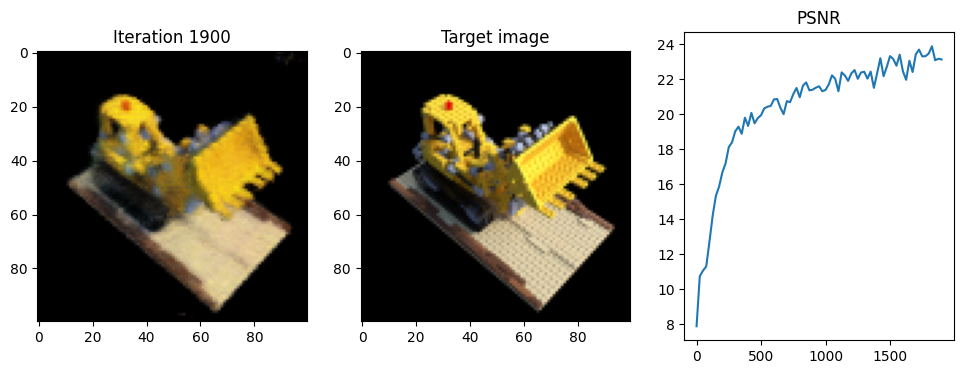

tensor([[ 0.2204,  0.1682,  0.7591],
        [ 0.2266,  0.1529,  0.7459],
        [ 0.2329,  0.1376,  0.7327],
        ...,
        [-0.6048,  0.3653, -0.6566],
        [-0.6116,  0.3623, -0.6764],
        [-0.6184,  0.3592, -0.6962]], device='cuda:0')
tensor([[ 0.2940, -0.7243, -0.6237],
        [ 0.2940, -0.7243, -0.6237],
        [ 0.2940, -0.7243, -0.6237],
        ...,
        [-0.3214, -0.1461, -0.9356],
        [-0.3214, -0.1461, -0.9356],
        [-0.3214, -0.1461, -0.9356]], device='cuda:0')
tensor([[-0.3286, -0.3203,  0.6652],
        [-0.3294, -0.3006,  0.6574],
        [-0.3301, -0.2810,  0.6496],
        ...,
        [ 0.5514, -0.3034, -0.7310],
        [ 0.5606, -0.2965, -0.7487],
        [ 0.5699, -0.2897, -0.7665]], device='cuda:0')
tensor([[-0.0365,  0.9291, -0.3681],
        [-0.0365,  0.9291, -0.3681],
        [-0.0365,  0.9291, -0.3681],
        ...,
        [ 0.4371,  0.3252, -0.8386],
        [ 0.4371,  0.3252, -0.8386],
        [ 0.4371,  0.3252, -0.8386]], devic

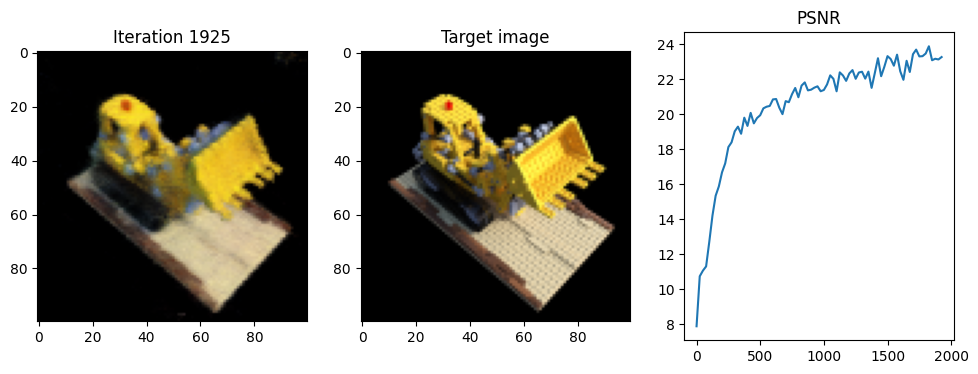

tensor([[ 0.2965,  0.6745,  0.3320],
        [ 0.3009,  0.6541,  0.3357],
        [ 0.3053,  0.6337,  0.3393],
        ...,
        [-0.6497, -0.2272, -0.6757],
        [-0.6585, -0.2439, -0.6854],
        [-0.6672, -0.2606, -0.6950]], device='cuda:0')
tensor([[ 0.2075, -0.9628,  0.1729],
        [ 0.2075, -0.9628,  0.1729],
        [ 0.2075, -0.9628,  0.1729],
        ...,
        [-0.4127, -0.7886, -0.4558],
        [-0.4127, -0.7886, -0.4558],
        [-0.4127, -0.7886, -0.4558]], device='cuda:0')
tensor([[-0.3587,  0.4649,  0.5553],
        [-0.3382,  0.4605,  0.5519],
        [-0.3178,  0.4562,  0.5485],
        ...,
        [-0.2746, -0.5560, -0.7388],
        [-0.2667, -0.5685, -0.7540],
        [-0.2588, -0.5810, -0.7691]], device='cuda:0')
tensor([[ 0.9656, -0.2054, -0.1597],
        [ 0.9656, -0.2054, -0.1597],
        [ 0.9656, -0.2054, -0.1597],
        ...,
        [ 0.3719, -0.5915, -0.7154],
        [ 0.3719, -0.5915, -0.7154],
        [ 0.3719, -0.5915, -0.7154]], devic

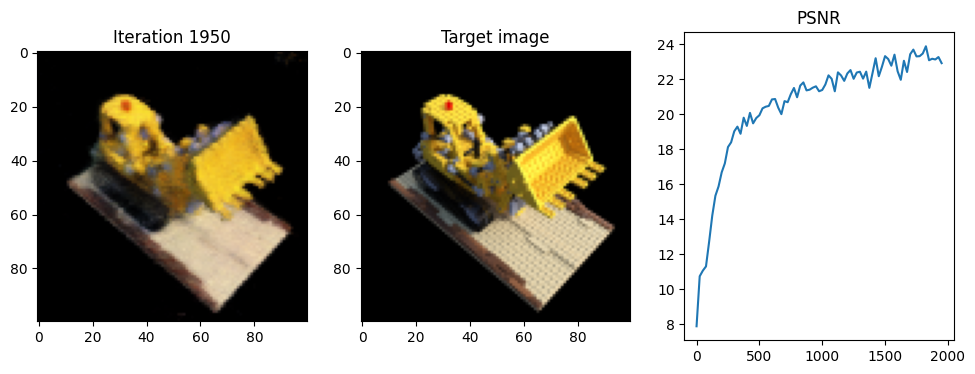

tensor([[ 0.5767, -0.3959,  0.4047],
        [ 0.5556, -0.3967,  0.4062],
        [ 0.5345, -0.3974,  0.4078],
        ...,
        [-0.0431,  0.6580, -0.7040],
        [-0.0570,  0.6691, -0.7154],
        [-0.0709,  0.6802, -0.7269]], device='cuda:0')
tensor([[-0.9966, -0.0367,  0.0735],
        [-0.9966, -0.0367,  0.0735],
        [-0.9966, -0.0367,  0.0735],
        ...,
        [-0.6562,  0.5258, -0.5413],
        [-0.6562,  0.5258, -0.5413],
        [-0.6562,  0.5258, -0.5413]], device='cuda:0')
tensor([[ 0.0615, -0.4058,  0.6961],
        [ 0.0448, -0.3966,  0.6868],
        [ 0.0282, -0.3873,  0.6776],
        ...,
        [ 0.5878,  0.2611, -0.7188],
        [ 0.5878,  0.2715, -0.7373],
        [ 0.5878,  0.2818, -0.7557]], device='cuda:0')
tensor([[-0.7858,  0.4366, -0.4381],
        [-0.7858,  0.4366, -0.4381],
        [-0.7858,  0.4366, -0.4381],
        ...,
        [ 0.0011,  0.4894, -0.8720],
        [ 0.0011,  0.4894, -0.8720],
        [ 0.0011,  0.4894, -0.8720]], devic

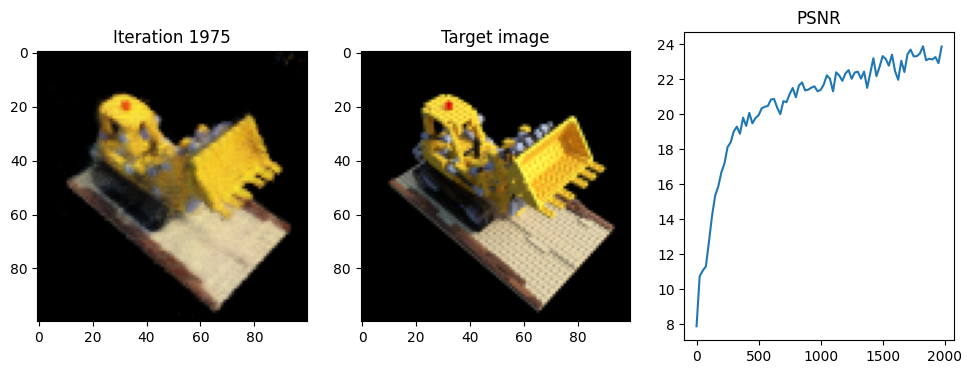

tensor([[ 0.1203, -0.5850,  0.5444],
        [ 0.1039, -0.5720,  0.5414],
        [ 0.0876, -0.5589,  0.5384],
        ...,
        [ 0.4853,  0.3882, -0.7377],
        [ 0.4837,  0.4031, -0.7526],
        [ 0.4820,  0.4181, -0.7674]], device='cuda:0')
tensor([[-0.7751,  0.6159, -0.1412],
        [-0.7751,  0.6159, -0.1412],
        [-0.7751,  0.6159, -0.1412],
        ...,
        [-0.0776,  0.7070, -0.7030],
        [-0.0776,  0.7070, -0.7030],
        [-0.0776,  0.7070, -0.7030]], device='cuda:0')
tensor([[-0.2537, -0.5904,  0.4900],
        [-0.2591, -0.5700,  0.4888],
        [-0.2646, -0.5496,  0.4877],
        ...,
        [ 0.6255,  0.0926, -0.7284],
        [ 0.6332,  0.1069, -0.7419],
        [ 0.6408,  0.1213, -0.7555]], device='cuda:0')
tensor([[-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        ...,
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405]], devic

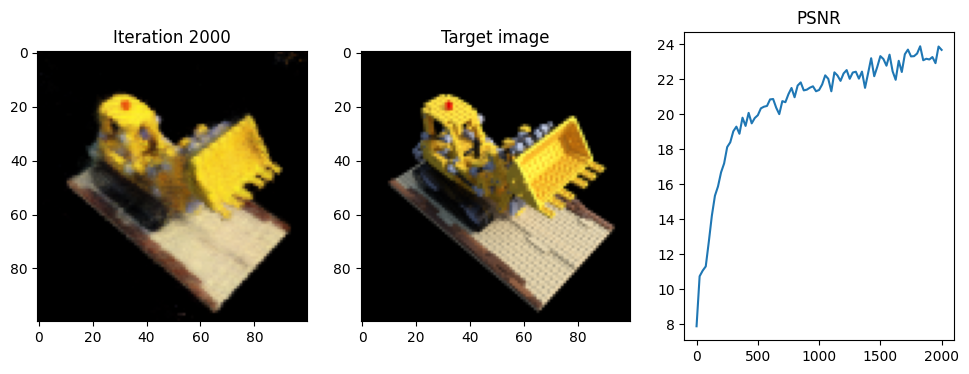

tensor([[-0.6569, -0.0859,  0.4627],
        [-0.6420, -0.0709,  0.4625],
        [-0.6270, -0.0560,  0.4622],
        ...,
        [ 0.4225, -0.4806, -0.7217],
        [ 0.4393, -0.4797, -0.7346],
        [ 0.4561, -0.4789, -0.7475]], device='cuda:0')
tensor([[ 0.7070,  0.7071, -0.0114],
        [ 0.7070,  0.7071, -0.0114],
        [ 0.7070,  0.7071, -0.0114],
        ...,
        [ 0.7923,  0.0393, -0.6089],
        [ 0.7923,  0.0393, -0.6089],
        [ 0.7923,  0.0393, -0.6089]], device='cuda:0')
tensor([[ 0.2113,  0.3496,  0.6972],
        [ 0.2182,  0.3319,  0.6879],
        [ 0.2252,  0.3143,  0.6786],
        ...,
        [-0.6194,  0.1757, -0.7182],
        [-0.6260,  0.1678, -0.7367],
        [-0.6326,  0.1599, -0.7552]], device='cuda:0')
tensor([[ 0.3272, -0.8358, -0.4409],
        [ 0.3272, -0.8358, -0.4409],
        [ 0.3272, -0.8358, -0.4409],
        ...,
        [-0.3128, -0.3736, -0.8732],
        [-0.3128, -0.3736, -0.8732],
        [-0.3128, -0.3736, -0.8732]], devic

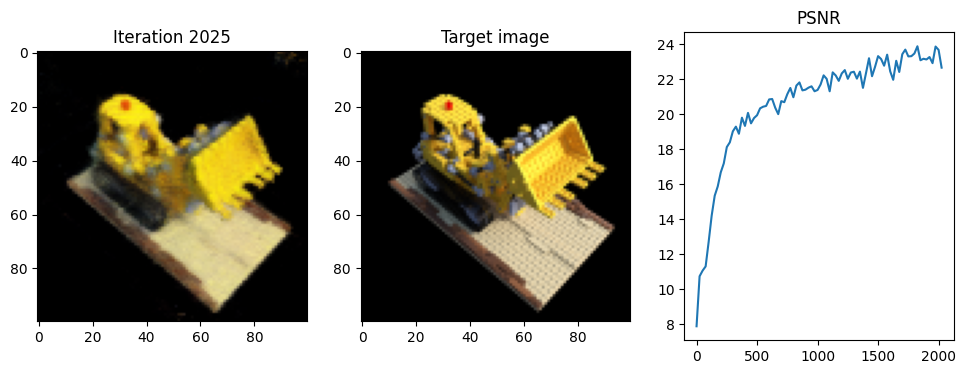

tensor([[ 0.6264,  0.2617,  0.4384],
        [ 0.6157,  0.2434,  0.4389],
        [ 0.6051,  0.2251,  0.4395],
        ...,
        [-0.5517,  0.3391, -0.7149],
        [-0.5680,  0.3337, -0.7272],
        [-0.5844,  0.3283, -0.7394]], device='cuda:0')
tensor([[-0.5034, -0.8637,  0.0248],
        [-0.5034, -0.8637,  0.0248],
        [-0.5034, -0.8637,  0.0248],
        ...,
        [-0.7733, -0.2547, -0.5807],
        [-0.7733, -0.2547, -0.5807],
        [-0.7733, -0.2547, -0.5807]], device='cuda:0')
tensor([[-0.2495,  0.4266,  0.6394],
        [-0.2300,  0.4216,  0.6328],
        [-0.2106,  0.4167,  0.6261],
        ...,
        [-0.4074, -0.4706, -0.7368],
        [-0.4025, -0.4820, -0.7540],
        [-0.3976, -0.4934, -0.7711]], device='cuda:0')
tensor([[ 0.9200, -0.2339, -0.3146],
        [ 0.9200, -0.2339, -0.3146],
        [ 0.9200, -0.2339, -0.3146],
        ...,
        [ 0.2328, -0.5380, -0.8102],
        [ 0.2328, -0.5380, -0.8102],
        [ 0.2328, -0.5380, -0.8102]], devic

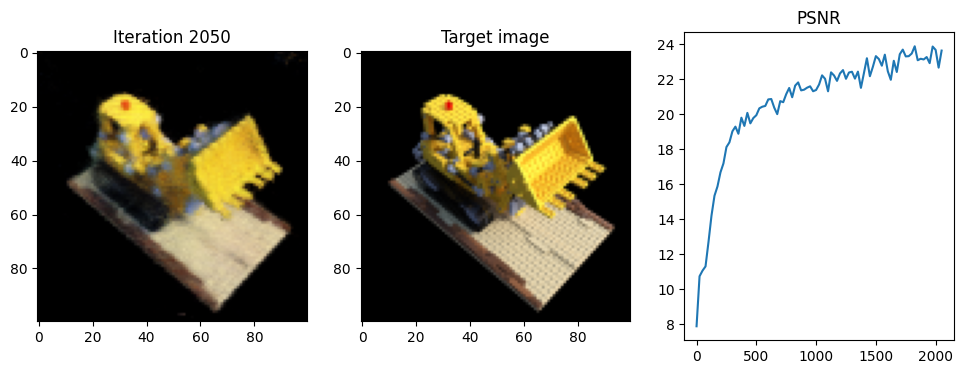

tensor([[-0.6605,  0.1097,  0.4525],
        [-0.6418,  0.1196,  0.4526],
        [-0.6231,  0.1295,  0.4527],
        ...,
        [ 0.2742, -0.5816, -0.7190],
        [ 0.2907, -0.5857, -0.7316],
        [ 0.3071, -0.5898, -0.7442]], device='cuda:0')
tensor([[ 0.8836,  0.4682,  0.0040],
        [ 0.8836,  0.4682,  0.0040],
        [ 0.8836,  0.4682,  0.0040],
        ...,
        [ 0.7785, -0.1936, -0.5970],
        [ 0.7785, -0.1936, -0.5970],
        [ 0.7785, -0.1936, -0.5970]], device='cuda:0')
tensor([[-0.3587,  0.4649,  0.5553],
        [-0.3382,  0.4605,  0.5519],
        [-0.3178,  0.4562,  0.5485],
        ...,
        [-0.2746, -0.5560, -0.7388],
        [-0.2667, -0.5685, -0.7540],
        [-0.2588, -0.5810, -0.7691]], device='cuda:0')
tensor([[ 0.9656, -0.2054, -0.1597],
        [ 0.9656, -0.2054, -0.1597],
        [ 0.9656, -0.2054, -0.1597],
        ...,
        [ 0.3719, -0.5915, -0.7154],
        [ 0.3719, -0.5915, -0.7154],
        [ 0.3719, -0.5915, -0.7154]], devic

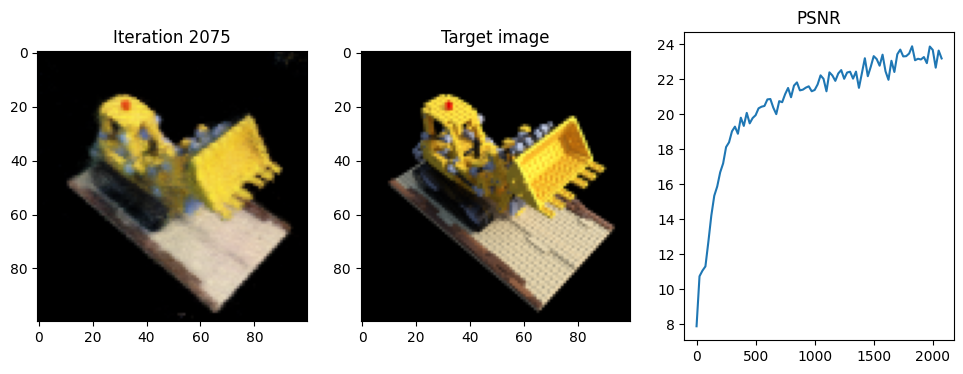

tensor([[-0.0720, -0.7215,  0.3568],
        [-0.0826, -0.7034,  0.3598],
        [-0.0932, -0.6853,  0.3628],
        ...,
        [ 0.5502,  0.3962, -0.6861],
        [ 0.5534,  0.4144, -0.6963],
        [ 0.5565,  0.4326, -0.7066]], device='cuda:0')
tensor([[-0.5007,  0.8543,  0.1397],
        [-0.5007,  0.8543,  0.1397],
        [-0.5007,  0.8543,  0.1397],
        ...,
        [ 0.1473,  0.8620, -0.4851],
        [ 0.1473,  0.8620, -0.4851],
        [ 0.1473,  0.8620, -0.4851]], device='cuda:0')
tensor([[-0.2644, -0.5968,  0.4764],
        [-0.2695, -0.5763,  0.4757],
        [-0.2746, -0.5557,  0.4751],
        ...,
        [ 0.6283,  0.0982, -0.7252],
        [ 0.6362,  0.1127, -0.7384],
        [ 0.6441,  0.1272, -0.7517]], device='cuda:0')
tensor([[-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        [-0.2412,  0.9699, -0.0323],
        ...,
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248],
        [ 0.3738,  0.6855, -0.6248]], devic

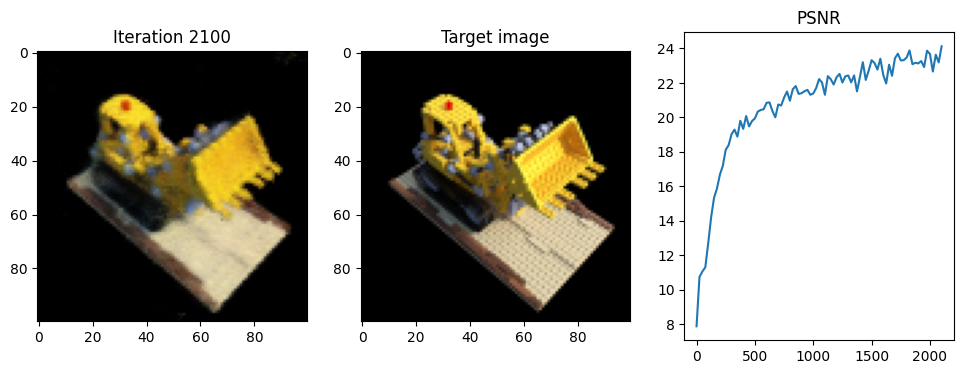

tensor([[-0.0720, -0.7215,  0.3568],
        [-0.0826, -0.7034,  0.3598],
        [-0.0932, -0.6853,  0.3628],
        ...,
        [ 0.5502,  0.3962, -0.6861],
        [ 0.5534,  0.4144, -0.6963],
        [ 0.5565,  0.4326, -0.7066]], device='cuda:0')
tensor([[-0.5007,  0.8543,  0.1397],
        [-0.5007,  0.8543,  0.1397],
        [-0.5007,  0.8543,  0.1397],
        ...,
        [ 0.1473,  0.8620, -0.4851],
        [ 0.1473,  0.8620, -0.4851],
        [ 0.1473,  0.8620, -0.4851]], device='cuda:0')
tensor([[ 0.1650, -0.4277,  0.6655],
        [ 0.1466, -0.4207,  0.6577],
        [ 0.1283, -0.4137,  0.6499],
        ...,
        [ 0.4961,  0.3874, -0.7309],
        [ 0.4934,  0.3986, -0.7486],
        [ 0.4907,  0.4098, -0.7664]], device='cuda:0')
tensor([[-0.8684,  0.3314, -0.3688],
        [-0.8684,  0.3314, -0.3688],
        [-0.8684,  0.3314, -0.3688],
        ...,
        [-0.1268,  0.5293, -0.8389],
        [-0.1268,  0.5293, -0.8389],
        [-0.1268,  0.5293, -0.8389]], devic

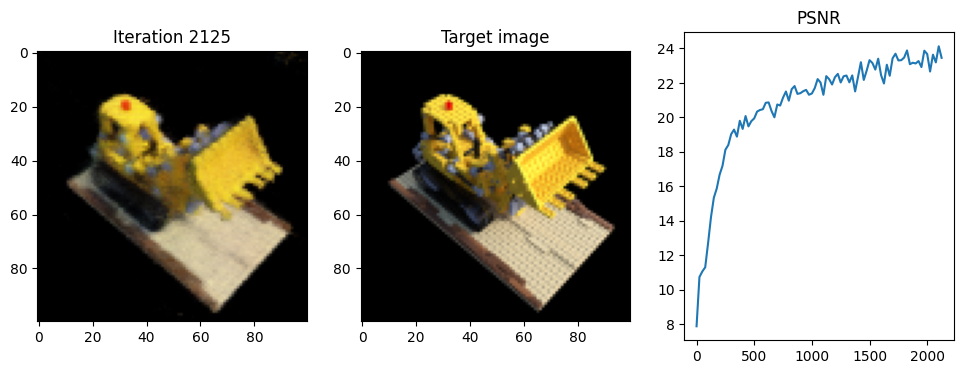

tensor([[-0.2495,  0.4266,  0.6394],
        [-0.2300,  0.4216,  0.6328],
        [-0.2106,  0.4167,  0.6261],
        ...,
        [-0.4074, -0.4706, -0.7368],
        [-0.4025, -0.4820, -0.7540],
        [-0.3976, -0.4934, -0.7711]], device='cuda:0')
tensor([[ 0.9200, -0.2339, -0.3146],
        [ 0.9200, -0.2339, -0.3146],
        [ 0.9200, -0.2339, -0.3146],
        ...,
        [ 0.2328, -0.5380, -0.8102],
        [ 0.2328, -0.5380, -0.8102],
        [ 0.2328, -0.5380, -0.8102]], device='cuda:0')
tensor([[-0.5269,  0.2599,  0.5549],
        [-0.5066,  0.2649,  0.5515],
        [-0.4864,  0.2700,  0.5482],
        ...,
        [-0.0016, -0.6201, -0.7388],
        [ 0.0110, -0.6279, -0.7539],
        [ 0.0236, -0.6357, -0.7690]], device='cuda:0')
tensor([[ 0.9576,  0.2400, -0.1590],
        [ 0.9576,  0.2400, -0.1590],
        [ 0.9576,  0.2400, -0.1590],
        ...,
        [ 0.5946, -0.3677, -0.7150],
        [ 0.5946, -0.3677, -0.7150],
        [ 0.5946, -0.3677, -0.7150]], devic

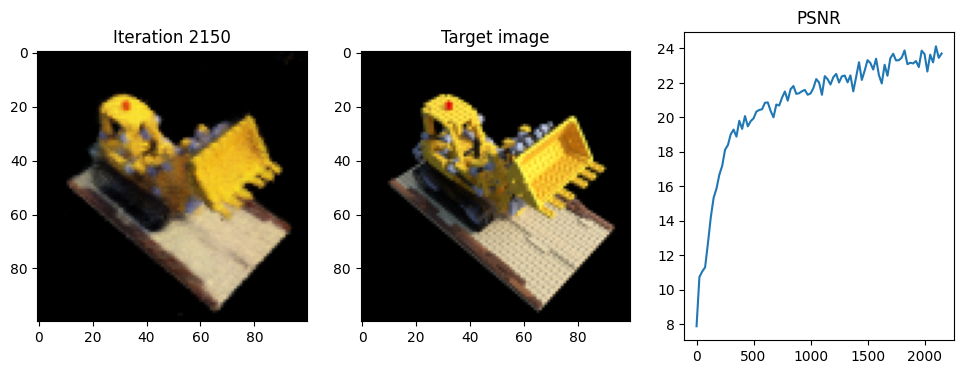

tensor([[-0.2899,  0.0809,  0.7500],
        [-0.2796,  0.0945,  0.7375],
        [-0.2694,  0.1082,  0.7250],
        ...,
        [ 0.0360, -0.6911, -0.6719],
        [ 0.0430, -0.6948, -0.6915],
        [ 0.0500, -0.6985, -0.7111]], device='cuda:0')
tensor([[ 0.4846,  0.6461, -0.5897],
        [ 0.4846,  0.6461, -0.5897],
        [ 0.4846,  0.6461, -0.5897],
        ...,
        [ 0.3316, -0.1742, -0.9272],
        [ 0.3316, -0.1742, -0.9272],
        [ 0.3316, -0.1742, -0.9272]], device='cuda:0')
tensor([[-0.7315,  0.0633,  0.3375],
        [-0.7136,  0.0740,  0.3410],
        [-0.6958,  0.0848,  0.3445],
        ...,
        [ 0.4198, -0.5426, -0.6781],
        [ 0.4383, -0.5455, -0.6878],
        [ 0.4568, -0.5484, -0.6976]], device='cuda:0')
tensor([[ 0.8455,  0.5077,  0.1657],
        [ 0.8455,  0.5077,  0.1657],
        [ 0.8455,  0.5077,  0.1657],
        ...,
        [ 0.8761, -0.1365, -0.4623],
        [ 0.8761, -0.1365, -0.4623],
        [ 0.8761, -0.1365, -0.4623]], devic

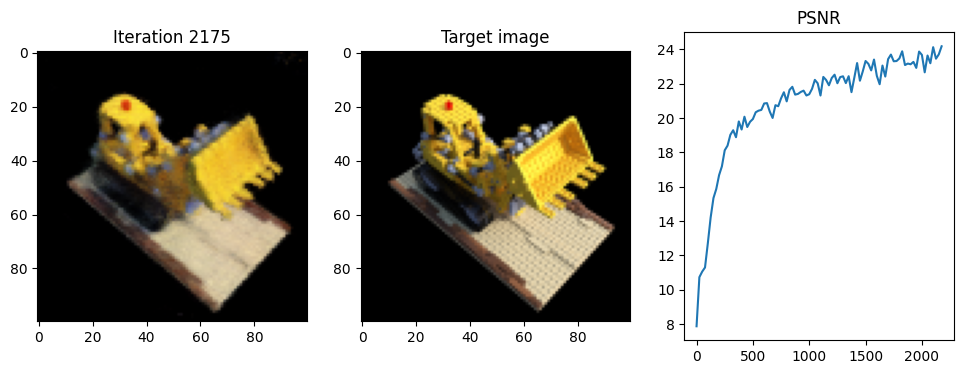

tensor([[ 0.3627,  0.3446,  0.6346],
        [ 0.3622,  0.3245,  0.6281],
        [ 0.3617,  0.3043,  0.6217],
        ...,
        [-0.5524,  0.2850, -0.7376],
        [-0.5625,  0.2775, -0.7546],
        [-0.5725,  0.2699, -0.7716]], device='cuda:0')
tensor([[-0.0243, -0.9520, -0.3050],
        [-0.0243, -0.9520, -0.3050],
        [-0.0243, -0.9520, -0.3050],
        ...,
        [-0.4757, -0.3548, -0.8048],
        [-0.4757, -0.3548, -0.8048],
        [-0.4757, -0.3548, -0.8048]], device='cuda:0')
tensor([[-0.5430,  0.2406,  0.5480],
        [-0.5229,  0.2464,  0.5449],
        [-0.5028,  0.2522,  0.5417],
        ...,
        [ 0.0305, -0.6202, -0.7381],
        [ 0.0436, -0.6275, -0.7531],
        [ 0.0566, -0.6349, -0.7680]], device='cuda:0')
tensor([[ 0.9501,  0.2751, -0.1473],
        [ 0.9501,  0.2751, -0.1473],
        [ 0.9501,  0.2751, -0.1473],
        ...,
        [ 0.6167, -0.3460, -0.7071],
        [ 0.6167, -0.3460, -0.7071],
        [ 0.6167, -0.3460, -0.7071]], devic

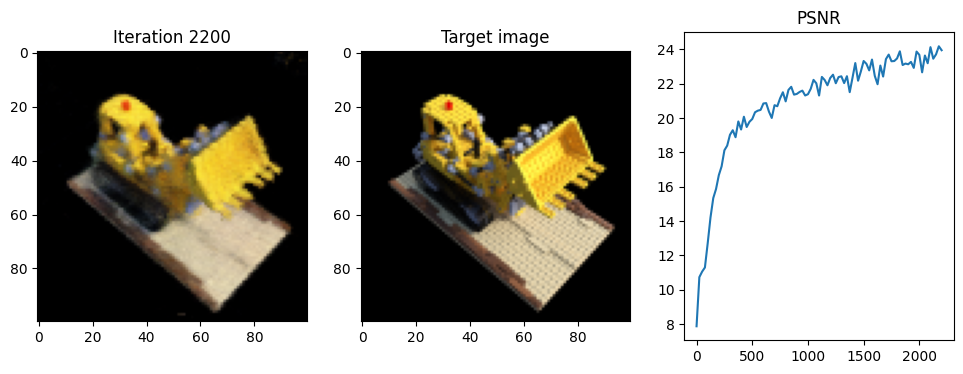

tensor([[ 0.5767, -0.3959,  0.4047],
        [ 0.5556, -0.3967,  0.4062],
        [ 0.5345, -0.3974,  0.4078],
        ...,
        [-0.0431,  0.6580, -0.7040],
        [-0.0570,  0.6691, -0.7154],
        [-0.0709,  0.6802, -0.7269]], device='cuda:0')
tensor([[-0.9966, -0.0367,  0.0735],
        [-0.9966, -0.0367,  0.0735],
        [-0.9966, -0.0367,  0.0735],
        ...,
        [-0.6562,  0.5258, -0.5413],
        [-0.6562,  0.5258, -0.5413],
        [-0.6562,  0.5258, -0.5413]], device='cuda:0')
tensor([[ 0.1397,  0.7110,  0.3577],
        [ 0.1486,  0.6920,  0.3606],
        [ 0.1574,  0.6731,  0.3635],
        ...,
        [-0.5852, -0.3417, -0.6864],
        [-0.5900, -0.3595, -0.6967],
        [-0.5949, -0.3774, -0.7070]], device='cuda:0')
tensor([[ 0.4179, -0.8979,  0.1386],
        [ 0.4179, -0.8979,  0.1386],
        [ 0.4179, -0.8979,  0.1386],
        ...,
        [-0.2279, -0.8437, -0.4861],
        [-0.2279, -0.8437, -0.4861],
        [-0.2279, -0.8437, -0.4861]], devic

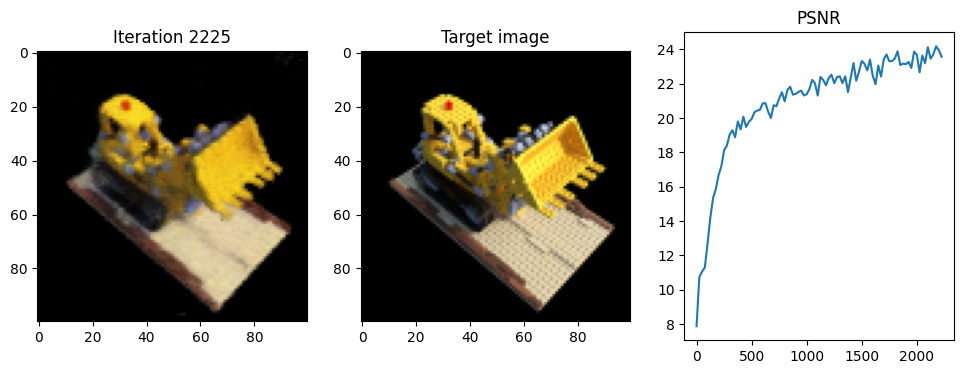

tensor([[-0.2495,  0.4266,  0.6394],
        [-0.2300,  0.4216,  0.6328],
        [-0.2106,  0.4167,  0.6261],
        ...,
        [-0.4074, -0.4706, -0.7368],
        [-0.4025, -0.4820, -0.7540],
        [-0.3976, -0.4934, -0.7711]], device='cuda:0')
tensor([[ 0.9200, -0.2339, -0.3146],
        [ 0.9200, -0.2339, -0.3146],
        [ 0.9200, -0.2339, -0.3146],
        ...,
        [ 0.2328, -0.5380, -0.8102],
        [ 0.2328, -0.5380, -0.8102],
        [ 0.2328, -0.5380, -0.8102]], device='cuda:0')
tensor([[-0.0397,  0.3443,  0.7300],
        [-0.0232,  0.3373,  0.7189],
        [-0.0066,  0.3302,  0.7077],
        ...,
        [-0.6187, -0.2534, -0.6953],
        [-0.6193, -0.2623, -0.7145],
        [-0.6199, -0.2712, -0.7337]], device='cuda:0')
tensor([[ 0.7818, -0.3338, -0.5267],
        [ 0.7818, -0.3338, -0.5267],
        [ 0.7818, -0.3338, -0.5267],
        ...,
        [-0.0294, -0.4191, -0.9075],
        [-0.0294, -0.4191, -0.9075],
        [-0.0294, -0.4191, -0.9075]], devic

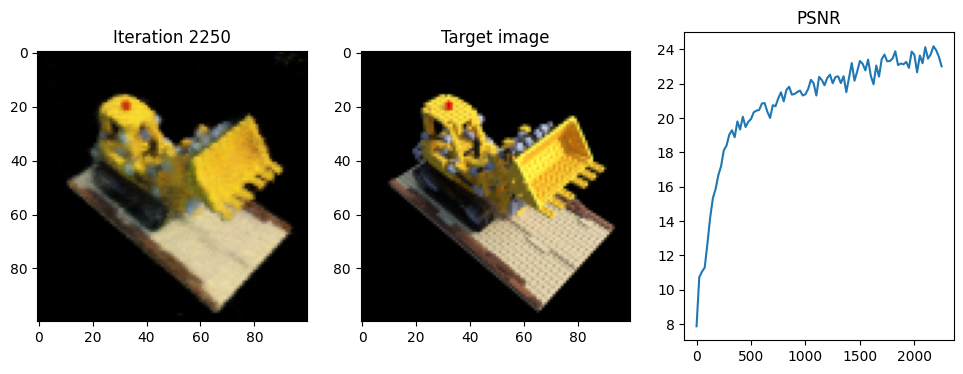

tensor([[ 0.5247, -0.4083,  0.4594],
        [ 0.5035, -0.4081,  0.4593],
        [ 0.4824, -0.4080,  0.4591],
        ...,
        [ 0.0420,  0.6395, -0.7209],
        [ 0.0296,  0.6509, -0.7337],
        [ 0.0171,  0.6623, -0.7465]], device='cuda:0')
tensor([[-1.0000,  0.0070, -0.0064],
        [-1.0000,  0.0070, -0.0064],
        [-1.0000,  0.0070, -0.0064],
        ...,
        [-0.5873,  0.5376, -0.6051],
        [-0.5873,  0.5376, -0.6051],
        [-0.5873,  0.5376, -0.6051]], device='cuda:0')
tensor([[-0.0081,  0.2179,  0.7781],
        [ 0.0054,  0.2226,  0.7625],
        [ 0.0188,  0.2274,  0.7469],
        ...,
        [-0.5417, -0.5406, -0.5871],
        [-0.5429, -0.5472, -0.6072],
        [-0.5441, -0.5537, -0.6272]], device='cuda:0')
tensor([[ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        ...,
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488]], devic

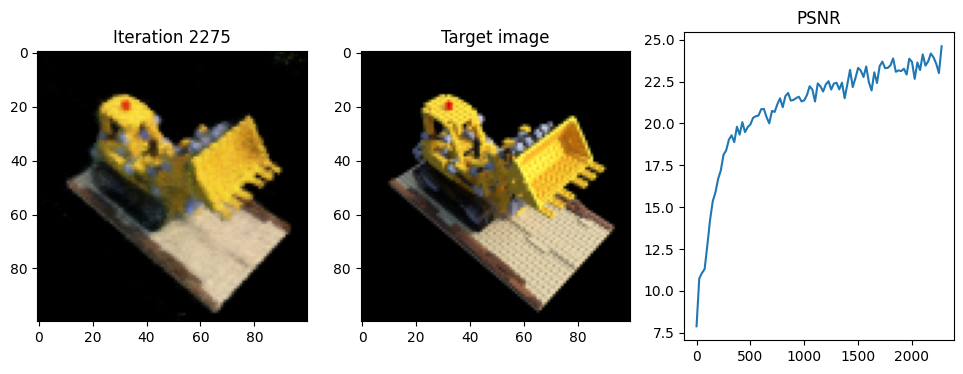

tensor([[-0.7369,  0.0438,  0.3288],
        [-0.7193,  0.0550,  0.3325],
        [-0.7018,  0.0662,  0.3363],
        ...,
        [ 0.4415, -0.5299, -0.6743],
        [ 0.4602, -0.5323, -0.6839],
        [ 0.4789, -0.5347, -0.6935]], device='cuda:0')
tensor([[ 0.8303,  0.5284,  0.1772],
        [ 0.8303,  0.5284,  0.1772],
        [ 0.8303,  0.5284,  0.1772],
        ...,
        [ 0.8848, -0.1130, -0.4520],
        [ 0.8848, -0.1130, -0.4520],
        [ 0.8848, -0.1130, -0.4520]], device='cuda:0')
tensor([[-0.0677, -0.2645,  0.7606],
        [-0.0822, -0.2567,  0.7473],
        [-0.0966, -0.2489,  0.7339],
        ...,
        [ 0.7028,  0.0968, -0.6535],
        [ 0.7062,  0.1034, -0.6733],
        [ 0.7096,  0.1099, -0.6932]], device='cuda:0')
tensor([[-0.6834,  0.3687, -0.6300],
        [-0.6834,  0.3687, -0.6300],
        [-0.6834,  0.3687, -0.6300],
        ...,
        [ 0.1607,  0.3102, -0.9370],
        [ 0.1607,  0.3102, -0.9370],
        [ 0.1607,  0.3102, -0.9370]], devic

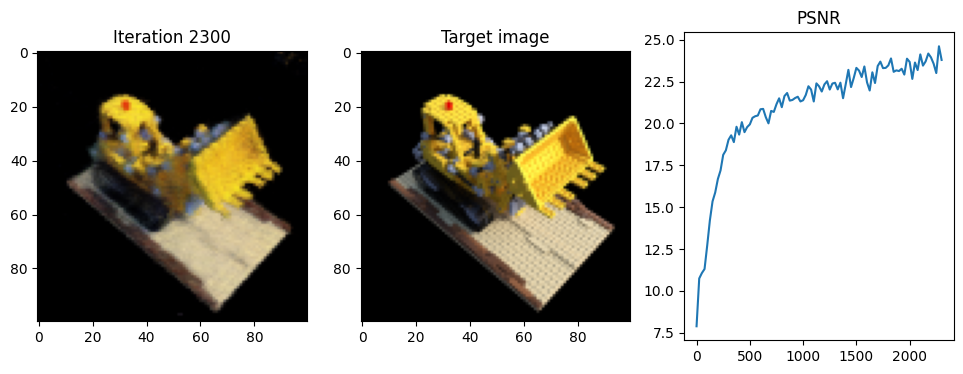

tensor([[-0.2495,  0.4266,  0.6394],
        [-0.2300,  0.4216,  0.6328],
        [-0.2106,  0.4167,  0.6261],
        ...,
        [-0.4074, -0.4706, -0.7368],
        [-0.4025, -0.4820, -0.7540],
        [-0.3976, -0.4934, -0.7711]], device='cuda:0')
tensor([[ 0.9200, -0.2339, -0.3146],
        [ 0.9200, -0.2339, -0.3146],
        [ 0.9200, -0.2339, -0.3146],
        ...,
        [ 0.2328, -0.5380, -0.8102],
        [ 0.2328, -0.5380, -0.8102],
        [ 0.2328, -0.5380, -0.8102]], device='cuda:0')
tensor([[-0.2086, -0.0490,  0.7792],
        [-0.2174, -0.0385,  0.7631],
        [-0.2262, -0.0280,  0.7470],
        ...,
        [ 0.6940, -0.3546, -0.5684],
        [ 0.7007, -0.3543, -0.5884],
        [ 0.7075, -0.3541, -0.6085]], device='cuda:0')
tensor([[-0.4178,  0.4956, -0.7614],
        [-0.4178,  0.4956, -0.7614],
        [-0.4178,  0.4956, -0.7614],
        ...,
        [ 0.3187,  0.0127, -0.9478],
        [ 0.3187,  0.0127, -0.9478],
        [ 0.3187,  0.0127, -0.9478]], devic

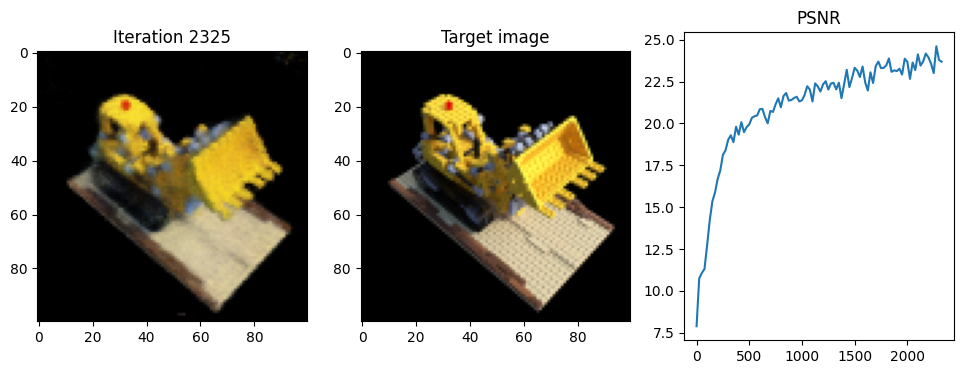

tensor([[ 0.1203, -0.5850,  0.5444],
        [ 0.1039, -0.5720,  0.5414],
        [ 0.0876, -0.5589,  0.5384],
        ...,
        [ 0.4853,  0.3882, -0.7377],
        [ 0.4837,  0.4031, -0.7526],
        [ 0.4820,  0.4181, -0.7674]], device='cuda:0')
tensor([[-0.7751,  0.6159, -0.1412],
        [-0.7751,  0.6159, -0.1412],
        [-0.7751,  0.6159, -0.1412],
        ...,
        [-0.0776,  0.7070, -0.7030],
        [-0.0776,  0.7070, -0.7030],
        [-0.0776,  0.7070, -0.7030]], device='cuda:0')
tensor([[ 0.3633,  0.6349,  0.3435],
        [ 0.3656,  0.6141,  0.3468],
        [ 0.3678,  0.5933,  0.3501],
        ...,
        [-0.6673, -0.1481, -0.6806],
        [-0.6776, -0.1637, -0.6905],
        [-0.6880, -0.1792, -0.7004]], device='cuda:0')
tensor([[ 0.1064, -0.9817,  0.1577],
        [ 0.1064, -0.9817,  0.1577],
        [ 0.1064, -0.9817,  0.1577],
        ...,
        [-0.4902, -0.7345, -0.4694],
        [-0.4902, -0.7345, -0.4694],
        [-0.4902, -0.7345, -0.4694]], devic

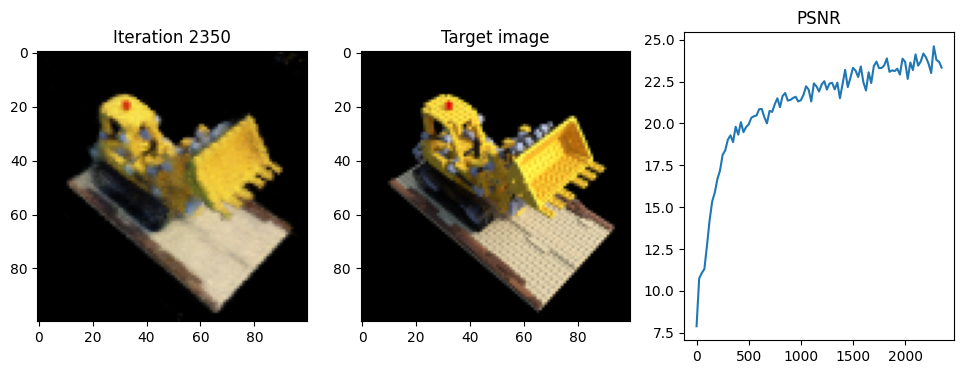

tensor([[-0.3580,  0.6105,  0.3901],
        [-0.3386,  0.6022,  0.3921],
        [-0.3193,  0.5939,  0.3940],
        ...,
        [-0.2315, -0.6233, -0.6988],
        [-0.2235, -0.6395, -0.7099],
        [-0.2155, -0.6556, -0.7210]], device='cuda:0')
tensor([[ 0.9150, -0.3924,  0.0941],
        [ 0.9150, -0.3924,  0.0941],
        [ 0.9150, -0.3924,  0.0941],
        ...,
        [ 0.3764, -0.7639, -0.5242],
        [ 0.3764, -0.7639, -0.5242],
        [ 0.3764, -0.7639, -0.5242]], device='cuda:0')
tensor([[-0.4533,  0.4589,  0.4868],
        [-0.4324,  0.4562,  0.4858],
        [-0.4114,  0.4536,  0.4847],
        ...,
        [-0.1469, -0.6159, -0.7277],
        [-0.1364, -0.6284, -0.7411],
        [-0.1260, -0.6409, -0.7546]], device='cuda:0')
tensor([[ 0.9909, -0.1259, -0.0483],
        [ 0.9909, -0.1259, -0.0483],
        [ 0.9909, -0.1259, -0.0483],
        ...,
        [ 0.4941, -0.5919, -0.6368],
        [ 0.4941, -0.5919, -0.6368],
        [ 0.4941, -0.5919, -0.6368]], devic

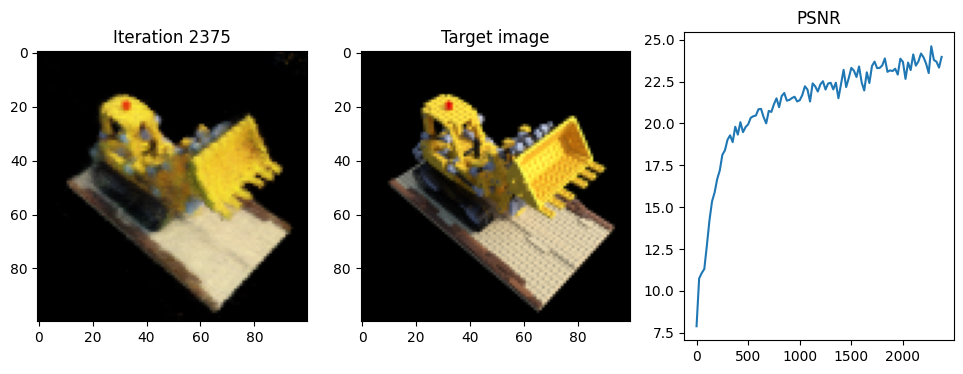

tensor([[-0.2086, -0.0490,  0.7792],
        [-0.2174, -0.0385,  0.7631],
        [-0.2262, -0.0280,  0.7470],
        ...,
        [ 0.6940, -0.3546, -0.5684],
        [ 0.7007, -0.3543, -0.5884],
        [ 0.7075, -0.3541, -0.6085]], device='cuda:0')
tensor([[-0.4178,  0.4956, -0.7614],
        [-0.4178,  0.4956, -0.7614],
        [-0.4178,  0.4956, -0.7614],
        ...,
        [ 0.3187,  0.0127, -0.9478],
        [ 0.3187,  0.0127, -0.9478],
        [ 0.3187,  0.0127, -0.9478]], device='cuda:0')
tensor([[-0.3163,  0.0819,  0.7391],
        [-0.3048,  0.0952,  0.7274],
        [-0.2933,  0.1085,  0.7157],
        ...,
        [ 0.0247, -0.6777, -0.6859],
        [ 0.0323, -0.6814, -0.7053],
        [ 0.0399, -0.6851, -0.7247]], device='cuda:0')
tensor([[ 0.5455,  0.6290, -0.5539],
        [ 0.5455,  0.6290, -0.5539],
        [ 0.5455,  0.6290, -0.5539],
        ...,
        [ 0.3601, -0.1737, -0.9166],
        [ 0.3601, -0.1737, -0.9166],
        [ 0.3601, -0.1737, -0.9166]], devic

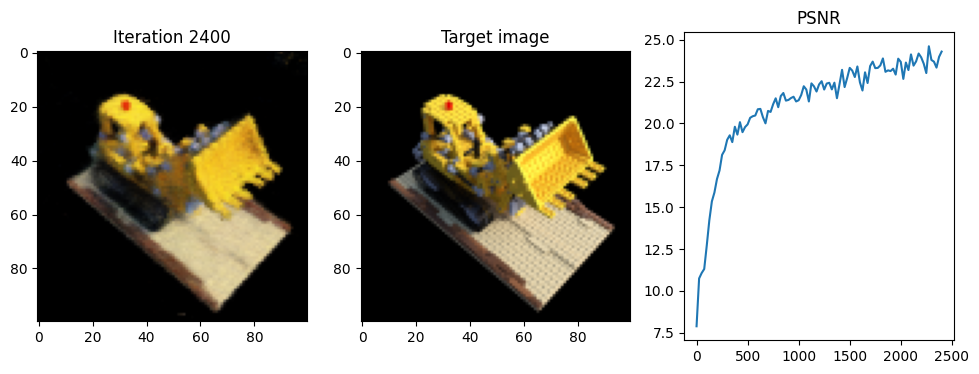

tensor([[-0.2130, -0.3744,  0.6837],
        [-0.2198, -0.3563,  0.6751],
        [-0.2267, -0.3383,  0.6664],
        ...,
        [ 0.6184, -0.1518, -0.7245],
        [ 0.6251, -0.1433, -0.7427],
        [ 0.6317, -0.1347, -0.7608]], device='cuda:0')
tensor([[-0.3231,  0.8533, -0.4092],
        [-0.3231,  0.8533, -0.4092],
        [-0.3231,  0.8533, -0.4092],
        ...,
        [ 0.3146,  0.4044, -0.8588],
        [ 0.3146,  0.4044, -0.8588],
        [ 0.3146,  0.4044, -0.8588]], device='cuda:0')
tensor([[ 0.2032,  0.1392,  0.7697],
        [ 0.2112,  0.1257,  0.7554],
        [ 0.2191,  0.1122,  0.7412],
        ...,
        [-0.6478,  0.3362, -0.6306],
        [-0.6543,  0.3337, -0.6506],
        [-0.6608,  0.3313, -0.6706]], device='cuda:0')
tensor([[ 0.3745, -0.6382, -0.6727],
        [ 0.3745, -0.6382, -0.6727],
        [ 0.3745, -0.6382, -0.6727],
        ...,
        [-0.3071, -0.1168, -0.9445],
        [-0.3071, -0.1168, -0.9445],
        [-0.3071, -0.1168, -0.9445]], devic

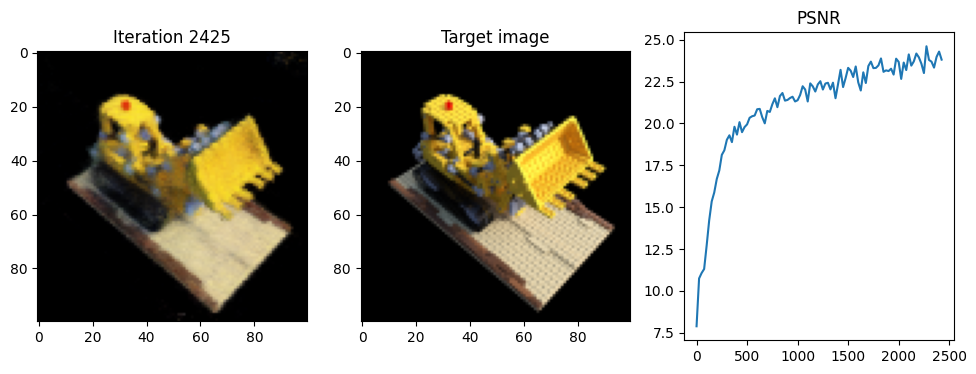

tensor([[-0.4467, -0.4113,  0.5333],
        [-0.4438, -0.3905,  0.5307],
        [-0.4409, -0.3697,  0.5281],
        ...,
        [ 0.5879, -0.2066, -0.7363],
        [ 0.6001, -0.1973, -0.7509],
        [ 0.6122, -0.1880, -0.7655]], device='cuda:0')
tensor([[ 0.1358,  0.9831, -0.1227],
        [ 0.1358,  0.9831, -0.1227],
        [ 0.1358,  0.9831, -0.1227],
        ...,
        [ 0.5747,  0.4395, -0.6903],
        [ 0.5747,  0.4395, -0.6903],
        [ 0.5747,  0.4395, -0.6903]], device='cuda:0')
tensor([[ 0.0358, -0.3596,  0.7228],
        [ 0.0194, -0.3516,  0.7121],
        [ 0.0031, -0.3435,  0.7014],
        ...,
        [ 0.6180,  0.2372, -0.7015],
        [ 0.6187,  0.2464, -0.7206],
        [ 0.6195,  0.2556, -0.7396]], device='cuda:0')
tensor([[-0.7740,  0.3802, -0.5064],
        [-0.7740,  0.3802, -0.5064],
        [-0.7740,  0.3802, -0.5064],
        ...,
        [ 0.0337,  0.4344, -0.9001],
        [ 0.0337,  0.4344, -0.9001],
        [ 0.0337,  0.4344, -0.9001]], devic

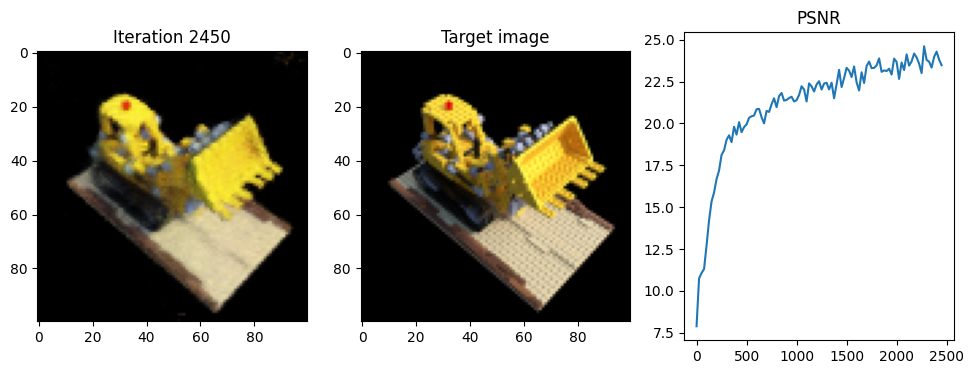

tensor([[ 0.3633,  0.6349,  0.3435],
        [ 0.3656,  0.6141,  0.3468],
        [ 0.3678,  0.5933,  0.3501],
        ...,
        [-0.6673, -0.1481, -0.6806],
        [-0.6776, -0.1637, -0.6905],
        [-0.6880, -0.1792, -0.7004]], device='cuda:0')
tensor([[ 0.1064, -0.9817,  0.1577],
        [ 0.1064, -0.9817,  0.1577],
        [ 0.1064, -0.9817,  0.1577],
        ...,
        [-0.4902, -0.7345, -0.4694],
        [-0.4902, -0.7345, -0.4694],
        [-0.4902, -0.7345, -0.4694]], device='cuda:0')
tensor([[ 0.1397,  0.7110,  0.3577],
        [ 0.1486,  0.6920,  0.3606],
        [ 0.1574,  0.6731,  0.3635],
        ...,
        [-0.5852, -0.3417, -0.6864],
        [-0.5900, -0.3595, -0.6967],
        [-0.5949, -0.3774, -0.7070]], device='cuda:0')
tensor([[ 0.4179, -0.8979,  0.1386],
        [ 0.4179, -0.8979,  0.1386],
        [ 0.4179, -0.8979,  0.1386],
        ...,
        [-0.2279, -0.8437, -0.4861],
        [-0.2279, -0.8437, -0.4861],
        [-0.2279, -0.8437, -0.4861]], devic

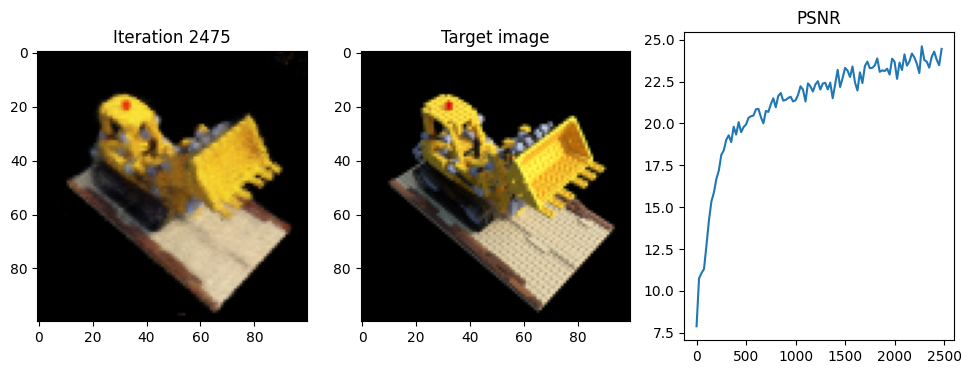

tensor([[-0.2086, -0.0490,  0.7792],
        [-0.2174, -0.0385,  0.7631],
        [-0.2262, -0.0280,  0.7470],
        ...,
        [ 0.6940, -0.3546, -0.5684],
        [ 0.7007, -0.3543, -0.5884],
        [ 0.7075, -0.3541, -0.6085]], device='cuda:0')
tensor([[-0.4178,  0.4956, -0.7614],
        [-0.4178,  0.4956, -0.7614],
        [-0.4178,  0.4956, -0.7614],
        ...,
        [ 0.3187,  0.0127, -0.9478],
        [ 0.3187,  0.0127, -0.9478],
        [ 0.3187,  0.0127, -0.9478]], device='cuda:0')
tensor([[-0.2537, -0.5904,  0.4900],
        [-0.2591, -0.5700,  0.4888],
        [-0.2646, -0.5496,  0.4877],
        ...,
        [ 0.6255,  0.0926, -0.7284],
        [ 0.6332,  0.1069, -0.7419],
        [ 0.6408,  0.1213, -0.7555]], device='cuda:0')
tensor([[-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        [-0.2574,  0.9648, -0.0532],
        ...,
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405],
        [ 0.3614,  0.6776, -0.6405]], devic

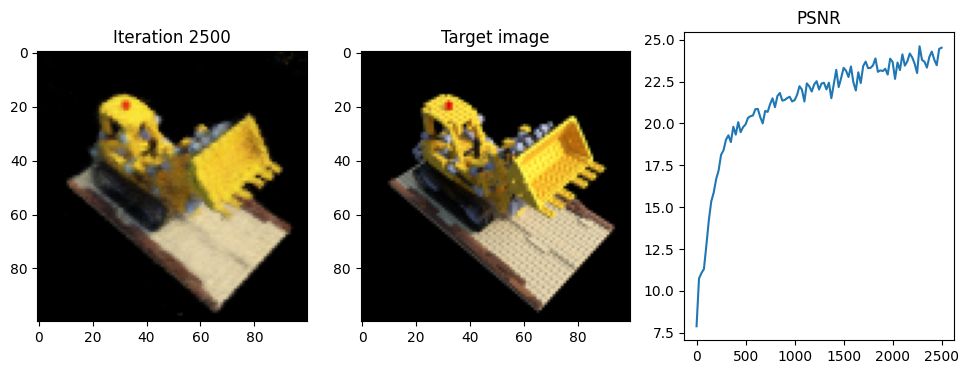

tensor([[ 0.1789,  0.1363,  0.7762],
        [ 0.1911,  0.1360,  0.7589],
        [ 0.2034,  0.1358,  0.7417],
        ...,
        [-0.7880, -0.2052, -0.5170],
        [-0.7943, -0.2090, -0.5369],
        [-0.8006, -0.2128, -0.5567]], device='cuda:0')
tensor([[ 0.5795, -0.0118, -0.8149],
        [ 0.5795, -0.0118, -0.8149],
        [ 0.5795, -0.0118, -0.8149],
        ...,
        [-0.2965, -0.1785, -0.9382],
        [-0.2965, -0.1785, -0.9382],
        [-0.2965, -0.1785, -0.9382]], device='cuda:0')
tensor([[ 0.4143, -0.5436,  0.4312],
        [ 0.3940, -0.5378,  0.4319],
        [ 0.3736, -0.5321,  0.4327],
        ...,
        [ 0.1834,  0.6236, -0.7127],
        [ 0.1740,  0.6381, -0.7248],
        [ 0.1646,  0.6527, -0.7369]], device='cuda:0')
tensor([[-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        [-0.9620,  0.2707,  0.0354],
        ...,
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722],
        [-0.4457,  0.6884, -0.5722]], devic

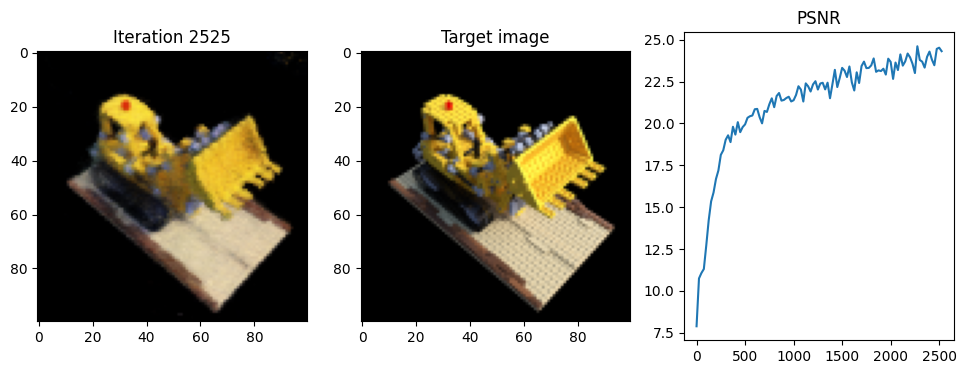

tensor([[ 0.3393, -0.4582,  0.5727],
        [ 0.3190, -0.4538,  0.5687],
        [ 0.2987, -0.4493,  0.5647],
        ...,
        [ 0.2995,  0.5413, -0.7401],
        [ 0.2921,  0.5536, -0.7556],
        [ 0.2848,  0.5659, -0.7712]], device='cuda:0')
tensor([[-0.9590,  0.2102, -0.1898],
        [-0.9590,  0.2102, -0.1898],
        [-0.9590,  0.2102, -0.1898],
        ...,
        [-0.3471,  0.5822, -0.7353],
        [-0.3471,  0.5822, -0.7353],
        [-0.3471,  0.5822, -0.7353]], device='cuda:0')
tensor([[-0.3547, -0.1633,  0.7075],
        [-0.3512, -0.1450,  0.6976],
        [-0.3477, -0.1266,  0.6878],
        ...,
        [ 0.4165, -0.4993, -0.7124],
        [ 0.4261, -0.4967, -0.7312],
        [ 0.4356, -0.4940, -0.7499]], device='cuda:0')
tensor([[ 0.1656,  0.8691, -0.4661],
        [ 0.1656,  0.8691, -0.4661],
        [ 0.1656,  0.8691, -0.4661],
        ...,
        [ 0.4504,  0.1245, -0.8841],
        [ 0.4504,  0.1245, -0.8841],
        [ 0.4504,  0.1245, -0.8841]], devic

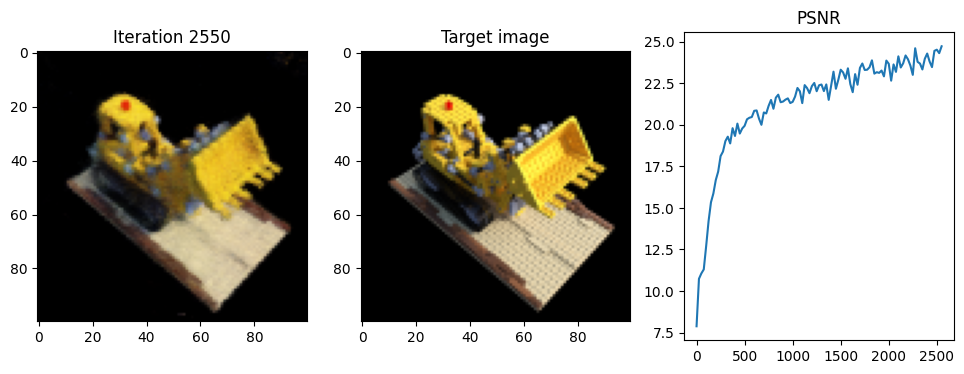

tensor([[ 0.1917,  0.1007,  0.7786],
        [ 0.2021,  0.0912,  0.7628],
        [ 0.2126,  0.0817,  0.7471],
        ...,
        [-0.7331,  0.2328, -0.5820],
        [-0.7395,  0.2310, -0.6021],
        [-0.7460,  0.2292, -0.6222]], device='cuda:0')
tensor([[ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        ...,
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487]], device='cuda:0')
tensor([[ 0.2049,  0.6537,  0.4287],
        [ 0.2119,  0.6337,  0.4295],
        [ 0.2190,  0.6138,  0.4304],
        ...,
        [-0.6151, -0.2127, -0.7119],
        [-0.6216, -0.2289, -0.7239],
        [-0.6280, -0.2450, -0.7360]], device='cuda:0')
tensor([[ 0.3340, -0.9418,  0.0390],
        [ 0.3340, -0.9418,  0.0390],
        [ 0.3340, -0.9418,  0.0390],
        ...,
        [-0.3050, -0.7634, -0.5693],
        [-0.3050, -0.7634, -0.5693],
        [-0.3050, -0.7634, -0.5693]], devic

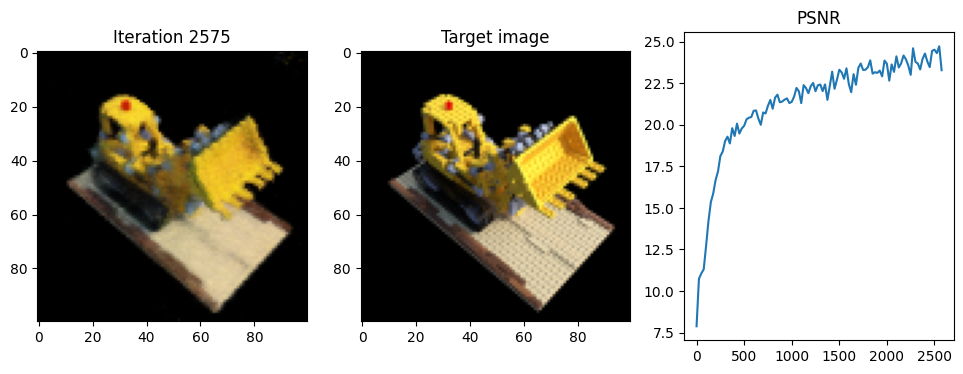

tensor([[-0.2130, -0.3744,  0.6837],
        [-0.2198, -0.3563,  0.6751],
        [-0.2267, -0.3383,  0.6664],
        ...,
        [ 0.6184, -0.1518, -0.7245],
        [ 0.6251, -0.1433, -0.7427],
        [ 0.6317, -0.1347, -0.7608]], device='cuda:0')
tensor([[-0.3231,  0.8533, -0.4092],
        [-0.3231,  0.8533, -0.4092],
        [-0.3231,  0.8533, -0.4092],
        ...,
        [ 0.3146,  0.4044, -0.8588],
        [ 0.3146,  0.4044, -0.8588],
        [ 0.3146,  0.4044, -0.8588]], device='cuda:0')
tensor([[-0.2874,  0.0875,  0.7502],
        [-0.2768,  0.1010,  0.7377],
        [-0.2663,  0.1144,  0.7252],
        ...,
        [ 0.0204, -0.6921, -0.6716],
        [ 0.0273, -0.6959, -0.6912],
        [ 0.0342, -0.6998, -0.7108]], device='cuda:0')
tensor([[ 0.4979,  0.6352, -0.5904],
        [ 0.4979,  0.6352, -0.5904],
        [ 0.4979,  0.6352, -0.5904],
        ...,
        [ 0.3269, -0.1818, -0.9274],
        [ 0.3269, -0.1818, -0.9274],
        [ 0.3269, -0.1818, -0.9274]], devic

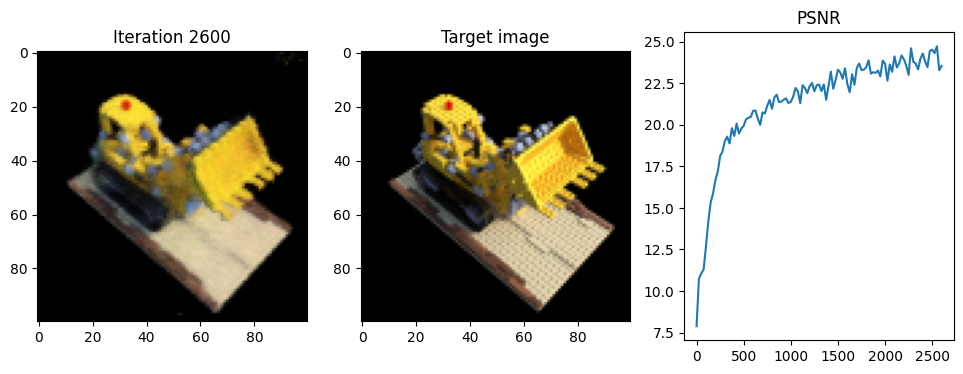

tensor([[-0.4518,  0.3668,  0.5607],
        [-0.4310,  0.3674,  0.5571],
        [-0.4101,  0.3679,  0.5535],
        ...,
        [-0.1444, -0.6025, -0.7393],
        [-0.1340, -0.6128, -0.7546],
        [-0.1236, -0.6231, -0.7698]], device='cuda:0')
tensor([[ 0.9853,  0.0257, -0.1689],
        [ 0.9853,  0.0257, -0.1689],
        [ 0.9853,  0.0257, -0.1689],
        ...,
        [ 0.4927, -0.4864, -0.7216],
        [ 0.4927, -0.4864, -0.7216],
        [ 0.4927, -0.4864, -0.7216]], device='cuda:0')
tensor([[-0.6953, -0.1746,  0.3729],
        [-0.6819, -0.1584,  0.3754],
        [-0.6685, -0.1422,  0.3779],
        ...,
        [ 0.5467, -0.3901, -0.6924],
        [ 0.5647, -0.3869, -0.7031],
        [ 0.5827, -0.3837, -0.7137]], device='cuda:0')
tensor([[ 0.6342,  0.7641,  0.1178],
        [ 0.6342,  0.7641,  0.1178],
        [ 0.6342,  0.7641,  0.1178],
        ...,
        [ 0.8505,  0.1503, -0.5040],
        [ 0.8505,  0.1503, -0.5040],
        [ 0.8505,  0.1503, -0.5040]], devic

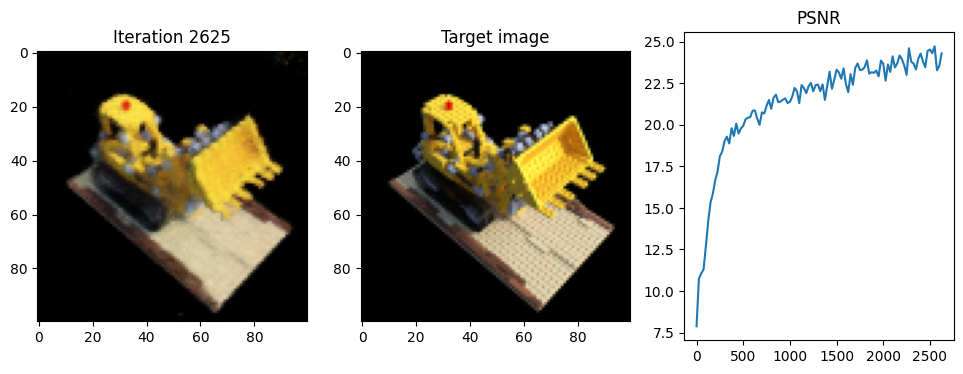

tensor([[ 0.5413, -0.5155,  0.3070],
        [ 0.5208, -0.5127,  0.3114],
        [ 0.5003, -0.5099,  0.3157],
        ...,
        [-0.0109,  0.6989, -0.6646],
        [-0.0238,  0.7130, -0.6737],
        [-0.0368,  0.7271, -0.6827]], device='cuda:0')
tensor([[-0.9695,  0.1333,  0.2056],
        [-0.9695,  0.1333,  0.2056],
        [-0.9695,  0.1333,  0.2056],
        ...,
        [-0.6124,  0.6658, -0.4263],
        [-0.6124,  0.6658, -0.4263],
        [-0.6124,  0.6658, -0.4263]], device='cuda:0')
tensor([[ 0.2032,  0.1392,  0.7697],
        [ 0.2112,  0.1257,  0.7554],
        [ 0.2191,  0.1122,  0.7412],
        ...,
        [-0.6478,  0.3362, -0.6306],
        [-0.6543,  0.3337, -0.6506],
        [-0.6608,  0.3313, -0.6706]], device='cuda:0')
tensor([[ 0.3745, -0.6382, -0.6727],
        [ 0.3745, -0.6382, -0.6727],
        [ 0.3745, -0.6382, -0.6727],
        ...,
        [-0.3071, -0.1168, -0.9445],
        [-0.3071, -0.1168, -0.9445],
        [-0.3071, -0.1168, -0.9445]], devic

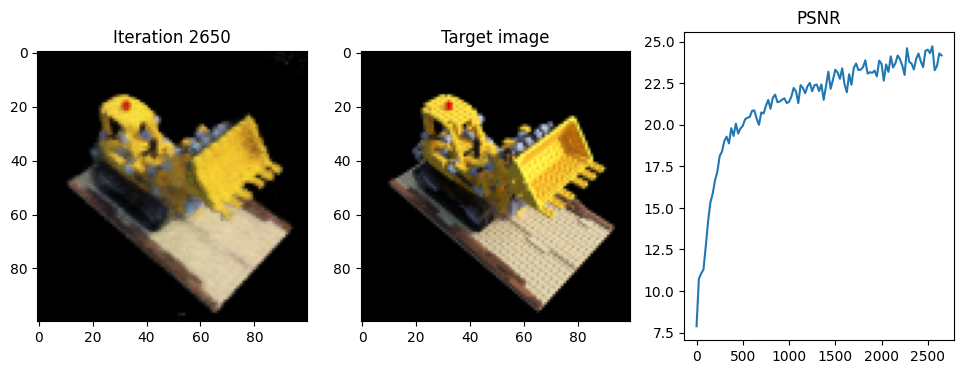

tensor([[-0.1194, -0.3818,  0.7022],
        [-0.1305, -0.3666,  0.6926],
        [-0.1416, -0.3513,  0.6830],
        ...,
        [ 0.6463, -0.0246, -0.7156],
        [ 0.6508, -0.0155, -0.7342],
        [ 0.6553, -0.0064, -0.7528]], device='cuda:0')
tensor([[-0.5249,  0.7208, -0.4528],
        [-0.5249,  0.7208, -0.4528],
        [-0.5249,  0.7208, -0.4528],
        ...,
        [ 0.2123,  0.4281, -0.8785],
        [ 0.2123,  0.4281, -0.8785],
        [ 0.2123,  0.4281, -0.8785]], device='cuda:0')
tensor([[-0.2086, -0.0490,  0.7792],
        [-0.2174, -0.0385,  0.7631],
        [-0.2262, -0.0280,  0.7470],
        ...,
        [ 0.6940, -0.3546, -0.5684],
        [ 0.7007, -0.3543, -0.5884],
        [ 0.7075, -0.3541, -0.6085]], device='cuda:0')
tensor([[-0.4178,  0.4956, -0.7614],
        [-0.4178,  0.4956, -0.7614],
        [-0.4178,  0.4956, -0.7614],
        ...,
        [ 0.3187,  0.0127, -0.9478],
        [ 0.3187,  0.0127, -0.9478],
        [ 0.3187,  0.0127, -0.9478]], devic

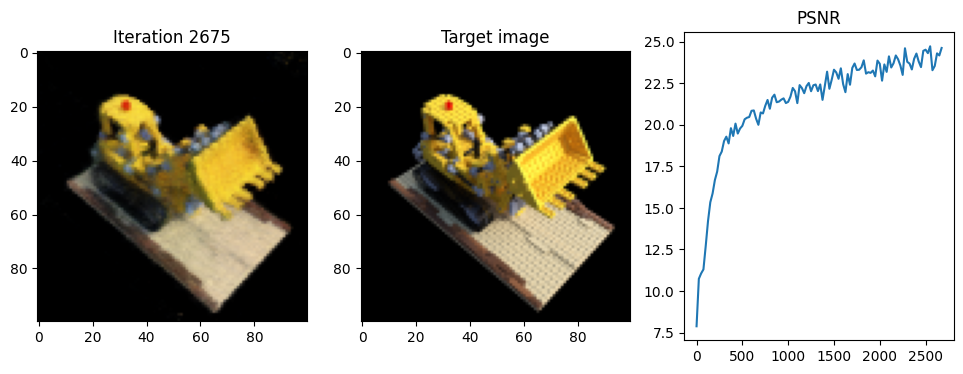

tensor([[-0.3178,  0.4101,  0.6196],
        [-0.2976,  0.4072,  0.6137],
        [-0.2775,  0.4042,  0.6079],
        ...,
        [-0.3265, -0.5264, -0.7393],
        [-0.3197, -0.5376, -0.7560],
        [-0.3130, -0.5487, -0.7727]], device='cuda:0')
tensor([[ 0.9510, -0.1400, -0.2757],
        [ 0.9510, -0.1400, -0.2757],
        [ 0.9510, -0.1400, -0.2757],
        ...,
        [ 0.3195, -0.5261, -0.7881],
        [ 0.3195, -0.5261, -0.7881],
        [ 0.3195, -0.5261, -0.7881]], device='cuda:0')
tensor([[-0.0081,  0.2179,  0.7781],
        [ 0.0054,  0.2226,  0.7625],
        [ 0.0188,  0.2274,  0.7469],
        ...,
        [-0.5417, -0.5406, -0.5871],
        [-0.5429, -0.5472, -0.6072],
        [-0.5441, -0.5537, -0.6272]], device='cuda:0')
tensor([[ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        [ 0.6362,  0.2249, -0.7381],
        ...,
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488],
        [-0.0559, -0.3108, -0.9488]], devic

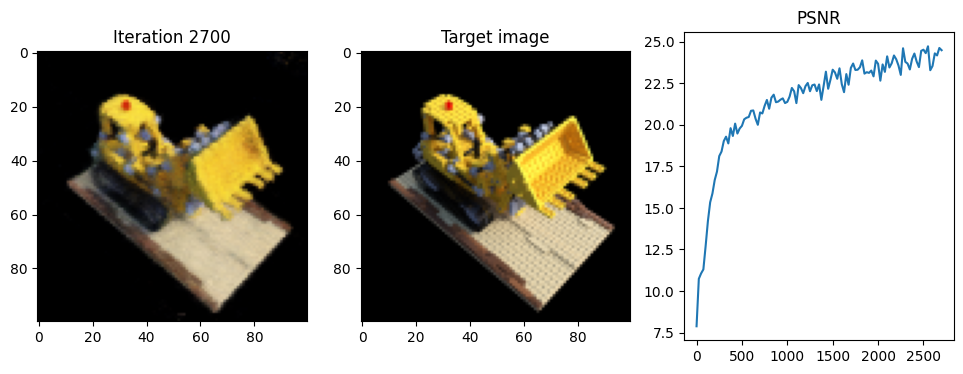

tensor([[-0.7369,  0.0438,  0.3288],
        [-0.7193,  0.0550,  0.3325],
        [-0.7018,  0.0662,  0.3363],
        ...,
        [ 0.4415, -0.5299, -0.6743],
        [ 0.4602, -0.5323, -0.6839],
        [ 0.4789, -0.5347, -0.6935]], device='cuda:0')
tensor([[ 0.8303,  0.5284,  0.1772],
        [ 0.8303,  0.5284,  0.1772],
        [ 0.8303,  0.5284,  0.1772],
        ...,
        [ 0.8848, -0.1130, -0.4520],
        [ 0.8848, -0.1130, -0.4520],
        [ 0.8848, -0.1130, -0.4520]], device='cuda:0')
tensor([[ 0.5682,  0.2852,  0.4988],
        [ 0.5594,  0.2661,  0.4974],
        [ 0.5505,  0.2469,  0.4959],
        ...,
        [-0.5320,  0.3377, -0.7303],
        [-0.5470,  0.3318, -0.7440],
        [-0.5619,  0.3258, -0.7578]], device='cuda:0')
tensor([[-0.4205, -0.9048, -0.0671],
        [-0.4205, -0.9048, -0.0671],
        [-0.4205, -0.9048, -0.0671],
        ...,
        [-0.7053, -0.2815, -0.6507],
        [-0.7053, -0.2815, -0.6507],
        [-0.7053, -0.2815, -0.6507]], devic

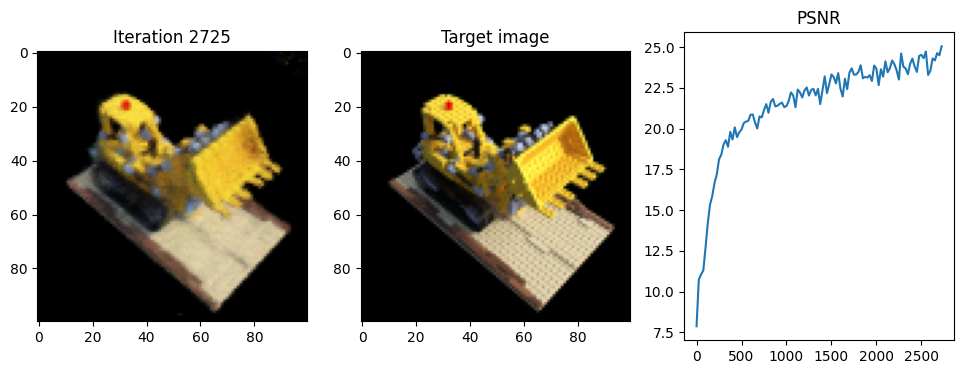

tensor([[ 0.1917,  0.1007,  0.7786],
        [ 0.2021,  0.0912,  0.7628],
        [ 0.2126,  0.0817,  0.7471],
        ...,
        [-0.7331,  0.2328, -0.5820],
        [-0.7395,  0.2310, -0.6021],
        [-0.7460,  0.2292, -0.6222]], device='cuda:0')
tensor([[ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        [ 0.4932, -0.4498, -0.7446],
        ...,
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487],
        [-0.3043, -0.0857, -0.9487]], device='cuda:0')
tensor([[ 0.1921, -0.0949,  0.7792],
        [ 0.1937, -0.1081,  0.7628],
        [ 0.1953, -0.1214,  0.7464],
        ...,
        [-0.3711,  0.6956, -0.5556],
        [-0.3766,  0.6997, -0.5757],
        [-0.3822,  0.7037, -0.5957]], device='cuda:0')
tensor([[ 0.0773, -0.6259, -0.7760],
        [ 0.0773, -0.6259, -0.7760],
        [ 0.0773, -0.6259, -0.7760],
        ...,
        [-0.2613,  0.1906, -0.9463],
        [-0.2613,  0.1906, -0.9463],
        [-0.2613,  0.1906, -0.9463]], devic

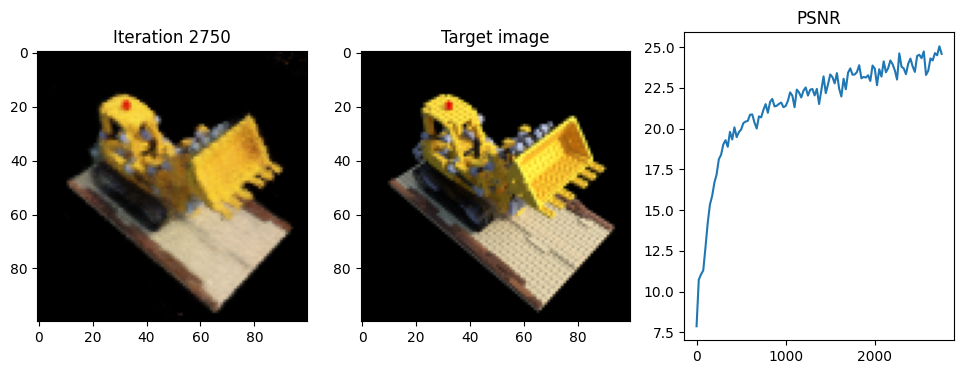

tensor([[ 0.5742,  0.2478,  0.5118],
        [ 0.5643,  0.2292,  0.5100],
        [ 0.5545,  0.2106,  0.5081],
        ...,
        [-0.5022,  0.3758, -0.7328],
        [-0.5172,  0.3708, -0.7469],
        [-0.5322,  0.3659, -0.7609]], device='cuda:0')
tensor([[-0.4654, -0.8807, -0.0878],
        [-0.4654, -0.8807, -0.0878],
        [-0.4654, -0.8807, -0.0878],
        ...,
        [-0.7084, -0.2347, -0.6657],
        [-0.7084, -0.2347, -0.6657],
        [-0.7084, -0.2347, -0.6657]], device='cuda:0')
tensor([[-0.1726,  0.6780,  0.4044],
        [-0.1563,  0.6647,  0.4060],
        [-0.1399,  0.6514,  0.4075],
        ...,
        [-0.4013, -0.5234, -0.7039],
        [-0.3982, -0.5409, -0.7153],
        [-0.3950, -0.5584, -0.7268]], device='cuda:0')
tensor([[ 0.7735, -0.6295,  0.0739],
        [ 0.7735, -0.6295,  0.0739],
        [ 0.7735, -0.6295,  0.0739],
        ...,
        [ 0.1467, -0.8282, -0.5409],
        [ 0.1467, -0.8282, -0.5409],
        [ 0.1467, -0.8282, -0.5409]], devic

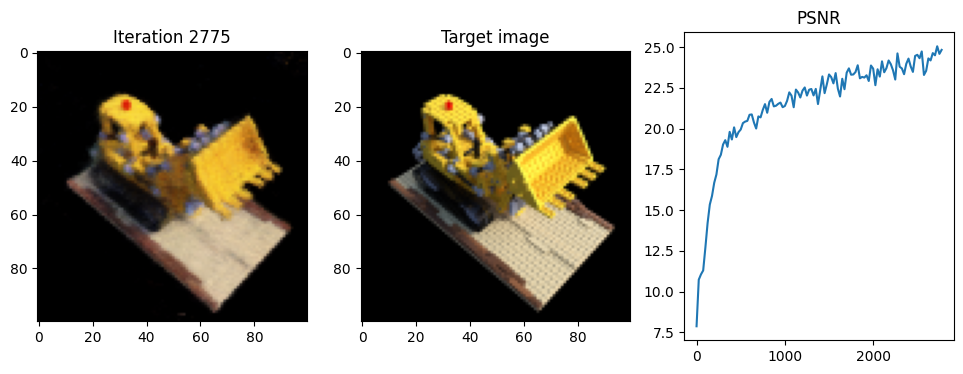

tensor([[ 0.2204,  0.1682,  0.7591],
        [ 0.2266,  0.1529,  0.7459],
        [ 0.2329,  0.1376,  0.7327],
        ...,
        [-0.6048,  0.3653, -0.6566],
        [-0.6116,  0.3623, -0.6764],
        [-0.6184,  0.3592, -0.6962]], device='cuda:0')
tensor([[ 0.2940, -0.7243, -0.6237],
        [ 0.2940, -0.7243, -0.6237],
        [ 0.2940, -0.7243, -0.6237],
        ...,
        [-0.3214, -0.1461, -0.9356],
        [-0.3214, -0.1461, -0.9356],
        [-0.3214, -0.1461, -0.9356]], device='cuda:0')
tensor([[ 0.5742,  0.2478,  0.5118],
        [ 0.5643,  0.2292,  0.5100],
        [ 0.5545,  0.2106,  0.5081],
        ...,
        [-0.5022,  0.3758, -0.7328],
        [-0.5172,  0.3708, -0.7469],
        [-0.5322,  0.3659, -0.7609]], device='cuda:0')
tensor([[-0.4654, -0.8807, -0.0878],
        [-0.4654, -0.8807, -0.0878],
        [-0.4654, -0.8807, -0.0878],
        ...,
        [-0.7084, -0.2347, -0.6657],
        [-0.7084, -0.2347, -0.6657],
        [-0.7084, -0.2347, -0.6657]], devic

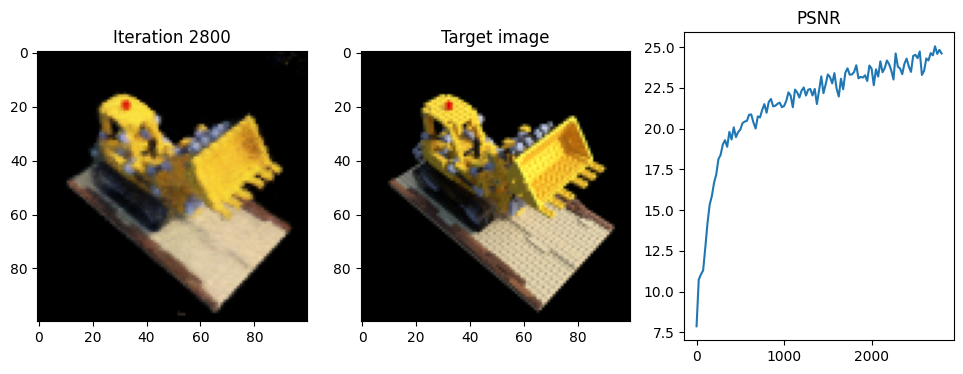

tensor([[-0.2905, -0.0283,  0.7536],
        [-0.2865, -0.0119,  0.7408],
        [-0.2825,  0.0046,  0.7281],
        ...,
        [ 0.2959, -0.6315, -0.6663],
        [ 0.3036, -0.6324, -0.6860],
        [ 0.3113, -0.6334, -0.7057]], device='cuda:0')
tensor([[ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        ...,
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306]], device='cuda:0')
tensor([[-0.6953, -0.1746,  0.3729],
        [-0.6819, -0.1584,  0.3754],
        [-0.6685, -0.1422,  0.3779],
        ...,
        [ 0.5467, -0.3901, -0.6924],
        [ 0.5647, -0.3869, -0.7031],
        [ 0.5827, -0.3837, -0.7137]], device='cuda:0')
tensor([[ 0.6342,  0.7641,  0.1178],
        [ 0.6342,  0.7641,  0.1178],
        [ 0.6342,  0.7641,  0.1178],
        ...,
        [ 0.8505,  0.1503, -0.5040],
        [ 0.8505,  0.1503, -0.5040],
        [ 0.8505,  0.1503, -0.5040]], devic

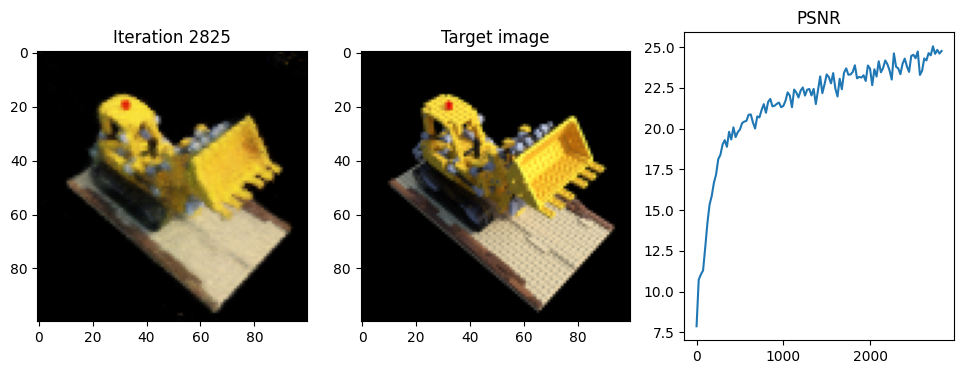

tensor([[-0.0677, -0.2645,  0.7606],
        [-0.0822, -0.2567,  0.7473],
        [-0.0966, -0.2489,  0.7339],
        ...,
        [ 0.7028,  0.0968, -0.6535],
        [ 0.7062,  0.1034, -0.6733],
        [ 0.7096,  0.1099, -0.6932]], device='cuda:0')
tensor([[-0.6834,  0.3687, -0.6300],
        [-0.6834,  0.3687, -0.6300],
        [-0.6834,  0.3687, -0.6300],
        ...,
        [ 0.1607,  0.3102, -0.9370],
        [ 0.1607,  0.3102, -0.9370],
        [ 0.1607,  0.3102, -0.9370]], device='cuda:0')
tensor([[-0.3453,  0.4308,  0.5901],
        [-0.3249,  0.4275,  0.5854],
        [-0.3045,  0.4242,  0.5808],
        ...,
        [-0.2931, -0.5441, -0.7406],
        [-0.2856, -0.5558, -0.7565],
        [-0.2781, -0.5674, -0.7725]], device='cuda:0')
tensor([[ 0.9625, -0.1574, -0.2209],
        [ 0.9625, -0.1574, -0.2209],
        [ 0.9625, -0.1574, -0.2209],
        ...,
        [ 0.3546, -0.5516, -0.7550],
        [ 0.3546, -0.5516, -0.7550],
        [ 0.3546, -0.5516, -0.7550]], devic

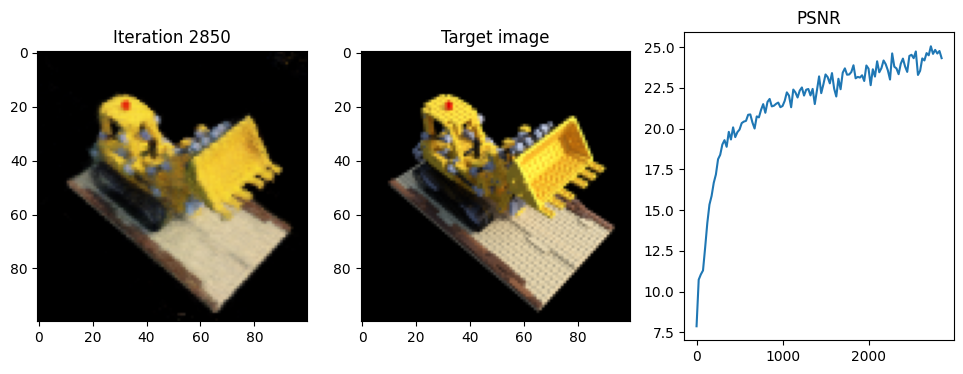

tensor([[-0.3453,  0.4308,  0.5901],
        [-0.3249,  0.4275,  0.5854],
        [-0.3045,  0.4242,  0.5808],
        ...,
        [-0.2931, -0.5441, -0.7406],
        [-0.2856, -0.5558, -0.7565],
        [-0.2781, -0.5674, -0.7725]], device='cuda:0')
tensor([[ 0.9625, -0.1574, -0.2209],
        [ 0.9625, -0.1574, -0.2209],
        [ 0.9625, -0.1574, -0.2209],
        ...,
        [ 0.3546, -0.5516, -0.7550],
        [ 0.3546, -0.5516, -0.7550],
        [ 0.3546, -0.5516, -0.7550]], device='cuda:0')
tensor([[ 0.2550, -0.4967,  0.5842],
        [ 0.2357, -0.4892,  0.5798],
        [ 0.2164, -0.4818,  0.5753],
        ...,
        [ 0.3917,  0.4781, -0.7405],
        [ 0.3866,  0.4912, -0.7563],
        [ 0.3815,  0.5043, -0.7722]], device='cuda:0')
tensor([[-0.9119,  0.3525, -0.2103],
        [-0.9119,  0.3525, -0.2103],
        [-0.9119,  0.3525, -0.2103],
        ...,
        [-0.2409,  0.6180, -0.7483],
        [-0.2409,  0.6180, -0.7483],
        [-0.2409,  0.6180, -0.7483]], devic

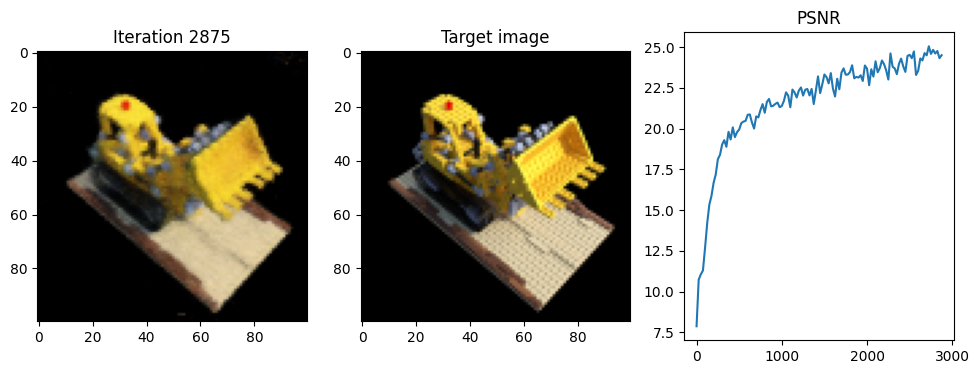

tensor([[-0.0073, -0.2157,  0.7788],
        [-0.0177, -0.2236,  0.7621],
        [-0.0281, -0.2314,  0.7454],
        ...,
        [ 0.4396,  0.6640, -0.5442],
        [ 0.4409,  0.6709, -0.5642],
        [ 0.4422,  0.6777, -0.5841]], device='cuda:0')
tensor([[-0.4911, -0.3705, -0.7884],
        [-0.4911, -0.3705, -0.7884],
        [-0.4911, -0.3705, -0.7884],
        ...,
        [ 0.0610,  0.3232, -0.9444],
        [ 0.0610,  0.3232, -0.9444],
        [ 0.0610,  0.3232, -0.9444]], device='cuda:0')
tensor([[-0.6654,  0.3115,  0.3365],
        [-0.6449,  0.3155,  0.3400],
        [-0.6244,  0.3194,  0.3436],
        ...,
        [ 0.2080, -0.6541, -0.6776],
        [ 0.2245, -0.6632, -0.6874],
        [ 0.2409, -0.6723, -0.6972]], device='cuda:0')
tensor([[ 0.9684,  0.1853,  0.1670],
        [ 0.9684,  0.1853,  0.1670],
        [ 0.9684,  0.1853,  0.1670],
        ...,
        [ 0.7761, -0.4301, -0.4611],
        [ 0.7761, -0.4301, -0.4611],
        [ 0.7761, -0.4301, -0.4611]], devic

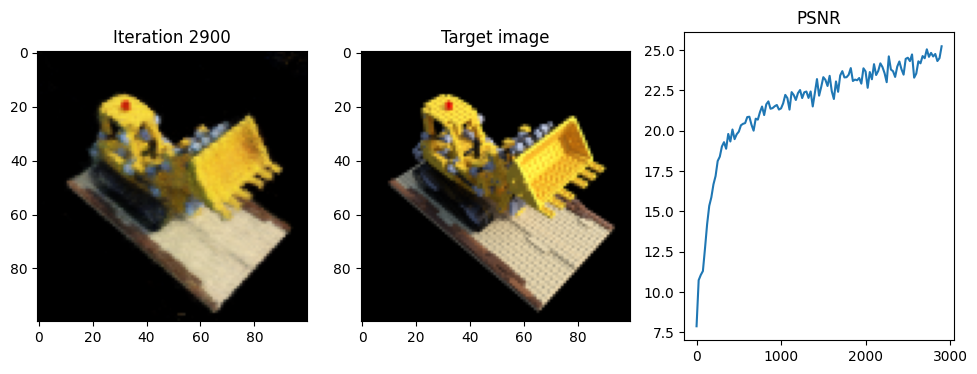

tensor([[ 0.0630,  0.7312,  0.3383],
        [ 0.0738,  0.7133,  0.3418],
        [ 0.0845,  0.6954,  0.3452],
        ...,
        [-0.5426, -0.4193, -0.6784],
        [-0.5454, -0.4378, -0.6882],
        [-0.5483, -0.4563, -0.6980]], device='cuda:0')
tensor([[ 0.5081, -0.8454,  0.1646],
        [ 0.5081, -0.8454,  0.1646],
        [ 0.5081, -0.8454,  0.1646],
        ...,
        [-0.1362, -0.8757, -0.4632],
        [-0.1362, -0.8757, -0.4632],
        [-0.1362, -0.8757, -0.4632]], device='cuda:0')
tensor([[ 0.1533,  0.4471,  0.6555],
        [ 0.1626,  0.4296,  0.6481],
        [ 0.1720,  0.4121,  0.6408],
        ...,
        [-0.6261,  0.0147, -0.7336],
        [-0.6314,  0.0041, -0.7511],
        [-0.6366, -0.0065, -0.7686]], device='cuda:0')
tensor([[ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        [ 0.4402, -0.8280, -0.3475],
        ...,
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279],
        [-0.2482, -0.5029, -0.8279]], devic

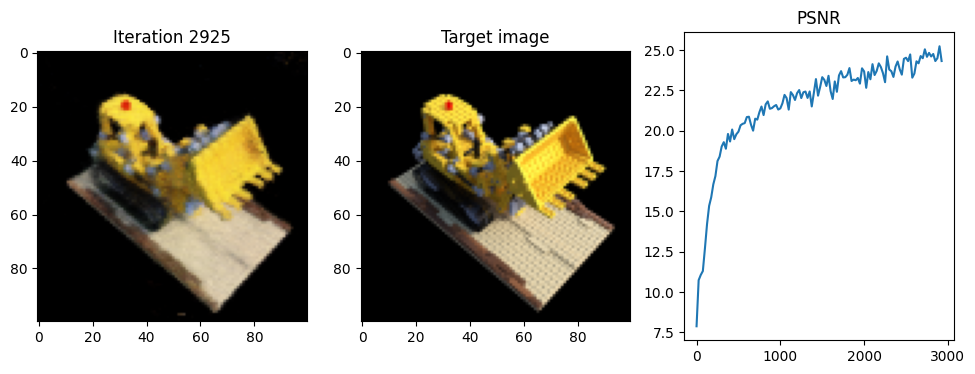

tensor([[ 0.1789,  0.1363,  0.7762],
        [ 0.1911,  0.1360,  0.7589],
        [ 0.2034,  0.1358,  0.7417],
        ...,
        [-0.7880, -0.2052, -0.5170],
        [-0.7943, -0.2090, -0.5369],
        [-0.8006, -0.2128, -0.5567]], device='cuda:0')
tensor([[ 0.5795, -0.0118, -0.8149],
        [ 0.5795, -0.0118, -0.8149],
        [ 0.5795, -0.0118, -0.8149],
        ...,
        [-0.2965, -0.1785, -0.9382],
        [-0.2965, -0.1785, -0.9382],
        [-0.2965, -0.1785, -0.9382]], device='cuda:0')
tensor([[ 0.0786, -0.2004,  0.7789],
        [ 0.0719, -0.2116,  0.7623],
        [ 0.0651, -0.2228,  0.7457],
        ...,
        [ 0.1555,  0.7788, -0.5475],
        [ 0.1540,  0.7855, -0.5675],
        [ 0.1525,  0.7923, -0.5875]], device='cuda:0')
tensor([[-0.3210, -0.5300, -0.7849],
        [-0.3210, -0.5300, -0.7849],
        [-0.3210, -0.5300, -0.7849],
        ...,
        [-0.0701,  0.3196, -0.9450],
        [-0.0701,  0.3196, -0.9450],
        [-0.0701,  0.3196, -0.9450]], devic

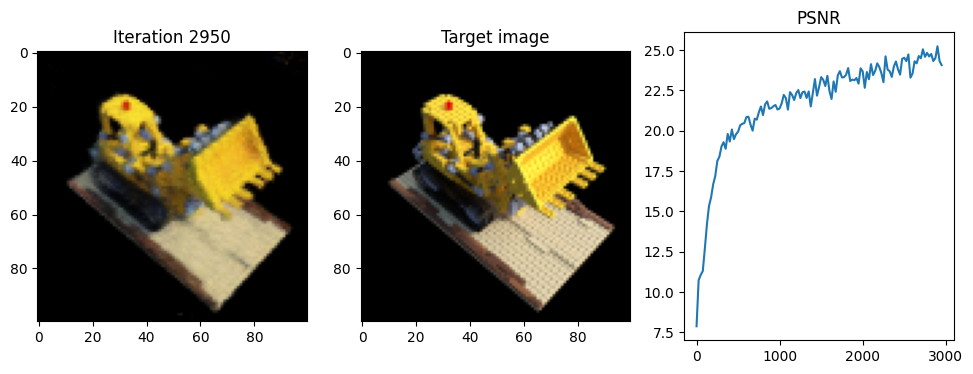

tensor([[-0.3644,  0.2603,  0.6727],
        [-0.3454,  0.2648,  0.6645],
        [-0.3264,  0.2693,  0.6564],
        ...,
        [-0.2068, -0.5973, -0.7286],
        [-0.1986, -0.6050, -0.7465],
        [-0.1904, -0.6128, -0.7645]], device='cuda:0')
tensor([[ 0.8983,  0.2130, -0.3844],
        [ 0.8983,  0.2130, -0.3844],
        [ 0.8983,  0.2130, -0.3844],
        ...,
        [ 0.3866, -0.3655, -0.8468],
        [ 0.3866, -0.3655, -0.8468],
        [ 0.3866, -0.3655, -0.8468]], device='cuda:0')
tensor([[ 0.0350,  0.2122,  0.7790],
        [ 0.0485,  0.2156,  0.7630],
        [ 0.0620,  0.2190,  0.7471],
        ...,
        [-0.6117, -0.4746, -0.5753],
        [-0.6141, -0.4808, -0.5954],
        [-0.6165, -0.4871, -0.6154]], device='cuda:0')
tensor([[ 0.6384,  0.1594, -0.7531],
        [ 0.6384,  0.1594, -0.7531],
        [ 0.6384,  0.1594, -0.7531],
        ...,
        [-0.1128, -0.2965, -0.9483],
        [-0.1128, -0.2965, -0.9483],
        [-0.1128, -0.2965, -0.9483]], devic

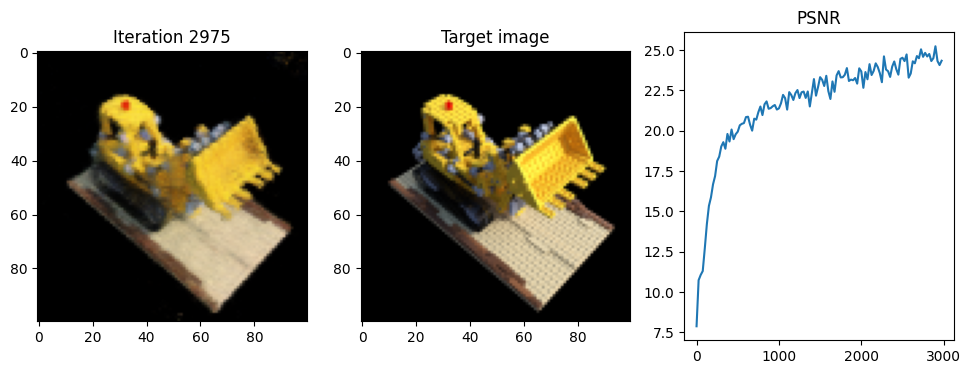

tensor([[-0.4533,  0.4589,  0.4868],
        [-0.4324,  0.4562,  0.4858],
        [-0.4114,  0.4536,  0.4847],
        ...,
        [-0.1469, -0.6159, -0.7277],
        [-0.1364, -0.6284, -0.7411],
        [-0.1260, -0.6409, -0.7546]], device='cuda:0')
tensor([[ 0.9909, -0.1259, -0.0483],
        [ 0.9909, -0.1259, -0.0483],
        [ 0.9909, -0.1259, -0.0483],
        ...,
        [ 0.4941, -0.5919, -0.6368],
        [ 0.4941, -0.5919, -0.6368],
        [ 0.4941, -0.5919, -0.6368]], device='cuda:0')
tensor([[-0.2905, -0.0283,  0.7536],
        [-0.2865, -0.0119,  0.7408],
        [-0.2825,  0.0046,  0.7281],
        ...,
        [ 0.2959, -0.6315, -0.6663],
        [ 0.3036, -0.6324, -0.6860],
        [ 0.3113, -0.6334, -0.7057]], device='cuda:0')
tensor([[ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        [ 0.1874,  0.7757, -0.6026],
        ...,
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306],
        [ 0.3634, -0.0438, -0.9306]], devic

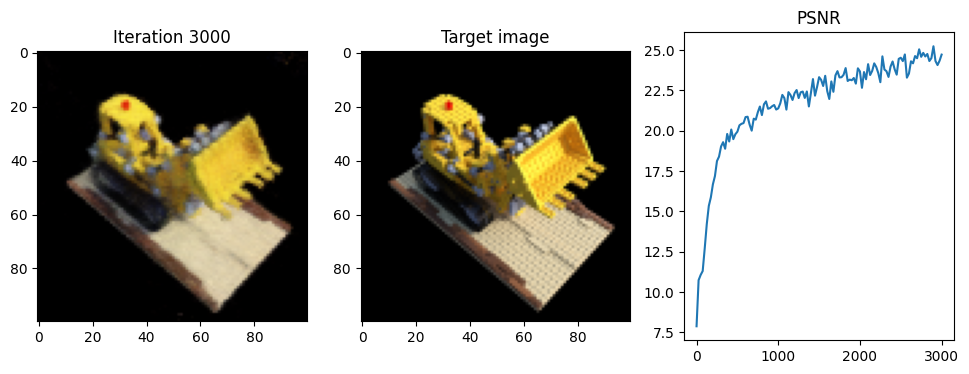

Done!


In [24]:
for i in range(iterations+1):

    #############################  TODO 2.6 BEGIN  ############################

    #choose randomly a picture for the forward pass
    rand_index = torch.randint(0, images.shape[0], (1,), device=device).item()
    image, pose = images[rand_index].to(device), poses[rand_index].to(device)

    # Run one iteration of NeRF and get the rendered RGB image.
    rec_image = one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies).to(device)

    # Compute mean-squared error between the predicted and target images. Backprop!
    optimizer.zero_grad()
    loss = F.mse_loss(rec_image, image)
    loss.backward()
    optimizer.step()


    #############################  TODO 2.6 END  ############################

    # Display images/plots/stats
    if i % display == 0:
        with torch.no_grad():
        #############################  TODO 2.6 BEGIN  ############################
            # Render the held-out view
            test_rec_image = one_forward_pass(height, width, intrinsics, test_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies).to(device)
            test_rec_image_loss = F.mse_loss(test_rec_image, test_image)
            psnr = 10 * torch.log10((1.0 / test_rec_image_loss).clone().detach())


        #calculate the loss and the psnr between the original test image and the reconstructed one.


        #############################  TODO 2.6 END  ############################

        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))

        t = time.time()
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

plt.imsave('test_lego.png',test_rec_image.detach().cpu().numpy())
torch.save(model.state_dict(),'model_nerf.pt')
print('Done!')